In [2]:
# Install some Libraries
# Files
import os
import git
repo = git.Repo('.', search_parent_directories=True)
os.chdir(repo.working_tree_dir)
# Core Libraries
import numpy as np
from roboflow import Roboflow
import ultralytics
import torch
# Visualization
import cv2
import supervision as sv
from PIL import Image
from IPython.display import display, Markdown

# Strawberry Detection Through Deep Learning

HS 495 Project 3

Jerry H. Yu

## Introduction

Computer Vision (CV) tools are receiving increasing attention in agricultural fields after demonstrating their ability to increase throughput and cost effectiveness over traditional phenotyping methods $^{1}$. Computer vision, a subfield of Artificial Intelligence (AI), focuses on deriving meaningful information from visual data like images and videos $^{2,3}$. One application of CV to agricultural use is fruit detection, where a model learns to find and count ripe fruit like strawberries from video or photos of plants in the field $^{4}$. These methods can accelerate plant breeding by automating the process of counting strawberries to assess plant productivity, or guide robots to pick ripe strawberries $^{4}$.   

However, applying CV techniques in agricultural settings present unique challenges. Two common hurdles are the limited availability of labeled training data and the computational demands of running large models on less powerful devices in the field $^{3}$. For fruit detection, these challenges are particularly acute, requiring sufficient labeled images of strawberries at varying ripeness levels, under diverse lighting conditions, and accounting for natural occlusion from leaves and stems $^{5,6}$. 

The state-of-the-art (SOTA) in computer vision currently relies on two primary classes of deep learning algorithms: Convolutional Neural Networks (CNNs) and Visual Transformers. CNNs, like the popular YOLO, ResNet, and MobileNet families, extract relevant features through a series of convolutions like blurring $^{7,8}$. Throughout the 2010s, CNNs were the dominant approach, and they remain widely used when speed and model size are critical. More recently, Visual Transformers have emerged, processing images by dividing them into tokens and embedding them as vectors, allowing them to leverage transformer-based architectures and incorporate broader contextual information, often at the cost of increasing run (inference) time and model size $^{9,10}$. Models of this type include Vision Transformers (ViT) from Google, Florence2 from Microsoft, and Qwen2.5-VL from Alibaba $^{9}$. 

In this class, we were tasked with training a deep learning model to detect ripe strawberries. Previous research has demonstrated the effectiveness of YOLO models in strawberry detection, achieving high accuracies, recall, and F1 scores $^{5,6}$. However, these studies often predate the release of newer YOLO architectures and are trained on much larger labeled datasets. Therefore, this project will evaluate and compare the performance of recent YOLO models (YOLOv11 and YOLOe) alongside a transformer-based Qwen model on a very small dataset $^{9–11}$. Our primary goals are to assess the models’ performance with limited training data, computational cost, and speed, providing insights into the most efficient and effective approach for automated strawberry phenotyping. 

## Image Preprocessing and Augmentation

### Preprocessing

- For labeling, me, Shailesh Raj Acharya, and Steve Ameridge collaborated on labeling images. 
- The original data set (V1) contained 63 images. 
- Later, I added 8 additional images. These were mostly null images, or images without any ripe strawberries to try to obtain a better precision. That is, I tried to add images with no ripe strawberries to make the model less likely to identify something that was not a raw strawberry as a raw strawberry. This version is called V4. 
- Data was split with a standard 70-20-10 approach, with 70% of images assigned to training, 20% to validation, and 10% to testing. 
- Images for training were duplicated three times, resulting in three versions of the same image. 
- An example of the types of images used in the dataset are below. 

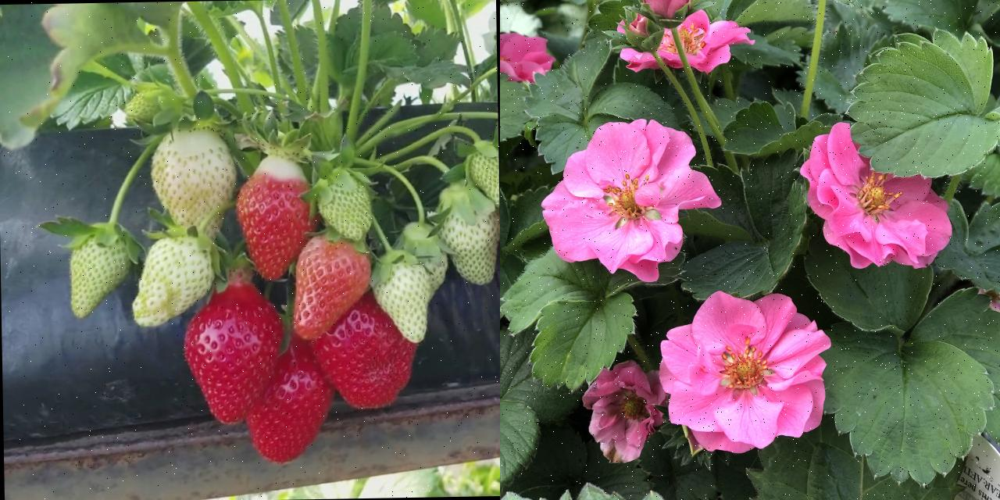

**Figure 1.** Left: An example of an image from the original dataset. Right: An example of a null image I added. Notice the color of the flowers to train the model to account for features other than color.

In [15]:
# Load images
img1 = Image.open(os.path.join(repo.working_tree_dir, "Data/Project3---Strawberry-1/train/images/39_crop1_png.rf.9ed6f32f0000a8290b62ea41e167cfff.jpg"))
img2 = Image.open(os.path.join(repo.working_tree_dir, "Data/Project3---Strawberry-4/train/images/Fragaria_berried_treasure_pink_everbearing_strawberry_gc_FRABP_03_jpg.rf.e2b63a188d49dfdb3b564a6ddf3bdc73.jpg")
)

# # Resize (optional)
# img1 = img1.resize((300, 300))
# img2 = img2.resize((300, 300))

# Combine side by side
combined = Image.new("RGB", (img1.width + img2.width, max(img1.height, img2.height)))
combined.paste(img1, (0, 0))
combined.paste(img2, (img1.width, 0))

# Display image
display(combined)

# Add caption
display(Markdown("**Figure 1.** Left: An example of an image from the original dataset. Right: An example of a null image I added. Notice the color of the flowers to train the model to account for features other than color."))

### Augmentation

- Originally, I randomly chose a combination of image augmentations I thought would be beneficial, tending to the high range of what roboflow recommended. This is in addition to the automatic augmentations applied by the `train` function from Ultralytics. 
- For all models, I added noise of up to 1.05% of pixels. 
- in later versions, I left the images unaugmented for roboflow with the exception of noise, relying on the automatic augmentations only and tuning augmentation parameters alongside other hyperparameters.
- Table 1 describes all augmentations applied across models that were fine tuned. 

| Row Name | Yolo11 Finetuned Default | Yolo11 Finetuned Best of 10 | Yolo11 Finetuned Best of 274 |
|---|---|---|---|
| degrees rotated | 0.0 + **29** | 0.0 | 0.0 |
| hsv_h (hue) | **0.015** | **0.01458** | **0.01287** |
| hsv_s (saturation) | **0.7** +  **0.21** | **0.09784** | **0.09813** |
| hsv_v (value) | **0.4** | 0.1 | 0.1 |
| translate | 0.1 | 0.1 | **0.06559** |
| scale | 0.5 | 0.5 | 0.5 |
| shear | 0.0 | 0.0 | 0.0 |
| perspective | 0.0 | 0.0 | 0.0 |
| flipud | 0.0 | 0.0 | 0.0 |
| fliplr | 0.5 | 0.5 | 0.5 |
| bgr | 0.0 | 0.0 | 0.0 |
| mosaic | 1.0 | 1.0 | 1.0 |
| mixup | 0.0 | 0.0 | 0.0 |
| copy_paste | 0.0 | 0.0 | 0.0 |
| copy_paste_mode | flip | flip | flip |
| auto_augment | randaugment | randaugment | randaugment |
| erasing | 0.4 | 0.4 | 0.4 |
| crop_fraction | 1.0 | 1.0 | 1.0 |

**Table 1:** All Augmentation settings for models that were fine tuned. Bold indicates differences between models, while the `+` sign indicates augmentations from roboflow, which were only applied in the first model. For further information on augmentation hyperparameters please refer to the [Roboflow docs here](https://docs.ultralytics.com/modes/train/#augmentation-settings-and-hyperparameters) $^{12}$. 

### Model Selection

I chose three models for my analysis. A description for each model is given below: 

* `YOLOv11` is the latest CNN-based model from Ultralytics, optimized for both speed and accuracy in object detection tasks¹¹. Compared to the YOLO versions shown in class, `YOLO11` employs a series of architectural tweaks that make parts of the model more efficient by requiring fewer parameters, enabling faster inference without significantly affecting performance¹³.
        
    - I chose the large version to increase the model's base performance. All YOLO models are relatively easy to train with my hardware, so picking the one with the best results was preferable¹¹,¹².

* `YOLOE` builds on `YOLO11` by incorporating two sub-networks that allow `YOLOE` to detect objects from custom descriptions without additional training¹⁰. These components are as follows:
            
    * SAVPE (Semantic-Activated Visual Prompt Encoder) enhances visual salience by linking image regions to semantic features from text prompts¹⁴.
            
    * RepRTA (Re-parameterizable Region-Text Alignment) transforms text descriptions (e.g., “red ripe strawberry”) into high-dimensional embeddings, aligned with CLIP-like vectors, enabling the model to detect custom or unseen objects without retraining¹⁴.

* `Qwen-2.5 VL 3b Instruct` is a multimodal vision language model that combines a customized Vision Transformer (ViT) with the QWen 2.5 LLM⁹. Qwen's ViT uses enhanced positional embeddings and multimodal fusion layers to align image features with text queries. It's pre-trained on large image-text datasets and then on vision-language tasks such as region detection¹⁴.
   
    - As it is an MLLM, this model is much larger than the other two¹⁰,¹¹,¹⁵.

    

I feel that these models give us a good overview of different SOTA CV approaches, representing the trade-off between contextual understanding and processing speed.

# Results

In [3]:
# Checking GPU
!nvidia-smi
# Check torch version and compatability
print(torch.version.cuda)
print(torch.cuda.is_available())
print("CUDA device count:", torch.cuda.device_count())

Sat Apr 26 15:39:24 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 572.61                 Driver Version: 572.61         CUDA Version: 12.8     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3090      WDDM  |   00000000:01:00.0  On |                  N/A |
| 57%   51C    P2            127W /  370W |    5239MiB /  24576MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

## Test Yolo11 Pretrained

Note: We used an image of a cat with mangosteens to demo each model's abilities without any training (zero shot). 

In [8]:
from ultralytics import YOLO
# checks if ultralytics is up to date and if the GPU is available
ultralytics.checks()

Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
Setup complete  (32 CPUs, 95.7 GB RAM, 994.4/1862.2 GB disk)


In [9]:
# Load Pretrained YOLO11
yolo11 = YOLO(os.path.join(repo.working_tree_dir,"Models/pretrain/yolo11l.pt")) 
pic = Image.open(os.path.join(repo.working_tree_dir,"Data/mangosteencat.jpeg"))
result = yolo11.predict(pic,conf=0.25)[0]
detections = sv.Detections.from_ultralytics(result)


0: 640x640 1 cat, 1 cup, 1 bowl, 1 apple, 10.9ms
Speed: 9.9ms preprocess, 10.9ms inference, 128.8ms postprocess per image at shape (1, 3, 640, 640)


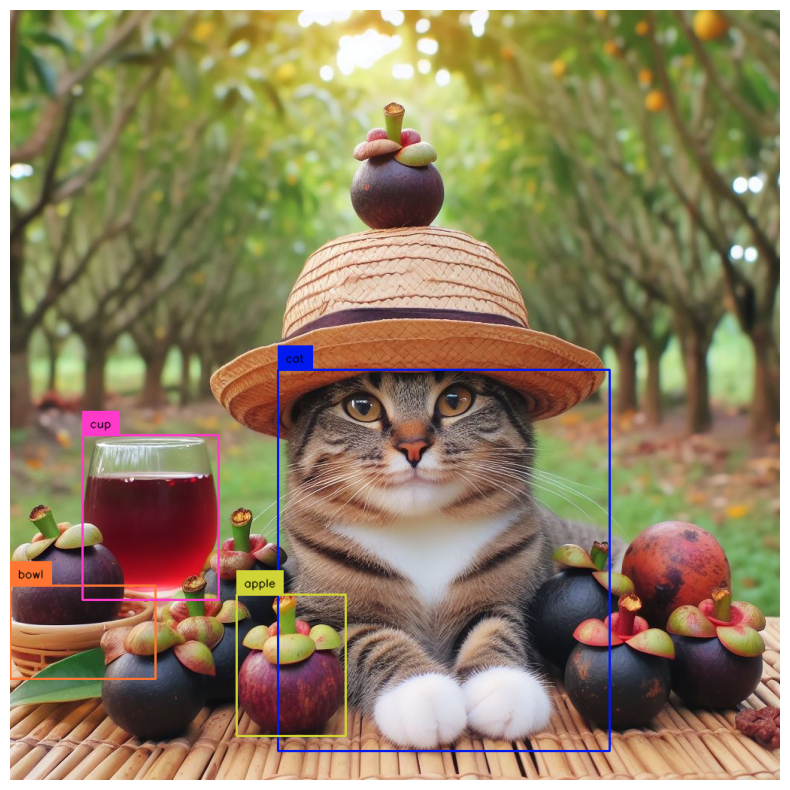

In [10]:
box_annotator = sv.BoxAnnotator()
label_annotator = sv.LabelAnnotator(text_color=sv.Color.BLACK)

annotated_image = pic.copy()
annotated_image = box_annotator.annotate(annotated_image, detections=detections)
annotated_image = label_annotator.annotate(annotated_image, detections=detections)

sv.plot_image(annotated_image, size=(10, 10))

- You can see that `YOLO11` is able to detect quite a few objects and correctly.
- However, the model's vocabulary is limited, resulting in it identifying mangosteens as apples. 

In [11]:
# Now Test on Strawberries
pic = Image.open(os.path.join(repo.working_tree_dir,"Data/Project3---Strawberry-1/test/images/27_crop2_png.rf.89569ab2704bf6aa15acab6150fe12b8.jpg"))
result = yolo11.predict(pic,conf=0.25)[0]
detections = sv.Detections.from_ultralytics(result)


0: 640x640 1 apple, 12.5ms
Speed: 1.7ms preprocess, 12.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


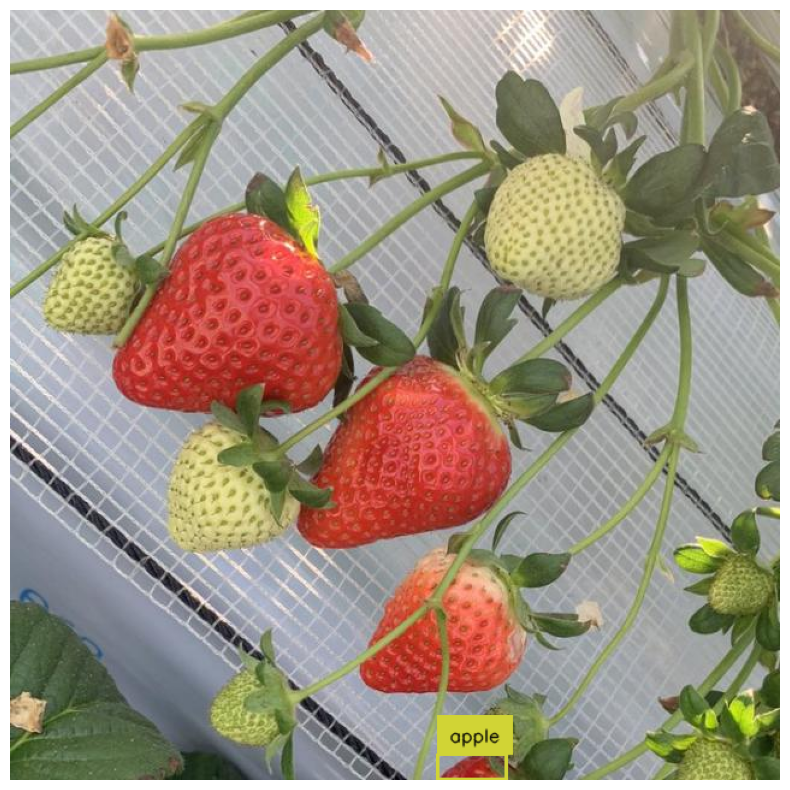

In [12]:
box_annotator = sv.BoxAnnotator()
label_annotator = sv.LabelAnnotator(text_color=sv.Color.BLACK)

annotated_image = pic.copy()
annotated_image = box_annotator.annotate(annotated_image, detections=detections)
annotated_image = label_annotator.annotate(annotated_image, detections=detections)

sv.plot_image(annotated_image, size=(10, 10))

- very inaccurate, seems think that all fruits are apples.

# Start Finetune

- Now that we've seen `YOLO11` zero shot effectivness on our data, let's fine tune it. 

In [ ]:
# Import Roboflow Project Version 1
os.chdir(repo.working_tree_dir + "\\Data")
rf = Roboflow(api_key ="api")
rf.workspace().project("project3-strawberry").version(1).download("yolov11")

loading Roboflow workspace...
loading Roboflow project...


In [39]:
# Train the model under default settings
os.chdir(repo.working_tree_dir)
v1yolo11 = yolo11.train(data=os.path.join(repo.working_tree_dir,"Data\\Project3---Strawberry-1\\data.yaml"), 
                        model = os.path.join(repo.working_tree_dir,"Models/pretrain/yolo11l.pt"),
                       epochs=100, imgsz=640,name="V1default",val=False)

New https://pypi.org/project/ultralytics/8.3.114 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
engine\trainer: task=detect, mode=train, model=c:\Users\Public\Documents\Class_Projects\Strobbery\Models/pretrain/yolo11l.pt, data=c:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-1\data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=V1default4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=False, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1

train: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-1\train\labels.cache... 135 images, 0 backgrounds, 0 corrupt: 100%|██████████| 135/135 [00:00<?, ?it/s]
val: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-1\valid\labels.cache... 12 images, 0 backgrounds, 0 corrupt: 100%|██████████| 12/12 [00:00<?, ?it/s]


Plotting labels to runs\detect\V1default4\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs\detect\V1default4
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      2.62G     0.3992     0.2617      0.831         75        640: 100%|██████████| 9/9 [00:01<00:00,  7.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.85G     0.3613     0.2519     0.8245         62        640: 100%|██████████| 9/9 [00:00<00:00, 10.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.99G     0.3831     0.2575     0.8256        100        640: 100%|██████████| 9/9 [00:00<00:00, 11.74it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.99G     0.3822     0.2628     0.8251         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.99G     0.3836      0.261     0.8364        135        640: 100%|██████████| 9/9 [00:00<00:00, 11.73it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100         3G     0.3998     0.2656     0.8306        110        640: 100%|██████████| 9/9 [00:01<00:00,  8.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100         3G     0.4083     0.2662     0.8291         96        640: 100%|██████████| 9/9 [00:00<00:00, 11.66it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         3G     0.4267     0.2742     0.8438         56        640: 100%|██████████| 9/9 [00:00<00:00, 12.34it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100         3G     0.4331     0.2751     0.8385        110        640: 100%|██████████| 9/9 [00:00<00:00, 12.15it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100         3G     0.4469     0.2832     0.8352         78        640: 100%|██████████| 9/9 [00:00<00:00, 12.86it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100         3G     0.4269     0.2779     0.8345        101        640: 100%|██████████| 9/9 [00:00<00:00, 12.90it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100         3G     0.4406     0.2868      0.838        129        640: 100%|██████████| 9/9 [00:00<00:00, 12.31it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100         3G     0.4368     0.2864     0.8312        129        640: 100%|██████████| 9/9 [00:00<00:00, 13.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100         3G     0.4443     0.2869     0.8413        128        640: 100%|██████████| 9/9 [00:00<00:00, 12.89it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100         3G     0.4518     0.2957      0.841        130        640: 100%|██████████| 9/9 [00:00<00:00, 13.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100         3G     0.4398     0.2815      0.834        107        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100         3G     0.4297     0.2833     0.8362        142        640: 100%|██████████| 9/9 [00:00<00:00, 13.37it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100         3G     0.4569     0.2898     0.8446        125        640: 100%|██████████| 9/9 [00:00<00:00, 12.80it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100         3G     0.4589     0.2894     0.8462         72        640: 100%|██████████| 9/9 [00:00<00:00, 13.08it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      3.14G     0.4489     0.2891      0.848         88        640: 100%|██████████| 9/9 [00:00<00:00, 12.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      3.14G     0.4803     0.2993     0.8598         73        640: 100%|██████████| 9/9 [00:00<00:00, 13.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      3.14G     0.4562     0.2878     0.8438        112        640: 100%|██████████| 9/9 [00:00<00:00, 13.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      3.14G     0.4593     0.2903      0.838        111        640: 100%|██████████| 9/9 [00:00<00:00, 13.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      3.14G     0.4464     0.2882     0.8461        101        640: 100%|██████████| 9/9 [00:00<00:00, 12.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      3.14G     0.4561     0.2892     0.8451         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.42it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      3.14G      0.452     0.2841     0.8433         94        640: 100%|██████████| 9/9 [00:00<00:00, 13.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      3.14G     0.4553     0.2857     0.8463         72        640: 100%|██████████| 9/9 [00:00<00:00, 13.13it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      3.14G     0.4772     0.3001     0.8404        116        640: 100%|██████████| 9/9 [00:00<00:00, 12.76it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      3.14G       0.49     0.3078     0.8556        123        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      3.14G     0.4989     0.3116     0.8523        115        640: 100%|██████████| 9/9 [00:00<00:00, 13.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      3.14G     0.4527     0.2876     0.8408         74        640: 100%|██████████| 9/9 [00:00<00:00, 12.47it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      3.14G     0.4681     0.3007     0.8434        139        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      3.14G     0.4675     0.2969     0.8467         98        640: 100%|██████████| 9/9 [00:00<00:00, 13.07it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      3.14G     0.4672     0.2939     0.8472         75        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      3.16G     0.4549     0.2927      0.846        113        640: 100%|██████████| 9/9 [00:00<00:00, 13.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      3.17G     0.4645      0.291     0.8328        120        640: 100%|██████████| 9/9 [00:00<00:00, 12.98it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      3.18G     0.4478     0.2909     0.8342         95        640: 100%|██████████| 9/9 [00:00<00:00, 13.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100       3.2G     0.4432     0.2816     0.8376         81        640: 100%|██████████| 9/9 [00:00<00:00, 12.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      3.21G      0.446     0.2858     0.8464        102        640: 100%|██████████| 9/9 [00:00<00:00, 13.61it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      3.23G     0.4505     0.2844     0.8456         94        640: 100%|██████████| 9/9 [00:00<00:00, 12.30it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      3.23G      0.451     0.2837      0.847        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.86it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      3.23G     0.4858     0.2909     0.8423        120        640: 100%|██████████| 9/9 [00:00<00:00, 12.80it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      3.23G     0.4824      0.298     0.8556         46        640: 100%|██████████| 9/9 [00:00<00:00, 13.15it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      3.23G     0.4748     0.2957     0.8473        146        640: 100%|██████████| 9/9 [00:00<00:00, 12.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      3.23G     0.4981     0.3054      0.863         38        640: 100%|██████████| 9/9 [00:00<00:00, 13.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      3.23G     0.4956     0.3027     0.8505         98        640: 100%|██████████| 9/9 [00:00<00:00, 13.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      3.23G     0.4876     0.2994     0.8593        114        640: 100%|██████████| 9/9 [00:00<00:00, 13.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      3.23G     0.4824     0.2888     0.8389         93        640: 100%|██████████| 9/9 [00:00<00:00, 12.43it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      3.23G     0.4585     0.2852     0.8418        137        640: 100%|██████████| 9/9 [00:00<00:00, 13.43it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      3.23G      0.454     0.2821     0.8413         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.71it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      3.23G     0.4698     0.2896     0.8508         91        640: 100%|██████████| 9/9 [00:00<00:00, 13.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      3.23G      0.429     0.2741      0.838         53        640: 100%|██████████| 9/9 [00:00<00:00, 13.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      3.23G     0.4289     0.2787     0.8428         43        640: 100%|██████████| 9/9 [00:00<00:00, 13.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      3.23G     0.4161      0.273     0.8374        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.92it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      3.23G     0.4123     0.2696     0.8362        145        640: 100%|██████████| 9/9 [00:00<00:00, 13.34it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      3.23G     0.4131     0.2693     0.8392         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.65it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      3.23G     0.4006     0.2684     0.8337         78        640: 100%|██████████| 9/9 [00:00<00:00, 13.34it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      3.23G     0.4089     0.2751     0.8304        140        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      3.23G     0.4092     0.2688     0.8325         86        640: 100%|██████████| 9/9 [00:00<00:00, 12.17it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      3.39G     0.4035     0.2681     0.8295        131        640: 100%|██████████| 9/9 [00:00<00:00, 12.84it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      3.39G     0.4028     0.2661     0.8346        102        640: 100%|██████████| 9/9 [00:00<00:00, 13.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      3.39G     0.3976     0.2628     0.8324         82        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      3.39G     0.4098     0.2749     0.8375         77        640: 100%|██████████| 9/9 [00:00<00:00, 13.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      3.39G     0.4037     0.2713     0.8279         88        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      3.39G     0.3937     0.2594     0.8318        141        640: 100%|██████████| 9/9 [00:00<00:00, 13.08it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      3.39G     0.3784     0.2517     0.8341         70        640: 100%|██████████| 9/9 [00:00<00:00, 13.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      3.39G     0.3985     0.2575     0.8244        100        640: 100%|██████████| 9/9 [00:00<00:00, 13.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      3.39G     0.4003     0.2685      0.835         90        640: 100%|██████████| 9/9 [00:00<00:00, 12.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      3.39G     0.4286     0.2727     0.8419         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.67it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      3.39G     0.3865     0.2585     0.8183        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      3.39G     0.4037     0.2693     0.8326        128        640: 100%|██████████| 9/9 [00:00<00:00, 12.74it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      3.39G     0.3902      0.262     0.8372        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.13it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      3.39G     0.4104     0.2681     0.8382        138        640: 100%|██████████| 9/9 [00:00<00:00, 12.77it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      3.39G     0.4451     0.2807      0.847         74        640: 100%|██████████| 9/9 [00:00<00:00, 12.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      3.39G      0.431      0.278     0.8402        133        640: 100%|██████████| 9/9 [00:00<00:00, 12.63it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      3.39G     0.4138     0.2726     0.8354         89        640: 100%|██████████| 9/9 [00:00<00:00, 12.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      3.39G     0.4432     0.2803     0.8508         97        640: 100%|██████████| 9/9 [00:00<00:00, 12.90it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      3.39G     0.4128     0.2652     0.8396         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.93it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      3.39G     0.4065     0.2625     0.8445         80        640: 100%|██████████| 9/9 [00:00<00:00, 13.65it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      3.39G     0.4087     0.2664     0.8442         98        640: 100%|██████████| 9/9 [00:00<00:00, 13.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      3.39G     0.4041     0.2638     0.8333         89        640: 100%|██████████| 9/9 [00:00<00:00, 13.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      3.39G     0.4043     0.2673     0.8413         76        640: 100%|██████████| 9/9 [00:00<00:00, 13.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      3.39G      0.387     0.2582     0.8273        130        640: 100%|██████████| 9/9 [00:00<00:00, 13.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      3.39G     0.4028     0.2593     0.8351         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      3.39G     0.4086     0.2668     0.8438         98        640: 100%|██████████| 9/9 [00:00<00:00, 13.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      3.39G     0.4294     0.2721     0.8539         72        640: 100%|██████████| 9/9 [00:00<00:00, 13.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      3.39G     0.3976     0.2639     0.8318        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.83it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      3.39G     0.3945     0.2577     0.8387        158        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      3.39G     0.3966      0.261     0.8292        163        640: 100%|██████████| 9/9 [00:00<00:00, 13.08it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      3.39G     0.4045     0.2679     0.8389        145        640: 100%|██████████| 9/9 [00:00<00:00, 12.92it/s]


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      3.39G     0.4004     0.2452     0.8193         37        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      3.39G     0.3863     0.2376     0.8169         39        640: 100%|██████████| 9/9 [00:00<00:00, 13.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      3.39G     0.3863     0.2403     0.8235         53        640: 100%|██████████| 9/9 [00:00<00:00, 13.54it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      3.39G     0.4426     0.2536     0.8706         79        640: 100%|██████████| 9/9 [00:00<00:00, 13.06it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      3.39G     0.3731     0.2265     0.8193         60        640: 100%|██████████| 9/9 [00:00<00:00, 13.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      3.39G     0.3813      0.237     0.8208         56        640: 100%|██████████| 9/9 [00:00<00:00, 12.96it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      3.39G     0.3974     0.2401     0.8442         55        640: 100%|██████████| 9/9 [00:00<00:00, 13.45it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      3.39G     0.3411     0.2183     0.8124         75        640: 100%|██████████| 9/9 [00:00<00:00, 13.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      3.39G     0.3884     0.2332     0.8318         50        640: 100%|██████████| 9/9 [00:00<00:00, 13.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      3.39G     0.3795     0.2336     0.8286         72        640: 100%|██████████| 9/9 [00:00<00:00, 12.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 14.70it/s]


                   all         12        113      0.751       0.69      0.706      0.357

100 epochs completed in 0.030 hours.
Optimizer stripped from runs\detect\V1default4\weights\last.pt, 5.5MB
Optimizer stripped from runs\detect\V1default4\weights\best.pt, 5.5MB

Validating runs\detect\V1default4\weights\best.pt...
Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 20.84it/s]


                   all         12        113      0.751       0.69      0.705      0.356
Speed: 0.1ms preprocess, 0.7ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs\detect\V1default4


- took 2 minutes and 9 seconds

## Error Analysis

Now Let's Validate our Model!

In [22]:
os.chdir(repo.working_tree_dir + "\Validation")
v1yolo11 = YOLO(os.path.join(repo.working_tree_dir,"Models/finetune/V1default.pt")) 
metricsdefault = v1yolo11.val(data = os.path.join(repo.working_tree_dir,"Data\\Project3---Strawberry-1\\data.yaml"),
                             plots=True)

Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-1\valid\labels.cache... 12 images, 0 backgrounds, 0 corrupt: 100%|██████████| 12/12 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.23s/it]


                   all         12        113      0.715      0.735      0.718      0.335
Speed: 0.1ms preprocess, 1.2ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to runs\detect\val2


- For default setting with few epochs, the mAP50 (0.718) and mAP50-95 (0.335) are not bad. 
- We take these values as a baseline

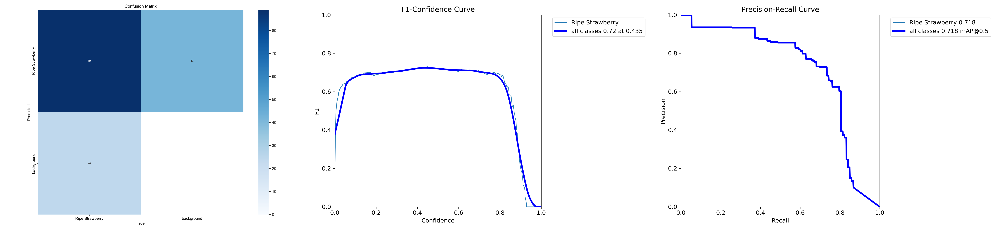

**Figure 2.** The confusion matrix, F1 curve, and PR 

In [ ]:
# Load images
img1 = Image.open(os.path.join(repo.working_tree_dir, 
                               "Validation/runs/detect/val/confusion_matrix.png"))
img2 = Image.open(os.path.join(repo.working_tree_dir, 
                               "Validation/runs/detect/val/F1_curve.png")
)
img3 = Image.open(os.path.join(repo.working_tree_dir, 
                               "Validation/runs/detect/val/PR_curve.png")
)
# # Resize (optional)
img1 = img1.resize((2000,1500))
# img2 = img2.resize((300, 300))

# Combine side by side
combined = Image.new("RGB", (img1.width + img2.width + img3.width, max(img1.height, img2.height)))
combined.paste(img1, (0, 0))
combined.paste(img2, (img1.width, 0))
combined.paste(img3, (img1.width + img2.width, 0))

# Display image
display(combined)

# Add caption
display(Markdown("**Figure 2.** The confusion matrix, F1 curve, and PR "))

- From these graphs, we see that the number of false positives seems to outnumber the number of false negatives. 
- F1 also attains a stable value quickly, before a slower drop off. This is mirrored in the PR curve where the plateuing of precision as recall increases is earlier than the plateuing of recall as precision increases. 
    - This indicates that the majority of false positives get lower confidence, whereas many true positives get mid confidences. 
    - This could then indicate that many true positives are harder to detect. 

Let's check this

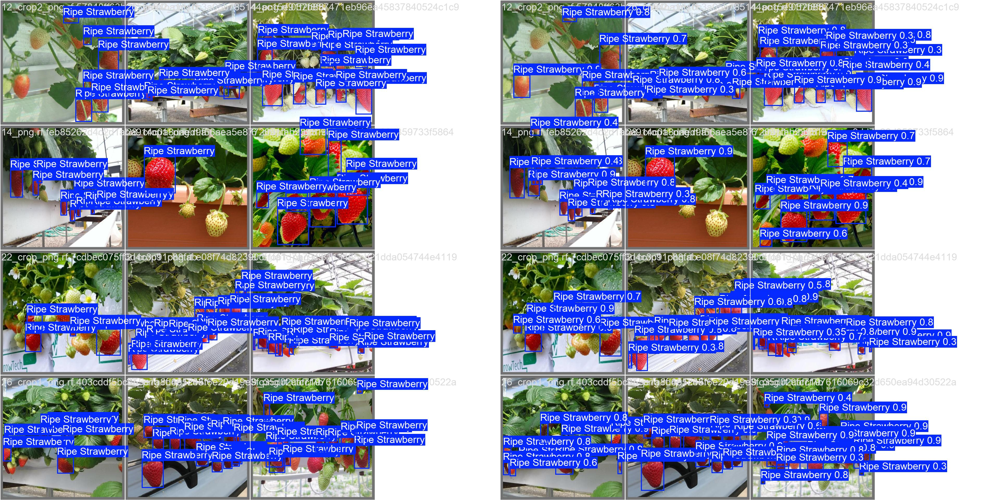

**Figure 2.** Validation Plots. Left:labels. Right: Predictions.

In [35]:
# Load images
img1 = Image.open(os.path.join(repo.working_tree_dir, 
                               "Validation/runs/detect/val/val_batch0_labels.jpg"))
img2 = Image.open(os.path.join(repo.working_tree_dir, 
                               "Validation/runs/detect/val/val_batch0_pred.jpg")
)

# # Resize (optional)
# img1 = img1.resize((2000,1500))
# img2 = img2.resize((300, 300))

# Combine side by side
combined = Image.new("RGB", (img1.width + img2.width, max(img1.height, img2.height)))
combined.paste(img1, (0, 0))
combined.paste(img2, (img1.width, 0))

# Display image
display(combined)

# Add caption
display(Markdown("**Figure 2.** Validation Plots. Left:labels. Right: Predictions."))

- From a simple visual inspection of the labels and off tables, we can see examples of why the model is confused. 
    - For one, in the correct labels there are varying degrees of ripeness that were annotated as ripe. For instance, the pink strawberry for the second image from the top farthest to the right has a prominent pink strawberry. This strawberry seems no more or less ripe than the pink strawberry on the top left image, but one was labeled ripe and the other was not. 
    - Partially occluded strawberries are also an issue to spot; I notice for some instances that the model would bound more tightly on the red portions of covered strawberries, while human labels might include the estimated shape of the ripe strawberry to include areas covered by green leaves. 

Overall, this error analysis casts doubt on whether the model will be able to achieve much higher scores, given the small size and inconsistent labeling of the training data. 

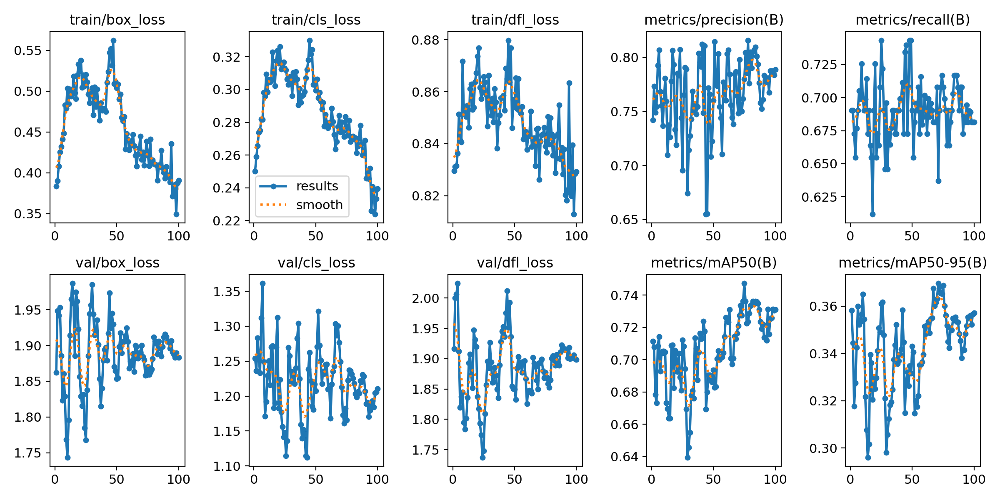

**Figure 3.** Training Metrics of the default finetuned model

In [40]:
# Load images
img1 = Image.open(os.path.join(repo.working_tree_dir, 
                               "runs/detect/V1default2/results.png"))

# Display image
display(img1)

# Add caption
display(Markdown("**Figure 3.** Training Metrics of the default finetuned model"))

- Given that loss did not seem to plateau after 100 epochs, I decided to try again and train my model with more epochs. 

## More Epochs Training Run

In [23]:
# Train the model under default settings with more epochs
os.chdir(repo.working_tree_dir)
v1yolo11 = yolo11.train(data=os.path.join(repo.working_tree_dir,"Data\\Project3---Strawberry-1\\data.yaml"), 
                        model = os.path.join(repo.working_tree_dir,"Models/pretrain/yolo11l.pt"),
                       epochs=1000, imgsz=640,name="V1more_epochs",val=False)

New https://pypi.org/project/ultralytics/8.3.111 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
engine\trainer: task=detect, mode=train, model=c:\Users\Public\Documents\Class_Projects\Strobbery\Models/pretrain/yolo11l.pt, data=c:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-1\data.yaml, epochs=1000, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=V1more_epochs, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=False, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stri

train: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-1\train\labels.cache... 135 images, 0 backgrounds, 0 corrupt: 100%|██████████| 135/135 [00:00<?, ?it/s]
val: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-1\valid\labels.cache... 12 images, 0 backgrounds, 0 corrupt: 100%|██████████| 12/12 [00:00<?, ?it/s]


Plotting labels to runs\detect\V1more_epochs\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs\detect\V1more_epochs
Starting training for 1000 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     1/1000       2.5G     0.8348     0.5133     0.9691         75        640: 100%|██████████| 9/9 [00:01<00:00,  7.82it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     2/1000       2.5G       0.82     0.4871     0.9607         62        640: 100%|██████████| 9/9 [00:00<00:00, 10.83it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     3/1000      2.66G     0.8488     0.5056     0.9744        100        640: 100%|██████████| 9/9 [00:00<00:00, 11.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     4/1000      2.66G      0.849     0.5058     0.9732         96        640: 100%|██████████| 9/9 [00:00<00:00, 11.74it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     5/1000      2.67G     0.8375     0.5104     0.9856        135        640: 100%|██████████| 9/9 [00:00<00:00, 11.86it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     6/1000      2.68G     0.8913     0.5376     0.9952        110        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     7/1000      2.68G     0.9031     0.5297     0.9966         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.35it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     8/1000      2.69G     0.9463     0.5599      1.045         56        640: 100%|██████████| 9/9 [00:00<00:00, 13.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     9/1000       2.7G     0.9281     0.5422      1.014        110        640: 100%|██████████| 9/9 [00:00<00:00, 12.42it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    10/1000      2.72G     0.9798     0.5726      1.031         78        640: 100%|██████████| 9/9 [00:00<00:00, 13.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    11/1000      2.72G     0.9796      0.571      1.031        101        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    12/1000      2.72G     0.9756     0.5618       1.03        129        640: 100%|██████████| 9/9 [00:00<00:00, 12.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    13/1000      2.72G      1.006      0.594      1.031        129        640: 100%|██████████| 9/9 [00:00<00:00, 12.68it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    14/1000      2.72G      0.994     0.5929       1.05        128        640: 100%|██████████| 9/9 [00:00<00:00, 12.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    15/1000      2.72G      1.033     0.6233      1.045        130        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    16/1000      2.72G     0.9808     0.5902      1.032        107        640: 100%|██████████| 9/9 [00:00<00:00, 11.94it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    17/1000      2.72G     0.9855     0.5797      1.035        142        640: 100%|██████████| 9/9 [00:00<00:00, 13.20it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    18/1000      2.75G      1.021     0.5847      1.046        125        640: 100%|██████████| 9/9 [00:00<00:00, 12.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    19/1000      2.76G      1.026     0.5926      1.054         72        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    20/1000      2.92G      1.014     0.6102      1.064         88        640: 100%|██████████| 9/9 [00:00<00:00, 12.34it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    21/1000      2.93G      1.013     0.5947      1.061         73        640: 100%|██████████| 9/9 [00:00<00:00, 12.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    22/1000      2.95G     0.9408      0.573      1.025        112        640: 100%|██████████| 9/9 [00:00<00:00, 12.42it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    23/1000      2.96G     0.9462     0.5652      1.015        111        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    24/1000      2.98G      0.937     0.5491      1.024        101        640: 100%|██████████| 9/9 [00:00<00:00, 12.47it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    25/1000      2.99G     0.9861       0.57      1.043         96        640: 100%|██████████| 9/9 [00:00<00:00, 13.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    26/1000      2.99G     0.9761     0.5644      1.042         94        640: 100%|██████████| 9/9 [00:00<00:00, 11.57it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    27/1000      2.99G     0.9819     0.5754      1.036         72        640: 100%|██████████| 9/9 [00:00<00:00, 12.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    28/1000      2.99G     0.9624     0.5645      1.012        116        640: 100%|██████████| 9/9 [00:00<00:00, 12.21it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    29/1000      2.99G      0.991     0.5825      1.044        123        640: 100%|██████████| 9/9 [00:00<00:00, 12.80it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    30/1000      2.99G      1.021     0.5812      1.042        115        640: 100%|██████████| 9/9 [00:00<00:00, 13.06it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    31/1000      2.99G     0.9627     0.5658      1.032         74        640: 100%|██████████| 9/9 [00:00<00:00, 13.17it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    32/1000      2.99G     0.9898     0.5705      1.037        139        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    33/1000      2.99G     0.9496     0.5679      1.015         98        640: 100%|██████████| 9/9 [00:00<00:00, 13.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    34/1000      2.99G     0.9946     0.5791      1.041         75        640: 100%|██████████| 9/9 [00:00<00:00, 12.47it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    35/1000      2.99G     0.9372     0.5565      1.023        113        640: 100%|██████████| 9/9 [00:00<00:00, 12.15it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    36/1000      2.99G     0.9912     0.5559      1.014        120        640: 100%|██████████| 9/9 [00:00<00:00, 11.52it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    37/1000      2.99G     0.9635     0.5542      1.015         95        640: 100%|██████████| 9/9 [00:00<00:00, 12.50it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    38/1000      2.99G     0.9303     0.5457      1.007         81        640: 100%|██████████| 9/9 [00:00<00:00, 12.72it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    39/1000      2.99G     0.9754     0.5543      1.045        102        640: 100%|██████████| 9/9 [00:00<00:00, 12.38it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    40/1000      2.99G     0.9456      0.558      1.023         94        640: 100%|██████████| 9/9 [00:00<00:00, 12.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    41/1000      2.99G     0.9533      0.561      1.034        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    42/1000      2.99G     0.9841     0.5592      1.028        120        640: 100%|██████████| 9/9 [00:00<00:00, 12.92it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    43/1000      2.99G      1.036     0.5857      1.078         46        640: 100%|██████████| 9/9 [00:00<00:00, 13.04it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    44/1000      2.99G     0.9912     0.5765      1.039        146        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    45/1000      2.99G     0.9625     0.5953      1.043         38        640: 100%|██████████| 9/9 [00:00<00:00, 13.12it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    46/1000      2.99G      1.002     0.5747      1.037         98        640: 100%|██████████| 9/9 [00:00<00:00, 13.20it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    47/1000      2.99G      1.003     0.5912      1.062        114        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    48/1000      2.99G     0.9357     0.5415     0.9999         93        640: 100%|██████████| 9/9 [00:00<00:00, 12.77it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    49/1000      2.99G     0.9848     0.5753      1.045        137        640: 100%|██████████| 9/9 [00:00<00:00, 12.92it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    50/1000      2.99G     0.9673     0.5394      1.028         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.83it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    51/1000      2.99G     0.9797      0.556      1.046         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.41it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    52/1000      2.99G     0.9351     0.5316      1.012         53        640: 100%|██████████| 9/9 [00:00<00:00, 12.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    53/1000      2.99G     0.9195     0.5534      1.019         43        640: 100%|██████████| 9/9 [00:00<00:00, 12.98it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    54/1000      2.99G      0.889     0.5185      1.004        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.64it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    55/1000      2.99G     0.8966     0.5227     0.9959        145        640: 100%|██████████| 9/9 [00:00<00:00, 12.76it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    56/1000      2.99G     0.9057     0.5353      1.011         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.63it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    57/1000      2.99G     0.8965       0.52      1.002         78        640: 100%|██████████| 9/9 [00:00<00:00, 12.93it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    58/1000      2.99G     0.9787     0.5488      1.024        140        640: 100%|██████████| 9/9 [00:00<00:00, 12.75it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    59/1000      2.99G     0.9421     0.5289      1.012         86        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    60/1000      3.14G     0.9575     0.5367      1.022        131        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    61/1000      3.14G     0.9672     0.5412       1.02        102        640: 100%|██████████| 9/9 [00:00<00:00, 12.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    62/1000      3.14G     0.9406     0.5393      1.031         82        640: 100%|██████████| 9/9 [00:00<00:00, 12.83it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    63/1000      3.14G     0.9231     0.5416      1.019         77        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    64/1000      3.14G     0.9287     0.5357      1.014         88        640: 100%|██████████| 9/9 [00:00<00:00, 12.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    65/1000      3.14G     0.8931       0.51      1.002        141        640: 100%|██████████| 9/9 [00:00<00:00, 12.72it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    66/1000      3.14G     0.8553     0.5001     0.9949         70        640: 100%|██████████| 9/9 [00:00<00:00, 13.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    67/1000      3.14G     0.8898      0.505      0.988        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.86it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    68/1000      3.14G     0.9218     0.5307      1.009         90        640: 100%|██████████| 9/9 [00:00<00:00, 12.70it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    69/1000      3.14G     0.9414     0.5303       1.02         84        640: 100%|██████████| 9/9 [00:00<00:00, 13.13it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    70/1000      3.14G     0.8741     0.5015     0.9733        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.90it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    71/1000      3.14G     0.9064     0.5076      1.002        128        640: 100%|██████████| 9/9 [00:00<00:00, 12.74it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    72/1000      3.14G      0.875     0.5086     0.9969        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.52it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    73/1000      3.14G     0.8885     0.5179      1.001        138        640: 100%|██████████| 9/9 [00:00<00:00, 12.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    74/1000      3.14G     0.9426     0.5483       1.02         74        640: 100%|██████████| 9/9 [00:00<00:00, 12.43it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    75/1000      3.14G      0.947     0.5381       1.01        133        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    76/1000      3.14G     0.8985     0.5256      1.002         89        640: 100%|██████████| 9/9 [00:00<00:00, 12.70it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    77/1000      3.14G     0.9329     0.5385      1.017         97        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    78/1000      3.14G     0.8868     0.4974     0.9913         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.75it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    79/1000      3.14G     0.8696     0.5043     0.9942         80        640: 100%|██████████| 9/9 [00:00<00:00, 11.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    80/1000      3.14G     0.8547     0.4916      0.986         98        640: 100%|██████████| 9/9 [00:00<00:00, 11.82it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    81/1000      3.14G     0.8706     0.4924     0.9787         89        640: 100%|██████████| 9/9 [00:00<00:00, 12.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    82/1000      3.14G     0.8754     0.5179      0.988         76        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    83/1000      3.14G     0.8684     0.4995     0.9807        130        640: 100%|██████████| 9/9 [00:00<00:00, 12.82it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    84/1000      3.14G     0.8485     0.4914     0.9784         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    85/1000      3.14G     0.8573     0.4986     0.9901         98        640: 100%|██████████| 9/9 [00:00<00:00, 13.04it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    86/1000      3.14G     0.9331     0.5261      1.038         72        640: 100%|██████████| 9/9 [00:00<00:00, 13.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    87/1000      3.14G     0.8611     0.4921     0.9718        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    88/1000      3.14G     0.8477      0.501     0.9776        158        640: 100%|██████████| 9/9 [00:00<00:00, 11.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    89/1000      3.14G     0.8721     0.5024     0.9761        163        640: 100%|██████████| 9/9 [00:00<00:00, 12.79it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    90/1000      3.14G     0.8769     0.5141     0.9839        145        640: 100%|██████████| 9/9 [00:00<00:00, 12.35it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    91/1000      3.14G     0.8854     0.4999     0.9886        105        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    92/1000      3.14G     0.9068     0.5164     0.9858         83        640: 100%|██████████| 9/9 [00:00<00:00, 11.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    93/1000      3.14G     0.8853     0.5032     0.9786        121        640: 100%|██████████| 9/9 [00:00<00:00, 11.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    94/1000      3.14G     0.8853      0.518          1         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.30it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    95/1000      3.14G     0.8378     0.4911     0.9712        137        640: 100%|██████████| 9/9 [00:00<00:00, 12.17it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    96/1000      3.14G     0.9067     0.5088      1.004         94        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    97/1000      3.14G     0.8993     0.5124      1.003         82        640: 100%|██████████| 9/9 [00:00<00:00, 12.84it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    98/1000      3.14G     0.8346     0.4949     0.9699        101        640: 100%|██████████| 9/9 [00:00<00:00, 12.96it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    99/1000      3.14G     0.8379     0.4898     0.9716         92        640: 100%|██████████| 9/9 [00:00<00:00, 12.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   100/1000      3.14G     0.8488     0.4994     0.9808        109        640: 100%|██████████| 9/9 [00:00<00:00, 12.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   101/1000      3.14G     0.8539     0.5054      0.995         93        640: 100%|██████████| 9/9 [00:00<00:00, 12.77it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   102/1000      3.14G      0.812     0.4819     0.9579        114        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   103/1000      3.14G     0.8776     0.4975     0.9802         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.95it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   104/1000      3.14G     0.8454     0.4817     0.9869        118        640: 100%|██████████| 9/9 [00:00<00:00, 11.93it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   105/1000      3.14G     0.8549     0.4853     0.9841         78        640: 100%|██████████| 9/9 [00:00<00:00, 12.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   106/1000      3.14G     0.8136     0.4714     0.9625        150        640: 100%|██████████| 9/9 [00:00<00:00, 12.34it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   107/1000      3.14G     0.8432      0.476     0.9791        104        640: 100%|██████████| 9/9 [00:00<00:00, 13.03it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   108/1000      3.14G     0.7994     0.4757     0.9589        118        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   109/1000      3.14G      0.832     0.4756     0.9697        154        640: 100%|██████████| 9/9 [00:00<00:00, 12.79it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   110/1000      3.14G     0.8766     0.5044      1.013         62        640: 100%|██████████| 9/9 [00:00<00:00, 12.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   111/1000      3.14G     0.8383      0.476     0.9691        122        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   112/1000      3.14G     0.8187     0.4769     0.9681        129        640: 100%|██████████| 9/9 [00:00<00:00, 12.06it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   113/1000      3.14G     0.8051      0.464     0.9621        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   114/1000      3.14G     0.7979     0.4645     0.9728         78        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   115/1000      3.14G     0.8536     0.4879     0.9731         79        640: 100%|██████████| 9/9 [00:00<00:00, 10.32it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   116/1000      3.14G     0.8464     0.4791     0.9635        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.65it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   117/1000      3.14G     0.8507     0.4858      0.978        117        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   118/1000      3.14G     0.8132     0.4698     0.9533         82        640: 100%|██████████| 9/9 [00:00<00:00, 11.70it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   119/1000      3.14G     0.8631      0.463     0.9755         93        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   120/1000      3.14G     0.8257     0.4683     0.9615        110        640: 100%|██████████| 9/9 [00:00<00:00, 11.94it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   121/1000      3.14G     0.8132     0.4714     0.9732         90        640: 100%|██████████| 9/9 [00:00<00:00, 12.34it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   122/1000      3.14G     0.8339     0.4732     0.9579         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.62it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   123/1000      3.14G     0.8154     0.4678     0.9601         83        640: 100%|██████████| 9/9 [00:00<00:00, 11.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   124/1000      3.14G     0.8306       0.48     0.9666         94        640: 100%|██████████| 9/9 [00:00<00:00, 12.57it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   125/1000      3.14G     0.8385      0.476     0.9797        102        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   126/1000      3.14G     0.8092     0.4631     0.9471        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.84it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   127/1000      3.14G     0.7539     0.4425     0.9359         94        640: 100%|██████████| 9/9 [00:00<00:00, 12.83it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   128/1000      3.14G     0.7799     0.4446     0.9374        123        640: 100%|██████████| 9/9 [00:00<00:00, 11.90it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   129/1000      3.14G     0.7742     0.4438     0.9448        140        640: 100%|██████████| 9/9 [00:00<00:00, 12.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   130/1000      3.14G     0.7755     0.4532     0.9651         73        640: 100%|██████████| 9/9 [00:00<00:00, 12.80it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   131/1000      3.14G     0.7935     0.4577     0.9592         88        640: 100%|██████████| 9/9 [00:00<00:00, 12.66it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   132/1000      3.14G     0.8244     0.4668     0.9673        111        640: 100%|██████████| 9/9 [00:00<00:00, 12.52it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   133/1000      3.14G     0.7827     0.4542     0.9509        137        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   134/1000      3.14G     0.7877     0.4566     0.9486        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   135/1000      3.14G       0.78     0.4525     0.9572         53        640: 100%|██████████| 9/9 [00:00<00:00, 12.77it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   136/1000      3.14G     0.7779     0.4508     0.9509        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.70it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   137/1000      3.14G     0.8062     0.4885     0.9704         39        640: 100%|██████████| 9/9 [00:00<00:00, 12.92it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   138/1000      3.14G     0.7624     0.4405     0.9442         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.60it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   139/1000      3.14G     0.8164      0.478     0.9694         61        640: 100%|██████████| 9/9 [00:00<00:00, 12.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   140/1000      3.14G      0.808     0.4649     0.9681        114        640: 100%|██████████| 9/9 [00:00<00:00, 12.74it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   141/1000      3.14G     0.8314     0.4583     0.9758         93        640: 100%|██████████| 9/9 [00:00<00:00, 12.38it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   142/1000      3.14G     0.8109     0.4667     0.9707         86        640: 100%|██████████| 9/9 [00:00<00:00, 12.98it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   143/1000      3.14G     0.7916     0.4497     0.9608        121        640: 100%|██████████| 9/9 [00:00<00:00, 12.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   144/1000      3.14G     0.7702     0.4498     0.9582         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   145/1000      3.14G     0.7424      0.434     0.9334         77        640: 100%|██████████| 9/9 [00:00<00:00, 12.91it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   146/1000      3.14G     0.7594     0.4468     0.9453        104        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   147/1000      3.14G     0.7728     0.4479     0.9587        132        640: 100%|██████████| 9/9 [00:00<00:00, 12.68it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   148/1000      3.14G     0.7556     0.4449     0.9429        122        640: 100%|██████████| 9/9 [00:00<00:00, 11.73it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   149/1000      3.14G     0.7852     0.4513      0.949         62        640: 100%|██████████| 9/9 [00:00<00:00, 12.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   150/1000      3.14G     0.7915     0.4606     0.9409        182        640: 100%|██████████| 9/9 [00:00<00:00, 12.02it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   151/1000      3.14G     0.7965     0.4506     0.9579         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   152/1000      3.14G     0.7593     0.4377     0.9467        116        640: 100%|██████████| 9/9 [00:00<00:00, 12.20it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   153/1000      3.14G     0.7841     0.4586     0.9567         92        640: 100%|██████████| 9/9 [00:00<00:00, 11.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   154/1000      3.14G     0.8039     0.4638      0.965        115        640: 100%|██████████| 9/9 [00:00<00:00, 12.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   155/1000      3.14G     0.7754     0.4461     0.9408        107        640: 100%|██████████| 9/9 [00:00<00:00, 12.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   156/1000      3.14G     0.7431     0.4455     0.9441        123        640: 100%|██████████| 9/9 [00:00<00:00, 11.74it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   157/1000      3.14G     0.7697     0.4424     0.9422        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.82it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   158/1000      3.14G     0.7976     0.4538     0.9557        156        640: 100%|██████████| 9/9 [00:00<00:00, 12.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   159/1000      3.14G     0.7778     0.4496     0.9534         42        640: 100%|██████████| 9/9 [00:00<00:00, 12.52it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   160/1000      3.14G     0.7568     0.4338      0.945         65        640: 100%|██████████| 9/9 [00:00<00:00, 12.19it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   161/1000      3.14G     0.7609     0.4418      0.936         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.34it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   162/1000      3.14G     0.7485     0.4293     0.9372         85        640: 100%|██████████| 9/9 [00:00<00:00, 11.67it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   163/1000      3.14G     0.7437     0.4389     0.9395         85        640: 100%|██████████| 9/9 [00:00<00:00, 12.32it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   164/1000      3.14G     0.7557      0.427     0.9489         74        640: 100%|██████████| 9/9 [00:00<00:00, 11.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   165/1000      3.14G     0.7395     0.4333     0.9372        105        640: 100%|██████████| 9/9 [00:00<00:00, 12.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   166/1000      3.14G     0.7596     0.4365     0.9437        111        640: 100%|██████████| 9/9 [00:00<00:00, 10.83it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   167/1000      3.14G     0.7521     0.4393     0.9416        137        640: 100%|██████████| 9/9 [00:00<00:00, 12.03it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   168/1000      3.14G     0.7489     0.4321     0.9424        191        640: 100%|██████████| 9/9 [00:00<00:00, 11.35it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   169/1000      3.14G     0.7094     0.4245     0.9292         81        640: 100%|██████████| 9/9 [00:00<00:00, 11.98it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   170/1000      3.14G      0.735     0.4247     0.9306        126        640: 100%|██████████| 9/9 [00:00<00:00, 12.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   171/1000      3.14G     0.7261     0.4267     0.9325        107        640: 100%|██████████| 9/9 [00:00<00:00, 11.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   172/1000      3.14G     0.7328     0.4319     0.9363        102        640: 100%|██████████| 9/9 [00:00<00:00, 11.42it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   173/1000      3.14G     0.7296     0.4217     0.9328         89        640: 100%|██████████| 9/9 [00:00<00:00, 11.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   174/1000      3.14G     0.7294     0.4341     0.9374         89        640: 100%|██████████| 9/9 [00:00<00:00, 12.13it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   175/1000      3.14G     0.7427     0.4275     0.9306        149        640: 100%|██████████| 9/9 [00:00<00:00, 11.63it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   176/1000      3.14G     0.7126     0.4155     0.9254        112        640: 100%|██████████| 9/9 [00:00<00:00, 11.78it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   177/1000      3.14G     0.7284     0.4253     0.9266        115        640: 100%|██████████| 9/9 [00:00<00:00, 12.12it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   178/1000      3.14G     0.7315     0.4326     0.9363         64        640: 100%|██████████| 9/9 [00:00<00:00, 12.18it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   179/1000      3.14G     0.7096     0.4238     0.9295         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.08it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   180/1000      3.14G     0.6879     0.4085     0.9198        144        640: 100%|██████████| 9/9 [00:00<00:00, 11.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   181/1000      3.14G     0.6946     0.4158     0.9164        109        640: 100%|██████████| 9/9 [00:00<00:00, 12.02it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   182/1000      3.14G     0.7508     0.4364     0.9421         93        640: 100%|██████████| 9/9 [00:00<00:00, 12.08it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   183/1000      3.14G     0.7183      0.424     0.9197        111        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   184/1000      3.14G     0.7233     0.4189     0.9366         83        640: 100%|██████████| 9/9 [00:00<00:00, 11.86it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   185/1000      3.14G     0.7294     0.4192     0.9308         87        640: 100%|██████████| 9/9 [00:00<00:00, 12.08it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   186/1000      3.14G     0.7275     0.4219     0.9289        118        640: 100%|██████████| 9/9 [00:00<00:00, 11.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   187/1000      3.14G     0.7064      0.415     0.9247         78        640: 100%|██████████| 9/9 [00:00<00:00, 11.77it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   188/1000      3.14G     0.7394       0.43     0.9451        113        640: 100%|██████████| 9/9 [00:00<00:00, 11.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   189/1000      3.14G     0.6893     0.4003     0.9271         73        640: 100%|██████████| 9/9 [00:00<00:00, 12.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   190/1000      3.14G      0.729     0.4159     0.9351         97        640: 100%|██████████| 9/9 [00:00<00:00, 12.45it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   191/1000      3.14G     0.7052     0.4229     0.9205         90        640: 100%|██████████| 9/9 [00:00<00:00, 11.96it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   192/1000      3.14G     0.6861     0.4032     0.9193         84        640: 100%|██████████| 9/9 [00:00<00:00, 11.02it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   193/1000      3.14G      0.712      0.424     0.9222         64        640: 100%|██████████| 9/9 [00:00<00:00, 11.69it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   194/1000      3.14G     0.7089     0.4119     0.9225        181        640: 100%|██████████| 9/9 [00:00<00:00, 11.73it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   195/1000      3.14G     0.7094     0.4088     0.9305        117        640: 100%|██████████| 9/9 [00:00<00:00, 11.71it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   196/1000      3.14G      0.704     0.4095     0.9281         85        640: 100%|██████████| 9/9 [00:00<00:00, 11.75it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   197/1000      3.14G     0.7357     0.4282     0.9414         85        640: 100%|██████████| 9/9 [00:00<00:00, 11.69it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   198/1000      3.14G     0.7415      0.425     0.9485         62        640: 100%|██████████| 9/9 [00:00<00:00, 11.18it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   199/1000      3.14G     0.8012     0.4543     0.9662         50        640: 100%|██████████| 9/9 [00:00<00:00, 11.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   200/1000      3.14G     0.7772     0.4368     0.9394         80        640: 100%|██████████| 9/9 [00:00<00:00, 11.35it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   201/1000      3.14G     0.7805     0.4354     0.9453        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   202/1000      3.14G     0.7822     0.4458      0.949         60        640: 100%|██████████| 9/9 [00:00<00:00, 11.80it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   203/1000      3.14G     0.7996     0.4409     0.9614        123        640: 100%|██████████| 9/9 [00:00<00:00, 12.06it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   204/1000      3.14G     0.7495     0.4229     0.9274        169        640: 100%|██████████| 9/9 [00:00<00:00, 11.96it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   205/1000      3.14G     0.7483     0.4232      0.933         75        640: 100%|██████████| 9/9 [00:00<00:00, 11.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   206/1000      3.14G     0.6957     0.4084     0.9219         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   207/1000      3.14G     0.6809     0.3972     0.9296        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   208/1000      3.14G     0.7024     0.4053     0.9225        115        640: 100%|██████████| 9/9 [00:00<00:00, 12.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   209/1000      3.14G     0.6572     0.3971      0.918         74        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   210/1000      3.14G     0.6671     0.3965     0.9186        124        640: 100%|██████████| 9/9 [00:00<00:00, 12.32it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   211/1000      3.14G     0.7068     0.4113     0.9245         82        640: 100%|██████████| 9/9 [00:00<00:00, 12.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   212/1000      3.14G      0.692     0.4016     0.9257         79        640: 100%|██████████| 9/9 [00:00<00:00, 11.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   213/1000      3.14G     0.6862     0.4016     0.9141         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.17it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   214/1000      3.14G     0.6774      0.399     0.9161         94        640: 100%|██████████| 9/9 [00:00<00:00, 12.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   215/1000      3.14G     0.6665     0.3951     0.9121        118        640: 100%|██████████| 9/9 [00:00<00:00, 12.47it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   216/1000      3.14G     0.6972      0.403     0.9111        125        640: 100%|██████████| 9/9 [00:00<00:00, 11.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   217/1000      3.14G       0.69     0.3996     0.9109         78        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   218/1000      3.14G     0.6844     0.3986     0.9213         78        640: 100%|██████████| 9/9 [00:00<00:00, 11.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   219/1000      3.14G     0.6685     0.3995     0.9129         78        640: 100%|██████████| 9/9 [00:00<00:00, 11.65it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   220/1000      3.14G      0.688     0.4146     0.9193         76        640: 100%|██████████| 9/9 [00:00<00:00, 12.02it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   221/1000      3.14G     0.6663     0.3877     0.9045        117        640: 100%|██████████| 9/9 [00:00<00:00, 12.57it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   222/1000      3.14G     0.6956     0.4068     0.9291         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.50it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   223/1000      3.14G     0.7061     0.4136     0.9163        129        640: 100%|██████████| 9/9 [00:00<00:00, 12.32it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   224/1000      3.14G     0.6735     0.4044     0.9143         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.02it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   225/1000      3.14G     0.6614     0.3944     0.9139         86        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   226/1000      3.14G     0.6694     0.3943     0.9176        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   227/1000      3.14G       0.68     0.4127     0.9153        111        640: 100%|██████████| 9/9 [00:00<00:00, 11.80it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   228/1000      3.14G     0.6698     0.3983     0.9081         77        640: 100%|██████████| 9/9 [00:00<00:00, 11.54it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   229/1000      3.14G     0.6611     0.3892     0.9055        146        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   230/1000      3.14G     0.6789     0.3974     0.9193         82        640: 100%|██████████| 9/9 [00:00<00:00, 10.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   231/1000      3.14G     0.6912     0.4025     0.9201        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   232/1000      3.14G     0.6897     0.4051     0.9158         77        640: 100%|██████████| 9/9 [00:00<00:00, 12.03it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   233/1000      3.14G     0.6448     0.3799     0.8943         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   234/1000      3.14G      0.667      0.395     0.9092        129        640: 100%|██████████| 9/9 [00:00<00:00, 11.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   235/1000      3.14G      0.704       0.41     0.9414        157        640: 100%|██████████| 9/9 [00:00<00:00, 12.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   236/1000      3.14G     0.7249     0.4041     0.9435         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.04it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   237/1000      3.14G     0.7382     0.4185     0.9331         72        640: 100%|██████████| 9/9 [00:00<00:00, 11.95it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   238/1000      3.14G     0.7277     0.4226     0.9238        138        640: 100%|██████████| 9/9 [00:00<00:00, 12.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   239/1000      3.14G     0.7268     0.4112     0.9316         70        640: 100%|██████████| 9/9 [00:00<00:00, 12.13it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   240/1000      3.14G     0.7171      0.418     0.9278         48        640: 100%|██████████| 9/9 [00:00<00:00, 11.59it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   241/1000      3.14G      0.675     0.3934     0.9069        100        640: 100%|██████████| 9/9 [00:00<00:00, 11.91it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   242/1000      3.14G     0.6664     0.3929     0.9096         95        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   243/1000      3.14G     0.6885     0.4103      0.921        155        640: 100%|██████████| 9/9 [00:00<00:00, 12.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   244/1000      3.14G     0.6504     0.3882     0.9007         97        640: 100%|██████████| 9/9 [00:00<00:00, 11.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   245/1000      3.14G     0.6657     0.3892     0.9102         95        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   246/1000      3.14G       0.68     0.3941     0.9136         63        640: 100%|██████████| 9/9 [00:00<00:00, 12.13it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   247/1000      3.14G     0.6591     0.3832     0.9122         70        640: 100%|██████████| 9/9 [00:00<00:00, 12.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   248/1000      3.14G     0.6594     0.4013     0.9104         59        640: 100%|██████████| 9/9 [00:00<00:00, 11.57it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   249/1000      3.14G      0.633     0.3858     0.8979         63        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   250/1000      3.14G      0.652     0.3896     0.9089        118        640: 100%|██████████| 9/9 [00:00<00:00, 12.79it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   251/1000      3.14G     0.6619     0.3997      0.922         73        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   252/1000      3.14G     0.6678      0.394     0.9058        147        640: 100%|██████████| 9/9 [00:00<00:00, 12.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   253/1000      3.14G     0.6718     0.4009     0.9198        114        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   254/1000      3.14G     0.6891     0.4039     0.9002        132        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   255/1000      3.14G     0.6784     0.3965     0.9106        131        640: 100%|██████████| 9/9 [00:00<00:00, 11.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   256/1000      3.14G      0.682     0.4068     0.9097        120        640: 100%|██████████| 9/9 [00:00<00:00,  9.59it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   257/1000      3.14G     0.6822     0.4016      0.913        129        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   258/1000      3.14G     0.6368      0.385     0.8903         71        640: 100%|██████████| 9/9 [00:00<00:00, 12.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   259/1000      3.14G     0.6533     0.3895     0.9026        131        640: 100%|██████████| 9/9 [00:00<00:00, 11.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   260/1000      3.14G     0.6497       0.38     0.9032        120        640: 100%|██████████| 9/9 [00:00<00:00, 11.64it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   261/1000      3.14G      0.639     0.3816     0.9092         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.19it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   262/1000      3.14G     0.6218     0.3769     0.9006        131        640: 100%|██████████| 9/9 [00:00<00:00, 11.84it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   263/1000      3.14G     0.6432     0.3835     0.9077         65        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   264/1000      3.14G     0.6666     0.3882     0.9158         84        640: 100%|██████████| 9/9 [00:00<00:00, 11.67it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   265/1000      3.14G     0.6451     0.3809     0.9028         68        640: 100%|██████████| 9/9 [00:00<00:00, 12.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   266/1000      3.14G     0.6591     0.3875     0.9057         75        640: 100%|██████████| 9/9 [00:00<00:00, 12.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   267/1000      3.14G     0.6504     0.3805     0.9056         99        640: 100%|██████████| 9/9 [00:00<00:00, 11.34it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   268/1000      3.14G     0.6554     0.3841     0.9234        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.30it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   269/1000      3.14G     0.6357     0.3804     0.8973        140        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   270/1000      3.14G     0.6565     0.3907     0.9047         94        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   271/1000      3.14G     0.6512     0.3787     0.8987        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.07it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   272/1000      3.14G     0.6485       0.38     0.8981        127        640: 100%|██████████| 9/9 [00:00<00:00, 11.78it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   273/1000      3.14G     0.6397     0.3841     0.9046        112        640: 100%|██████████| 9/9 [00:00<00:00, 12.59it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   274/1000      3.14G     0.6471     0.3913     0.9042         76        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   275/1000      3.14G     0.6222     0.3689     0.9036        101        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   276/1000      3.14G     0.6367     0.3748     0.8917         95        640: 100%|██████████| 9/9 [00:00<00:00, 12.30it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   277/1000      3.14G     0.6413     0.3838     0.9025        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   278/1000      3.14G     0.6327     0.3782     0.9017         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.30it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   279/1000      3.14G      0.611     0.3728     0.8835        102        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   280/1000      3.14G     0.6305      0.376     0.9009        154        640: 100%|██████████| 9/9 [00:00<00:00, 11.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   281/1000      3.14G     0.6362     0.3772     0.8929         72        640: 100%|██████████| 9/9 [00:00<00:00, 12.41it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   282/1000      3.14G     0.6312     0.3772     0.9055         82        640: 100%|██████████| 9/9 [00:00<00:00, 12.71it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   283/1000      3.14G      0.623     0.3697      0.901         78        640: 100%|██████████| 9/9 [00:00<00:00, 11.93it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   284/1000      3.14G     0.6245     0.3773      0.901        117        640: 100%|██████████| 9/9 [00:00<00:00, 11.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   285/1000      3.14G     0.5968     0.3623     0.8935        127        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   286/1000      3.14G     0.6345      0.381     0.8998        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   287/1000      3.14G     0.6449     0.3747      0.895         90        640: 100%|██████████| 9/9 [00:00<00:00, 12.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   288/1000      3.14G     0.6502     0.3824     0.8967         94        640: 100%|██████████| 9/9 [00:00<00:00, 12.20it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   289/1000      3.14G     0.6315     0.3769     0.9001        106        640: 100%|██████████| 9/9 [00:00<00:00, 11.80it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   290/1000      3.14G     0.6724     0.3905     0.9169         87        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   291/1000      3.14G     0.6454     0.3794     0.8922        125        640: 100%|██████████| 9/9 [00:00<00:00, 12.52it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   292/1000      3.14G      0.618     0.3639     0.8933         75        640: 100%|██████████| 9/9 [00:00<00:00, 11.50it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   293/1000      3.14G     0.6449     0.3873     0.9046         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   294/1000      3.14G      0.625     0.3777     0.8928         64        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   295/1000      3.14G     0.6224     0.3658     0.8894         86        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   296/1000      3.14G     0.6137     0.3728     0.8932        103        640: 100%|██████████| 9/9 [00:00<00:00, 11.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   297/1000      3.14G     0.6174     0.3712     0.8879         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   298/1000      3.14G     0.6283     0.3741     0.8962        168        640: 100%|██████████| 9/9 [00:00<00:00, 12.08it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   299/1000      3.14G     0.6171     0.3657     0.8945        139        640: 100%|██████████| 9/9 [00:00<00:00, 12.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   300/1000      3.14G     0.6568     0.3864     0.8982         82        640: 100%|██████████| 9/9 [00:00<00:00, 11.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   301/1000      3.14G     0.6426     0.3813      0.895         85        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   302/1000      3.14G     0.6271      0.375     0.8852         81        640: 100%|██████████| 9/9 [00:00<00:00, 12.43it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   303/1000      3.14G     0.6327     0.3777     0.9087         89        640: 100%|██████████| 9/9 [00:00<00:00, 11.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   304/1000      3.14G     0.6433     0.3797     0.9028         59        640: 100%|██████████| 9/9 [00:00<00:00, 11.94it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   305/1000      3.14G     0.6213     0.3704     0.8871        113        640: 100%|██████████| 9/9 [00:00<00:00, 12.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   306/1000      3.14G     0.6041     0.3656     0.8844        122        640: 100%|██████████| 9/9 [00:00<00:00, 12.43it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   307/1000      3.14G       0.61     0.3683     0.8864        120        640: 100%|██████████| 9/9 [00:00<00:00, 12.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   308/1000      3.14G      0.601     0.3625     0.8807        147        640: 100%|██████████| 9/9 [00:00<00:00, 11.64it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   309/1000      3.14G     0.6065     0.3712     0.8931         61        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   310/1000      3.14G     0.5971     0.3632     0.8875        155        640: 100%|██████████| 9/9 [00:00<00:00, 12.62it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   311/1000      3.14G     0.5852     0.3604     0.8852         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.43it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   312/1000      3.14G     0.5998     0.3577     0.8902        114        640: 100%|██████████| 9/9 [00:00<00:00, 11.98it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   313/1000      3.14G     0.6143     0.3614     0.8951         85        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   314/1000      3.14G     0.6047     0.3722     0.8878         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   315/1000      3.14G     0.5888     0.3548      0.886         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.18it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   316/1000      3.14G     0.5897     0.3593     0.8911         68        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   317/1000      3.14G     0.5935     0.3546     0.8844        139        640: 100%|██████████| 9/9 [00:00<00:00, 12.30it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   318/1000      3.14G     0.5834     0.3583     0.8944        104        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   319/1000      3.14G     0.5676     0.3515     0.8812         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.72it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   320/1000      3.14G     0.5973     0.3583     0.8887         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   321/1000      3.14G     0.6027     0.3577     0.8887         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.06it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   322/1000      3.14G     0.6235     0.3732     0.9007         70        640: 100%|██████████| 9/9 [00:00<00:00, 12.35it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   323/1000      3.14G      0.615     0.3649        0.9        113        640: 100%|██████████| 9/9 [00:00<00:00, 12.30it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   324/1000      3.14G     0.6262     0.3645      0.888         63        640: 100%|██████████| 9/9 [00:00<00:00, 11.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   325/1000      3.14G     0.6127     0.3606     0.8981         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   326/1000      3.14G     0.6207     0.3636     0.8864         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.43it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   327/1000      3.14G     0.6082     0.3664     0.8931         67        640: 100%|██████████| 9/9 [00:00<00:00, 12.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   328/1000      3.14G     0.5977     0.3552     0.8852         96        640: 100%|██████████| 9/9 [00:00<00:00, 11.91it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   329/1000      3.14G     0.6049     0.3618      0.888        113        640: 100%|██████████| 9/9 [00:00<00:00, 12.34it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   330/1000      3.14G     0.6019     0.3593     0.8878         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.57it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   331/1000      3.14G     0.6085     0.3668     0.8852         90        640: 100%|██████████| 9/9 [00:00<00:00, 12.31it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   332/1000      3.14G     0.6119     0.3693     0.8933        140        640: 100%|██████████| 9/9 [00:00<00:00, 12.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   333/1000      3.14G     0.6132      0.368     0.8943        113        640: 100%|██████████| 9/9 [00:00<00:00, 12.65it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   334/1000      3.14G     0.6055     0.3559     0.8897         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   335/1000      3.14G     0.5514     0.3434     0.8754         71        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   336/1000      3.14G     0.5852      0.362     0.8834        124        640: 100%|██████████| 9/9 [00:00<00:00, 10.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   337/1000      3.14G     0.6166     0.3612     0.8902        118        640: 100%|██████████| 9/9 [00:00<00:00, 12.21it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   338/1000      3.14G     0.5981     0.3573     0.8765        166        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   339/1000      3.14G     0.5819     0.3562     0.8792        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.37it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   340/1000      3.14G       0.59      0.354     0.8807        122        640: 100%|██████████| 9/9 [00:00<00:00, 12.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   341/1000      3.14G     0.6223     0.3623     0.8976        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.12it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   342/1000      3.14G     0.6235     0.3635     0.8991        122        640: 100%|██████████| 9/9 [00:00<00:00, 12.41it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   343/1000      3.14G     0.5888     0.3526     0.8876         93        640: 100%|██████████| 9/9 [00:00<00:00, 12.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   344/1000      3.14G     0.6066     0.3586     0.8964         95        640: 100%|██████████| 9/9 [00:00<00:00, 11.76it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   345/1000      3.14G     0.5814     0.3583     0.8722         81        640: 100%|██████████| 9/9 [00:00<00:00, 11.95it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   346/1000      3.14G      0.574     0.3552      0.879        107        640: 100%|██████████| 9/9 [00:00<00:00, 12.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   347/1000      3.14G     0.5753     0.3517     0.8845        141        640: 100%|██████████| 9/9 [00:00<00:00, 12.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   348/1000      3.14G      0.584     0.3494     0.8865         77        640: 100%|██████████| 9/9 [00:00<00:00, 12.21it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   349/1000      3.14G     0.5837     0.3501     0.8785         86        640: 100%|██████████| 9/9 [00:00<00:00, 12.35it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   350/1000      3.14G     0.5794     0.3538     0.8856        129        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   351/1000      3.14G     0.5853     0.3539      0.879         95        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   352/1000      3.14G     0.5966      0.362     0.8838        134        640: 100%|██████████| 9/9 [00:00<00:00, 12.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   353/1000      3.14G     0.5842     0.3547     0.8853        128        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   354/1000      3.14G     0.5616     0.3447      0.869         77        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   355/1000      3.14G      0.565     0.3434     0.8784         77        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   356/1000      3.14G     0.5796     0.3491     0.8804         87        640: 100%|██████████| 9/9 [00:00<00:00, 12.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   357/1000      3.14G      0.612      0.359     0.8974        119        640: 100%|██████████| 9/9 [00:00<00:00, 12.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   358/1000      3.14G     0.5839     0.3544     0.8763        105        640: 100%|██████████| 9/9 [00:00<00:00, 12.19it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   359/1000      3.14G     0.6096     0.3738     0.8893        124        640: 100%|██████████| 9/9 [00:00<00:00, 12.68it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   360/1000      3.14G      0.576     0.3558     0.8659         92        640: 100%|██████████| 9/9 [00:00<00:00, 12.19it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   361/1000      3.14G     0.5938     0.3573     0.8982        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.31it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   362/1000      3.14G     0.5764     0.3423      0.875        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   363/1000      3.14G     0.6016     0.3624     0.8906         67        640: 100%|██████████| 9/9 [00:00<00:00, 12.43it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   364/1000      3.14G     0.5567     0.3486     0.8729        154        640: 100%|██████████| 9/9 [00:00<00:00, 11.92it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   365/1000      3.14G     0.5484     0.3398     0.8749         89        640: 100%|██████████| 9/9 [00:00<00:00, 12.42it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   366/1000      3.14G     0.5699     0.3476     0.8771        113        640: 100%|██████████| 9/9 [00:00<00:00, 12.07it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   367/1000      3.14G     0.5712       0.35     0.8969         64        640: 100%|██████████| 9/9 [00:00<00:00, 12.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   368/1000      3.14G     0.5682     0.3482     0.8909         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.06it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   369/1000      3.14G     0.5568     0.3504     0.8762         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.80it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   370/1000      3.14G     0.5567     0.3432     0.8783         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   371/1000       3.3G     0.5844     0.3507     0.8882         85        640: 100%|██████████| 9/9 [00:00<00:00, 12.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   372/1000       3.3G     0.5967      0.363     0.8945        133        640: 100%|██████████| 9/9 [00:00<00:00, 12.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   373/1000       3.3G     0.5953     0.3606     0.8804        116        640: 100%|██████████| 9/9 [00:00<00:00, 12.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   374/1000       3.3G     0.5892     0.3593     0.8886         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.02it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   375/1000       3.3G     0.5953     0.3538     0.8825         90        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   376/1000       3.3G     0.5841     0.3504     0.8917         69        640: 100%|██████████| 9/9 [00:00<00:00, 12.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   377/1000       3.3G     0.5838     0.3519     0.8845        114        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   378/1000       3.3G     0.5812     0.3487     0.8793        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   379/1000       3.3G     0.5756      0.347     0.8819         66        640: 100%|██████████| 9/9 [00:00<00:00, 12.04it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   380/1000       3.3G     0.5845     0.3537     0.8833         90        640: 100%|██████████| 9/9 [00:00<00:00, 12.01it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   381/1000       3.3G     0.5739     0.3514     0.8799         70        640: 100%|██████████| 9/9 [00:00<00:00, 12.45it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   382/1000       3.3G     0.5852     0.3562     0.8844        122        640: 100%|██████████| 9/9 [00:00<00:00, 12.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   383/1000       3.3G     0.5946      0.353     0.8861        115        640: 100%|██████████| 9/9 [00:00<00:00, 12.17it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   384/1000       3.3G      0.582     0.3563     0.8819        110        640: 100%|██████████| 9/9 [00:00<00:00, 12.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   385/1000       3.3G      0.587     0.3557     0.8932         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.01it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   386/1000       3.3G     0.5828     0.3535     0.8948        123        640: 100%|██████████| 9/9 [00:00<00:00, 11.93it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   387/1000       3.3G     0.5664     0.3433     0.8755        170        640: 100%|██████████| 9/9 [00:00<00:00, 12.54it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   388/1000       3.3G      0.565     0.3491     0.8759        146        640: 100%|██████████| 9/9 [00:01<00:00,  6.71it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   389/1000       3.3G     0.5591     0.3433     0.8819         99        640: 100%|██████████| 9/9 [00:01<00:00,  5.91it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   390/1000       3.3G       0.55     0.3399     0.8786         81        640: 100%|██████████| 9/9 [00:01<00:00,  7.71it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   391/1000       3.3G     0.5696     0.3436     0.8881         60        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   392/1000       3.3G     0.5633     0.3485     0.8803         60        640: 100%|██████████| 9/9 [00:00<00:00, 12.07it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   393/1000       3.3G     0.6135     0.3626     0.8933        140        640: 100%|██████████| 9/9 [00:00<00:00, 12.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   394/1000       3.3G     0.5612     0.3493     0.8775        115        640: 100%|██████████| 9/9 [00:00<00:00, 10.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   395/1000       3.3G     0.5573     0.3448     0.8689        113        640: 100%|██████████| 9/9 [00:00<00:00, 11.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   396/1000       3.3G     0.5392     0.3312     0.8693         97        640: 100%|██████████| 9/9 [00:00<00:00, 11.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   397/1000       3.3G     0.5592     0.3436     0.8686         98        640: 100%|██████████| 9/9 [00:00<00:00, 11.89it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   398/1000       3.3G     0.5536     0.3424     0.8655         80        640: 100%|██████████| 9/9 [00:00<00:00, 12.21it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   399/1000       3.3G     0.5447     0.3402     0.8643         87        640: 100%|██████████| 9/9 [00:00<00:00, 12.62it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   400/1000       3.3G     0.5429     0.3342     0.8668         81        640: 100%|██████████| 9/9 [00:00<00:00, 12.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   401/1000       3.3G     0.5649     0.3457     0.8787        154        640: 100%|██████████| 9/9 [00:00<00:00, 11.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   402/1000       3.3G     0.5388      0.327     0.8675        117        640: 100%|██████████| 9/9 [00:00<00:00, 12.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   403/1000       3.3G     0.5338     0.3332     0.8736        120        640: 100%|██████████| 9/9 [00:00<00:00, 12.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   404/1000       3.3G     0.5492     0.3302      0.875        138        640: 100%|██████████| 9/9 [00:00<00:00, 11.70it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   405/1000       3.3G     0.5723     0.3426     0.8765         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   406/1000       3.3G     0.5753     0.3447       0.87         67        640: 100%|██████████| 9/9 [00:00<00:00, 11.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   407/1000       3.3G      0.588     0.3538     0.8836         85        640: 100%|██████████| 9/9 [00:00<00:00, 12.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   408/1000       3.3G     0.5723     0.3495     0.8786        136        640: 100%|██████████| 9/9 [00:00<00:00, 11.77it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   409/1000       3.3G     0.5614       0.34       0.88         82        640: 100%|██████████| 9/9 [00:00<00:00, 12.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   410/1000       3.3G       0.56     0.3459     0.8677        131        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   411/1000       3.3G      0.554     0.3335     0.8813        102        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   412/1000       3.3G     0.5681     0.3392     0.8768        143        640: 100%|██████████| 9/9 [00:00<00:00, 11.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   413/1000       3.3G     0.5738      0.346      0.889        127        640: 100%|██████████| 9/9 [00:00<00:00, 12.20it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   414/1000       3.3G     0.5478     0.3316     0.8653        112        640: 100%|██████████| 9/9 [00:00<00:00, 12.37it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   415/1000       3.3G     0.5499     0.3392     0.8786         78        640: 100%|██████████| 9/9 [00:00<00:00, 12.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   416/1000       3.3G     0.5548     0.3303     0.8789         65        640: 100%|██████████| 9/9 [00:00<00:00, 11.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   417/1000       3.3G     0.5248     0.3335     0.8673         95        640: 100%|██████████| 9/9 [00:00<00:00, 11.90it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   418/1000       3.3G     0.5464     0.3393      0.865        130        640: 100%|██████████| 9/9 [00:00<00:00, 12.06it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   419/1000       3.3G     0.5486     0.3283     0.8734        110        640: 100%|██████████| 9/9 [00:00<00:00, 12.57it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   420/1000       3.3G     0.5514     0.3329     0.8676        107        640: 100%|██████████| 9/9 [00:00<00:00, 11.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   421/1000       3.3G     0.5469     0.3373      0.876         94        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   422/1000       3.3G     0.5627     0.3436     0.8805         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.01it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   423/1000       3.3G     0.5506     0.3303     0.8743         97        640: 100%|██████████| 9/9 [00:00<00:00, 12.38it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   424/1000       3.3G     0.5316     0.3285     0.8659         92        640: 100%|██████████| 9/9 [00:00<00:00, 11.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   425/1000       3.3G      0.547     0.3351     0.8708        126        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   426/1000       3.3G     0.5299     0.3313     0.8623        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.17it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   427/1000       3.3G     0.5221     0.3272     0.8602        130        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   428/1000       3.3G     0.5518     0.3377     0.8811         71        640: 100%|██████████| 9/9 [00:00<00:00, 12.18it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   429/1000       3.3G     0.5567      0.341     0.8854        119        640: 100%|██████████| 9/9 [00:00<00:00, 12.17it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   430/1000       3.3G     0.5404     0.3358      0.868         95        640: 100%|██████████| 9/9 [00:00<00:00, 11.68it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   431/1000       3.3G     0.5636     0.3395     0.8787         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.21it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   432/1000       3.3G     0.5706     0.3414     0.8803        114        640: 100%|██████████| 9/9 [00:00<00:00, 11.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   433/1000       3.3G     0.5647     0.3369     0.8879        131        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   434/1000       3.3G     0.5367     0.3311     0.8753        109        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   435/1000       3.3G     0.5473     0.3322     0.8596        143        640: 100%|██████████| 9/9 [00:00<00:00, 11.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   436/1000       3.3G     0.5382     0.3319      0.877        126        640: 100%|██████████| 9/9 [00:00<00:00, 11.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   437/1000       3.3G     0.5429     0.3326     0.8654         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   438/1000       3.3G     0.5439     0.3381     0.8718        132        640: 100%|██████████| 9/9 [00:00<00:00, 11.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   439/1000       3.3G      0.555     0.3394     0.8724        101        640: 100%|██████████| 9/9 [00:00<00:00, 11.95it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   440/1000       3.3G     0.5443     0.3345     0.8877         69        640: 100%|██████████| 9/9 [00:00<00:00, 11.96it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   441/1000       3.3G     0.5324     0.3326     0.8782         58        640: 100%|██████████| 9/9 [00:00<00:00, 12.54it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   442/1000       3.3G     0.5534      0.333     0.8794         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   443/1000       3.3G     0.5573     0.3343     0.8779        118        640: 100%|██████████| 9/9 [00:00<00:00, 12.57it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   444/1000       3.3G     0.5408     0.3363      0.865         65        640: 100%|██████████| 9/9 [00:00<00:00, 11.72it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   445/1000       3.3G     0.5328     0.3267      0.874         97        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   446/1000       3.3G     0.5216     0.3199     0.8725        143        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   447/1000       3.3G     0.5631     0.3348     0.8776         88        640: 100%|██████████| 9/9 [00:00<00:00, 12.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   448/1000       3.3G     0.5442     0.3299     0.8729        142        640: 100%|██████████| 9/9 [00:00<00:00, 12.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   449/1000       3.3G     0.5352     0.3332     0.8681         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.18it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   450/1000       3.3G     0.5549     0.3399     0.8836         67        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   451/1000       3.3G     0.5443     0.3331     0.8774         89        640: 100%|██████████| 9/9 [00:00<00:00, 12.12it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   452/1000       3.3G     0.5311      0.322     0.8697         60        640: 100%|██████████| 9/9 [00:00<00:00, 11.65it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   453/1000       3.3G     0.5504     0.3323     0.8708        133        640: 100%|██████████| 9/9 [00:00<00:00, 12.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   454/1000       3.3G     0.5506     0.3329     0.8787        140        640: 100%|██████████| 9/9 [00:00<00:00, 12.03it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   455/1000       3.3G     0.5353     0.3265     0.8689         97        640: 100%|██████████| 9/9 [00:00<00:00, 12.32it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   456/1000       3.3G      0.533     0.3296     0.8664        151        640: 100%|██████████| 9/9 [00:00<00:00, 12.06it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   457/1000       3.3G     0.5503     0.3344     0.8737        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   458/1000       3.3G     0.5342     0.3248     0.8613         59        640: 100%|██████████| 9/9 [00:00<00:00, 11.70it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   459/1000       3.3G     0.5514     0.3309     0.8693        131        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   460/1000       3.3G     0.5354     0.3208     0.8753         62        640: 100%|██████████| 9/9 [00:00<00:00, 11.83it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   461/1000       3.3G     0.5477     0.3297     0.8631        147        640: 100%|██████████| 9/9 [00:00<00:00, 12.45it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   462/1000       3.3G     0.5474     0.3358     0.8699        171        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   463/1000       3.3G     0.5418     0.3309      0.862        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   464/1000       3.3G     0.5397     0.3298     0.8659        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   465/1000       3.3G      0.542     0.3293     0.8699         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   466/1000       3.3G     0.5412     0.3249     0.8758        120        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   467/1000       3.3G     0.5386     0.3254     0.8769         92        640: 100%|██████████| 9/9 [00:00<00:00, 12.72it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   468/1000       3.3G     0.5256     0.3244     0.8643         93        640: 100%|██████████| 9/9 [00:00<00:00, 11.67it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   469/1000       3.3G     0.5371     0.3282     0.8632        134        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   470/1000       3.3G      0.534     0.3233     0.8695        134        640: 100%|██████████| 9/9 [00:00<00:00, 12.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   471/1000       3.3G     0.5358     0.3207     0.8636        121        640: 100%|██████████| 9/9 [00:00<00:00, 12.61it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   472/1000       3.3G     0.5078     0.3171     0.8595        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   473/1000       3.3G     0.5207      0.317     0.8697        107        640: 100%|██████████| 9/9 [00:00<00:00, 12.13it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   474/1000       3.3G     0.5118     0.3147     0.8607         66        640: 100%|██████████| 9/9 [00:00<00:00, 12.47it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   475/1000       3.3G     0.5346     0.3244     0.8735        114        640: 100%|██████████| 9/9 [00:00<00:00, 12.84it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   476/1000       3.3G      0.522     0.3251     0.8674         86        640: 100%|██████████| 9/9 [00:00<00:00, 12.02it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   477/1000       3.3G     0.5127     0.3168     0.8647         78        640: 100%|██████████| 9/9 [00:00<00:00, 12.57it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   478/1000       3.3G     0.5033     0.3166     0.8556        155        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   479/1000       3.3G     0.4916     0.3128     0.8548         99        640: 100%|██████████| 9/9 [00:00<00:00, 11.90it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   480/1000       3.3G     0.4951     0.3124     0.8586        129        640: 100%|██████████| 9/9 [00:00<00:00, 12.01it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   481/1000       3.3G     0.5327     0.3398      0.876         51        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   482/1000       3.3G     0.5172     0.3278      0.872         51        640: 100%|██████████| 9/9 [00:00<00:00, 12.41it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   483/1000       3.3G     0.5146     0.3269     0.8756         51        640: 100%|██████████| 9/9 [00:00<00:00, 12.79it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   484/1000       3.3G     0.5028     0.3147     0.8594        130        640: 100%|██████████| 9/9 [00:00<00:00, 12.21it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   485/1000       3.3G     0.5033     0.3182     0.8613         61        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   486/1000       3.3G     0.5183     0.3153     0.8662        133        640: 100%|██████████| 9/9 [00:00<00:00, 12.63it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   487/1000       3.3G     0.5003     0.3116     0.8511         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   488/1000       3.3G     0.5231     0.3212     0.8626        114        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   489/1000       3.3G     0.4977     0.3244      0.869         82        640: 100%|██████████| 9/9 [00:00<00:00, 12.63it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   490/1000       3.3G     0.5102     0.3197     0.8565         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.41it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   491/1000       3.3G     0.5159     0.3227     0.8668         92        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   492/1000       3.3G     0.5091      0.318     0.8727        118        640: 100%|██████████| 9/9 [00:00<00:00, 12.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   493/1000       3.3G      0.525      0.327     0.8629        141        640: 100%|██████████| 9/9 [00:00<00:00, 12.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   494/1000       3.3G     0.5172     0.3199     0.8603         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.52it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   495/1000       3.3G     0.5029     0.3212     0.8613         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.42it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   496/1000       3.3G     0.4998      0.315      0.864        115        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   497/1000       3.3G     0.5261     0.3234     0.8732         49        640: 100%|██████████| 9/9 [00:00<00:00, 12.83it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   498/1000       3.3G     0.4983     0.3168     0.8642        105        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   499/1000       3.3G     0.5192     0.3224     0.8561        102        640: 100%|██████████| 9/9 [00:00<00:00, 12.59it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   500/1000       3.3G     0.5447     0.3235     0.8702        100        640: 100%|██████████| 9/9 [00:00<00:00, 11.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   501/1000       3.3G     0.5272     0.3239     0.8704         71        640: 100%|██████████| 9/9 [00:00<00:00, 12.75it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   502/1000       3.3G     0.5144     0.3168     0.8623         80        640: 100%|██████████| 9/9 [00:00<00:00, 12.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   503/1000       3.3G      0.501     0.3048     0.8612         75        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   504/1000       3.3G     0.5187     0.3154     0.8665         88        640: 100%|██████████| 9/9 [00:00<00:00, 12.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   505/1000       3.3G     0.4938     0.3111     0.8563        101        640: 100%|██████████| 9/9 [00:00<00:00, 12.67it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   506/1000       3.3G     0.4812     0.3028     0.8564         74        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   507/1000       3.3G      0.527     0.3223     0.8687        120        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   508/1000       3.3G     0.5207     0.3168     0.8666         93        640: 100%|██████████| 9/9 [00:00<00:00, 12.07it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   509/1000       3.3G     0.5037     0.3102     0.8527         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.21it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   510/1000       3.3G     0.4853     0.3037     0.8466         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   511/1000       3.3G     0.5051     0.3151     0.8666         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.74it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   512/1000       3.3G     0.5171     0.3196     0.8686        127        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   513/1000       3.3G     0.4973     0.3112     0.8606        114        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   514/1000       3.3G     0.5304     0.3325     0.8778         65        640: 100%|██████████| 9/9 [00:00<00:00, 12.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   515/1000       3.3G     0.5052     0.3151     0.8582        126        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   516/1000       3.3G     0.5069      0.316     0.8583        111        640: 100%|██████████| 9/9 [00:00<00:00, 11.94it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   517/1000       3.3G     0.5131     0.3193     0.8601        112        640: 100%|██████████| 9/9 [00:00<00:00, 12.70it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   518/1000       3.3G     0.4919     0.3151     0.8644        132        640: 100%|██████████| 9/9 [00:00<00:00, 12.59it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   519/1000       3.3G     0.5013     0.3118     0.8542         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   520/1000       3.3G     0.4932     0.3063     0.8675         82        640: 100%|██████████| 9/9 [00:00<00:00, 12.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   521/1000       3.3G     0.5206     0.3204     0.8637         95        640: 100%|██████████| 9/9 [00:00<00:00, 12.42it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   522/1000       3.3G     0.5211     0.3194     0.8667        115        640: 100%|██████████| 9/9 [00:00<00:00, 12.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   523/1000       3.3G     0.5278     0.3218     0.8656        126        640: 100%|██████████| 9/9 [00:00<00:00, 12.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   524/1000       3.3G     0.5055     0.3152     0.8617         71        640: 100%|██████████| 9/9 [00:00<00:00, 12.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   525/1000       3.3G     0.5015     0.3205      0.863         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.63it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   526/1000       3.3G     0.4948     0.3135     0.8558        145        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   527/1000       3.3G     0.5337     0.3329     0.8889         72        640: 100%|██████████| 9/9 [00:00<00:00, 12.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   528/1000       3.3G     0.4975     0.3116     0.8587         92        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   529/1000       3.3G     0.4944     0.3108     0.8542        127        640: 100%|██████████| 9/9 [00:00<00:00, 12.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   530/1000       3.3G     0.5136     0.3189     0.8566        141        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   531/1000       3.3G     0.4892     0.3134     0.8538        150        640: 100%|██████████| 9/9 [00:00<00:00, 12.67it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   532/1000       3.3G     0.4876     0.3043     0.8536        146        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   533/1000       3.3G     0.5093     0.3175     0.8633         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   534/1000       3.3G     0.4885     0.3059      0.852         89        640: 100%|██████████| 9/9 [00:00<00:00, 12.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   535/1000       3.3G     0.5174      0.321     0.8719        138        640: 100%|██████████| 9/9 [00:00<00:00, 12.37it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   536/1000       3.3G     0.5036     0.3132     0.8569        167        640: 100%|██████████| 9/9 [00:00<00:00, 12.08it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   537/1000       3.3G     0.4994     0.3089     0.8589         76        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   538/1000       3.3G     0.4843     0.3086     0.8545        147        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   539/1000       3.3G     0.4919     0.3083     0.8629        102        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   540/1000       3.3G     0.5068     0.3184     0.8545        139        640: 100%|██████████| 9/9 [00:00<00:00, 12.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   541/1000       3.3G     0.5006     0.3151     0.8537         67        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   542/1000       3.3G     0.5025     0.3136     0.8653        145        640: 100%|██████████| 9/9 [00:00<00:00, 12.63it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   543/1000       3.3G     0.5051     0.3081     0.8529         95        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   544/1000       3.3G     0.5145     0.3168     0.8635         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   545/1000       3.3G     0.5021      0.316      0.857        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.76it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   546/1000       3.3G     0.5056     0.3166     0.8602        129        640: 100%|██████████| 9/9 [00:00<00:00, 12.89it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   547/1000       3.3G     0.4959     0.3111     0.8599        132        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   548/1000       3.3G     0.5123     0.3141     0.8586        119        640: 100%|██████████| 9/9 [00:00<00:00, 12.64it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   549/1000       3.3G     0.5281     0.3247     0.8599        112        640: 100%|██████████| 9/9 [00:00<00:00, 12.73it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   550/1000       3.3G     0.5118     0.3189     0.8607        127        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   551/1000       3.3G        0.5     0.3147      0.873         86        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   552/1000       3.3G     0.4828     0.3008     0.8618        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.13it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   553/1000       3.3G     0.4842     0.3045     0.8492         64        640: 100%|██████████| 9/9 [00:00<00:00, 12.66it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   554/1000       3.3G     0.4924     0.3093     0.8621        104        640: 100%|██████████| 9/9 [00:00<00:00, 12.84it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   555/1000       3.3G     0.4919     0.3035      0.861        123        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   556/1000       3.3G     0.5023     0.3121     0.8612        124        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   557/1000       3.3G     0.4819     0.3015     0.8672        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.54it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   558/1000       3.3G     0.4848     0.3023     0.8483        125        640: 100%|██████████| 9/9 [00:00<00:00, 11.93it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   559/1000       3.3G     0.4825     0.2977     0.8555        104        640: 100%|██████████| 9/9 [00:00<00:00, 12.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   560/1000       3.3G     0.4803     0.3015     0.8612         85        640: 100%|██████████| 9/9 [00:00<00:00, 11.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   561/1000       3.3G     0.5028     0.3098     0.8661         63        640: 100%|██████████| 9/9 [00:00<00:00, 12.69it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   562/1000       3.3G     0.4903     0.3095     0.8554         70        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   563/1000       3.3G      0.497      0.307     0.8565        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.41it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   564/1000       3.3G     0.4925     0.3101     0.8544         89        640: 100%|██████████| 9/9 [00:00<00:00, 12.12it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   565/1000       3.3G     0.4887     0.3004      0.857        112        640: 100%|██████████| 9/9 [00:00<00:00, 12.82it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   566/1000       3.3G     0.4904     0.3079      0.857        148        640: 100%|██████████| 9/9 [00:00<00:00, 12.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   567/1000       3.3G      0.484     0.3063     0.8521        150        640: 100%|██████████| 9/9 [00:00<00:00, 12.47it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   568/1000       3.3G      0.477     0.3003     0.8406        123        640: 100%|██████████| 9/9 [00:00<00:00, 11.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   569/1000       3.3G     0.4893     0.3076     0.8654         76        640: 100%|██████████| 9/9 [00:00<00:00, 12.37it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   570/1000       3.3G     0.4591     0.2936     0.8477         72        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   571/1000       3.3G      0.492     0.3065     0.8585        136        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   572/1000       3.3G     0.5044     0.3113     0.8662         87        640: 100%|██████████| 9/9 [00:00<00:00, 12.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   573/1000       3.3G     0.4895     0.3098     0.8565         87        640: 100%|██████████| 9/9 [00:00<00:00, 12.21it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   574/1000       3.3G     0.4919     0.3105     0.8589        109        640: 100%|██████████| 9/9 [00:00<00:00, 12.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   575/1000       3.3G     0.4723     0.3004     0.8538        129        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   576/1000       3.3G     0.5044     0.3119     0.8592        116        640: 100%|██████████| 9/9 [00:00<00:00, 12.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   577/1000       3.3G     0.4945     0.3119     0.8489        139        640: 100%|██████████| 9/9 [00:00<00:00, 12.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   578/1000       3.3G     0.4921     0.3138     0.8641         97        640: 100%|██████████| 9/9 [00:00<00:00, 12.18it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   579/1000       3.3G     0.5064     0.3182     0.8649         52        640: 100%|██████████| 9/9 [00:00<00:00, 12.32it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   580/1000       3.3G     0.4865     0.3024     0.8525        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   581/1000       3.3G     0.4658     0.2958     0.8516        150        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   582/1000       3.3G      0.467     0.2956     0.8559         70        640: 100%|██████████| 9/9 [00:00<00:00, 12.50it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   583/1000       3.3G     0.4716     0.3009     0.8585         61        640: 100%|██████████| 9/9 [00:00<00:00, 12.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   584/1000       3.3G     0.4757     0.3018     0.8649         59        640: 100%|██████████| 9/9 [00:01<00:00,  8.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   585/1000       3.3G     0.4736     0.2948     0.8542        137        640: 100%|██████████| 9/9 [00:01<00:00,  6.61it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   586/1000       3.3G     0.4702      0.297     0.8569         74        640: 100%|██████████| 9/9 [00:01<00:00,  7.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   587/1000       3.3G      0.486     0.3074     0.8593         70        640: 100%|██████████| 9/9 [00:00<00:00,  9.80it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   588/1000       3.3G     0.4717     0.2957     0.8496         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   589/1000       3.3G     0.4722     0.2985     0.8493        109        640: 100%|██████████| 9/9 [00:00<00:00, 12.12it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   590/1000       3.3G     0.4908     0.3144     0.8669         97        640: 100%|██████████| 9/9 [00:00<00:00, 12.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   591/1000       3.3G      0.449     0.2913     0.8486        101        640: 100%|██████████| 9/9 [00:00<00:00, 12.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   592/1000       3.3G     0.4925     0.3147     0.8579        104        640: 100%|██████████| 9/9 [00:00<00:00, 11.83it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   593/1000       3.3G     0.4747      0.298     0.8458        119        640: 100%|██████████| 9/9 [00:00<00:00, 12.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   594/1000       3.3G     0.4875     0.3069     0.8555        152        640: 100%|██████████| 9/9 [00:00<00:00, 12.66it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   595/1000      3.31G     0.4753     0.3024     0.8579         72        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   596/1000      3.31G     0.4637      0.296     0.8509         77        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   597/1000      3.31G     0.4725     0.3017     0.8466        104        640: 100%|██████████| 9/9 [00:00<00:00, 12.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   598/1000      3.31G     0.4719     0.2989      0.853        105        640: 100%|██████████| 9/9 [00:00<00:00, 12.71it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   599/1000      3.31G     0.4702     0.3015     0.8516         74        640: 100%|██████████| 9/9 [00:00<00:00, 12.45it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   600/1000      3.31G     0.4706     0.2985     0.8645         66        640: 100%|██████████| 9/9 [00:00<00:00, 12.45it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   601/1000      3.31G     0.4713     0.2948     0.8551        102        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   602/1000      3.31G     0.4677     0.3034     0.8563        146        640: 100%|██████████| 9/9 [00:00<00:00, 12.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   603/1000      3.31G     0.4702      0.304     0.8552         74        640: 100%|██████████| 9/9 [00:00<00:00, 12.63it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   604/1000      3.31G     0.4875     0.3048     0.8617         66        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   605/1000      3.31G     0.4595     0.2959     0.8503         75        640: 100%|██████████| 9/9 [00:00<00:00, 12.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   606/1000      3.31G     0.4749     0.3012     0.8527        117        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   607/1000      3.31G     0.4739     0.2993     0.8549        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   608/1000      3.31G       0.47     0.2969     0.8556         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   609/1000      3.31G     0.4761     0.2975     0.8463        139        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   610/1000      3.31G     0.4626     0.2967     0.8474         58        640: 100%|██████████| 9/9 [00:00<00:00, 12.38it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   611/1000      3.31G     0.4759     0.3031     0.8602         76        640: 100%|██████████| 9/9 [00:00<00:00, 12.75it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   612/1000      3.31G     0.4677     0.2983      0.846        150        640: 100%|██████████| 9/9 [00:00<00:00, 12.31it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   613/1000      3.31G     0.4842     0.3035     0.8674         88        640: 100%|██████████| 9/9 [00:00<00:00, 12.72it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   614/1000      3.31G     0.4776     0.3034     0.8569         52        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   615/1000      3.31G     0.4838     0.3057     0.8678         63        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   616/1000      3.31G     0.4735     0.3011     0.8534        142        640: 100%|██████████| 9/9 [00:00<00:00, 12.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   617/1000      3.31G     0.4541     0.2932     0.8423         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   618/1000      3.31G     0.4523      0.292     0.8429         87        640: 100%|██████████| 9/9 [00:00<00:00, 11.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   619/1000      3.31G     0.4781     0.3044     0.8573         73        640: 100%|██████████| 9/9 [00:00<00:00, 12.12it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   620/1000      3.31G     0.4866     0.3093      0.863         80        640: 100%|██████████| 9/9 [00:00<00:00, 11.70it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   621/1000      3.31G     0.4773     0.3021     0.8573         59        640: 100%|██████████| 9/9 [00:00<00:00, 12.15it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   622/1000      3.31G     0.4669     0.2979     0.8509        141        640: 100%|██████████| 9/9 [00:00<00:00, 12.43it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   623/1000      3.31G      0.492     0.3073       0.87         60        640: 100%|██████████| 9/9 [00:00<00:00, 12.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   624/1000      3.31G     0.4688      0.295     0.8437        141        640: 100%|██████████| 9/9 [00:00<00:00, 11.74it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   625/1000      3.31G     0.4547     0.2879     0.8429         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.35it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   626/1000      3.31G     0.4753     0.2977     0.8504        149        640: 100%|██████████| 9/9 [00:00<00:00, 12.42it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   627/1000      3.31G     0.4743     0.2951     0.8483        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.13it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   628/1000      3.31G     0.4693     0.2974     0.8457        112        640: 100%|██████████| 9/9 [00:00<00:00, 11.54it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   629/1000      3.31G     0.4745     0.2981     0.8585         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   630/1000      3.31G     0.4602     0.2933      0.852        122        640: 100%|██████████| 9/9 [00:00<00:00, 12.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   631/1000      3.31G       0.47      0.298     0.8567         67        640: 100%|██████████| 9/9 [00:00<00:00, 11.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   632/1000      3.31G     0.4571     0.2957     0.8495        106        640: 100%|██████████| 9/9 [00:00<00:00, 10.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   633/1000      3.31G     0.4461     0.2917     0.8481         81        640: 100%|██████████| 9/9 [00:00<00:00, 11.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   634/1000      3.31G     0.4625     0.2935     0.8509        110        640: 100%|██████████| 9/9 [00:00<00:00, 12.01it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   635/1000      3.31G     0.4606     0.2933     0.8552         57        640: 100%|██████████| 9/9 [00:00<00:00, 12.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   636/1000      3.31G     0.4583      0.292     0.8436        117        640: 100%|██████████| 9/9 [00:00<00:00, 11.52it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   637/1000      3.31G      0.459        0.3     0.8491        180        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   638/1000      3.31G     0.4499     0.2907     0.8313        116        640: 100%|██████████| 9/9 [00:00<00:00, 12.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   639/1000      3.31G     0.4583     0.2936     0.8491        139        640: 100%|██████████| 9/9 [00:00<00:00, 12.37it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   640/1000      3.31G     0.4703     0.2975     0.8476        116        640: 100%|██████████| 9/9 [00:00<00:00, 11.89it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   641/1000      3.31G     0.4612     0.2923     0.8458         87        640: 100%|██████████| 9/9 [00:00<00:00, 12.63it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   642/1000      3.31G     0.4335     0.2845     0.8411        123        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   643/1000      3.31G     0.4576     0.2981     0.8652         69        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   644/1000      3.31G     0.4475     0.2914     0.8459        101        640: 100%|██████████| 9/9 [00:00<00:00, 11.96it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   645/1000      3.31G      0.454     0.2919     0.8643        120        640: 100%|██████████| 9/9 [00:00<00:00, 12.75it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   646/1000      3.31G     0.4485     0.2934     0.8575        113        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   647/1000      3.31G     0.4614     0.2967     0.8453        117        640: 100%|██████████| 9/9 [00:00<00:00, 11.94it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   648/1000      3.31G     0.4635     0.2991     0.8497         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.04it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   649/1000      3.31G     0.4615     0.2954     0.8596         99        640: 100%|██████████| 9/9 [00:00<00:00, 11.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   650/1000      3.31G      0.454     0.2963     0.8539         76        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   651/1000      3.31G     0.4357     0.2901     0.8423         80        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   652/1000      3.31G     0.4366     0.2827     0.8438         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.59it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   653/1000      3.31G     0.4307     0.2783     0.8465        112        640: 100%|██████████| 9/9 [00:00<00:00, 11.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   654/1000      3.31G     0.4486     0.2843     0.8408        115        640: 100%|██████████| 9/9 [00:00<00:00, 12.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   655/1000      3.31G      0.438     0.2824     0.8521        110        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   656/1000      3.31G     0.4551     0.2927       0.85        112        640: 100%|██████████| 9/9 [00:00<00:00, 12.08it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   657/1000      3.31G     0.4594     0.2917       0.85         93        640: 100%|██████████| 9/9 [00:00<00:00, 12.61it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   658/1000      3.31G     0.4438     0.2858     0.8448        112        640: 100%|██████████| 9/9 [00:00<00:00, 12.03it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   659/1000      3.31G     0.4383     0.2874     0.8432         69        640: 100%|██████████| 9/9 [00:00<00:00, 12.69it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   660/1000      3.31G     0.4509     0.2938     0.8401        105        640: 100%|██████████| 9/9 [00:00<00:00, 12.37it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   661/1000      3.31G     0.4574     0.2922     0.8514         85        640: 100%|██████████| 9/9 [00:00<00:00, 12.30it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   662/1000      3.31G     0.4373     0.2783     0.8437         81        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   663/1000      3.31G     0.4494     0.2888     0.8552         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.63it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   664/1000      3.31G     0.4606     0.2889     0.8462        117        640: 100%|██████████| 9/9 [00:00<00:00, 11.98it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   665/1000      3.31G     0.4557     0.2916     0.8512        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.68it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   666/1000      3.31G     0.4531     0.2908      0.846        127        640: 100%|██████████| 9/9 [00:00<00:00, 12.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   667/1000      3.31G     0.4458     0.2858     0.8379         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.67it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   668/1000      3.31G     0.4565     0.2845     0.8477         81        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   669/1000      3.31G     0.4605      0.282      0.847         97        640: 100%|██████████| 9/9 [00:00<00:00, 12.73it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   670/1000      3.31G     0.4521     0.2835     0.8577         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.32it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   671/1000      3.31G     0.4494     0.2896     0.8477         92        640: 100%|██████████| 9/9 [00:00<00:00, 12.64it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   672/1000      3.31G     0.4548     0.3049     0.8609         26        640: 100%|██████████| 9/9 [00:00<00:00, 12.07it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   673/1000      3.31G     0.4478     0.2842     0.8415         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.84it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   674/1000      3.31G      0.452     0.2878     0.8461         72        640: 100%|██████████| 9/9 [00:00<00:00, 12.65it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   675/1000      3.31G      0.434     0.2756     0.8392         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.15it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   676/1000      3.31G     0.4632     0.2915     0.8581         78        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   677/1000      3.31G     0.4454     0.2812     0.8465        105        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   678/1000      3.31G     0.4388     0.2904     0.8426        130        640: 100%|██████████| 9/9 [00:00<00:00, 12.66it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   679/1000      3.31G     0.4389     0.2893     0.8493         58        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   680/1000      3.31G     0.4524     0.2876     0.8504         90        640: 100%|██████████| 9/9 [00:00<00:00, 12.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   681/1000      3.31G     0.4465     0.2882     0.8476         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   682/1000      3.31G     0.4471     0.2891     0.8504         62        640: 100%|██████████| 9/9 [00:00<00:00, 11.52it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   683/1000      3.31G     0.4536     0.2841     0.8434         99        640: 100%|██████████| 9/9 [00:00<00:00, 11.96it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   684/1000      3.31G     0.4328     0.2804     0.8451        113        640: 100%|██████████| 9/9 [00:00<00:00, 12.01it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   685/1000      3.31G     0.4309     0.2821     0.8298        142        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   686/1000      3.31G     0.4237     0.2779     0.8506        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   687/1000      3.31G     0.4308     0.2754     0.8436        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.21it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   688/1000      3.31G     0.4658     0.2943     0.8501        114        640: 100%|██████████| 9/9 [00:00<00:00, 11.86it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   689/1000      3.31G     0.4534     0.2893     0.8593         66        640: 100%|██████████| 9/9 [00:00<00:00, 12.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   690/1000      3.47G     0.4416      0.284     0.8493        113        640: 100%|██████████| 9/9 [00:00<00:00, 12.38it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   691/1000      3.47G     0.4402     0.2779     0.8364        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.38it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   692/1000      3.47G     0.4359     0.2811     0.8449        102        640: 100%|██████████| 9/9 [00:00<00:00, 11.77it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   693/1000      3.65G     0.4343     0.2831     0.8522         71        640: 100%|██████████| 9/9 [00:00<00:00, 12.47it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   694/1000      3.65G     0.4252     0.2774     0.8419         72        640: 100%|██████████| 9/9 [00:00<00:00, 12.35it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   695/1000      3.65G     0.4362     0.2824     0.8412        133        640: 100%|██████████| 9/9 [00:00<00:00, 12.52it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   696/1000      3.65G     0.4448     0.2832     0.8472         98        640: 100%|██████████| 9/9 [00:00<00:00, 11.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   697/1000      3.65G     0.4337     0.2817     0.8427         66        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   698/1000      3.65G     0.4268     0.2762     0.8348        107        640: 100%|██████████| 9/9 [00:00<00:00, 12.47it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   699/1000      3.65G     0.4399     0.2802     0.8472        125        640: 100%|██████████| 9/9 [00:00<00:00, 11.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   700/1000      3.65G     0.4241     0.2761     0.8378         59        640: 100%|██████████| 9/9 [00:00<00:00, 12.04it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   701/1000      3.65G     0.4402     0.2838     0.8466        110        640: 100%|██████████| 9/9 [00:00<00:00, 12.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   702/1000      3.65G     0.4406     0.2833     0.8444        143        640: 100%|██████████| 9/9 [00:00<00:00, 12.32it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   703/1000      3.65G     0.4134     0.2735     0.8374        124        640: 100%|██████████| 9/9 [00:00<00:00, 12.38it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   704/1000      3.65G     0.4411     0.2848     0.8397        120        640: 100%|██████████| 9/9 [00:00<00:00, 11.72it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   705/1000      3.65G     0.4377     0.2801     0.8425         50        640: 100%|██████████| 9/9 [00:00<00:00, 11.82it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   706/1000      3.65G     0.4329     0.2825     0.8487        130        640: 100%|██████████| 9/9 [00:00<00:00, 12.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   707/1000      3.65G     0.4271     0.2777     0.8439        118        640: 100%|██████████| 9/9 [00:00<00:00, 12.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   708/1000      3.65G     0.4339     0.2843     0.8393        102        640: 100%|██████████| 9/9 [00:00<00:00, 12.01it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   709/1000      3.65G     0.4438     0.2831     0.8509         71        640: 100%|██████████| 9/9 [00:00<00:00, 12.62it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   710/1000      3.65G     0.4542     0.2923     0.8456         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   711/1000      3.65G     0.4438      0.282     0.8483         75        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   712/1000      3.65G      0.442     0.2861     0.8457        139        640: 100%|██████████| 9/9 [00:00<00:00, 11.69it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   713/1000      3.65G      0.423     0.2818     0.8417         80        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   714/1000      3.65G     0.4329     0.2758     0.8385        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   715/1000      3.65G     0.4415     0.2818     0.8462        117        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   716/1000      3.65G     0.4344      0.281      0.854         42        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   717/1000      3.65G     0.4234     0.2737     0.8395        105        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   718/1000      3.65G      0.433     0.2813      0.844         64        640: 100%|██████████| 9/9 [00:00<00:00, 12.79it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   719/1000      3.65G     0.4221     0.2716     0.8426         92        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   720/1000      3.65G     0.4193      0.274     0.8499         67        640: 100%|██████████| 9/9 [00:00<00:00, 12.02it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   721/1000      3.65G     0.4459     0.2831     0.8591        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   722/1000      3.65G     0.4353     0.2831     0.8486         80        640: 100%|██████████| 9/9 [00:00<00:00, 12.75it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   723/1000      3.65G     0.4341     0.2839     0.8511         78        640: 100%|██████████| 9/9 [00:00<00:00, 11.93it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   724/1000      3.65G     0.4284     0.2781     0.8417         53        640: 100%|██████████| 9/9 [00:00<00:00, 12.06it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   725/1000      3.65G      0.437     0.2866     0.8444        146        640: 100%|██████████| 9/9 [00:00<00:00, 12.38it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   726/1000      3.65G       0.43     0.2778     0.8493        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.04it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   727/1000      3.65G     0.4208     0.2739     0.8419         92        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   728/1000      3.65G     0.4486     0.2952     0.8539        124        640: 100%|██████████| 9/9 [00:00<00:00, 11.95it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   729/1000      3.65G     0.4337     0.2788     0.8383        123        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   730/1000      3.65G     0.4347     0.2822      0.847         68        640: 100%|██████████| 9/9 [00:00<00:00, 12.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   731/1000      3.65G     0.4359     0.2835     0.8462        102        640: 100%|██████████| 9/9 [00:00<00:00, 12.18it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   732/1000      3.65G     0.4316     0.2787     0.8465        132        640: 100%|██████████| 9/9 [00:00<00:00, 12.06it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   733/1000      3.65G     0.4348     0.2784     0.8357        127        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   734/1000      3.65G     0.4251      0.277     0.8441        116        640: 100%|██████████| 9/9 [00:00<00:00, 11.89it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   735/1000      3.65G      0.414     0.2659     0.8373        187        640: 100%|██████████| 9/9 [00:00<00:00, 12.41it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   736/1000      3.65G     0.4207     0.2729     0.8447         80        640: 100%|██████████| 9/9 [00:00<00:00, 11.47it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   737/1000      3.65G     0.4426     0.2833     0.8451         72        640: 100%|██████████| 9/9 [00:00<00:00, 11.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   738/1000      3.65G     0.4263     0.2752     0.8344        104        640: 100%|██████████| 9/9 [00:00<00:00, 12.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   739/1000      3.65G     0.4269      0.276     0.8472         81        640: 100%|██████████| 9/9 [00:00<00:00, 12.82it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   740/1000      3.65G     0.4142     0.2728       0.84        102        640: 100%|██████████| 9/9 [00:00<00:00, 11.84it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   741/1000      3.65G     0.4371     0.2802     0.8543         66        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   742/1000      3.65G     0.4044     0.2707     0.8415         65        640: 100%|██████████| 9/9 [00:00<00:00, 12.50it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   743/1000      3.65G     0.4276     0.2761      0.848         88        640: 100%|██████████| 9/9 [00:00<00:00, 12.57it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   744/1000      3.65G     0.4112     0.2664     0.8347         80        640: 100%|██████████| 9/9 [00:00<00:00, 11.96it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   745/1000      3.65G     0.4107      0.269     0.8364         85        640: 100%|██████████| 9/9 [00:00<00:00, 12.66it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   746/1000      3.65G     0.4245      0.272      0.842         80        640: 100%|██████████| 9/9 [00:00<00:00, 12.31it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   747/1000      3.65G     0.4221     0.2744     0.8392        125        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   748/1000      3.65G      0.404     0.2658     0.8354         90        640: 100%|██████████| 9/9 [00:00<00:00, 11.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   749/1000      3.65G      0.428     0.2784     0.8479        127        640: 100%|██████████| 9/9 [00:00<00:00, 12.21it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   750/1000      3.65G     0.4242     0.2709     0.8417        120        640: 100%|██████████| 9/9 [00:00<00:00, 12.32it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   751/1000      3.65G     0.4191     0.2749     0.8436        109        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   752/1000      3.65G     0.4312     0.2765     0.8403        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.31it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   753/1000      3.65G      0.409     0.2726     0.8317        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   754/1000      3.65G     0.4227     0.2772     0.8459        115        640: 100%|██████████| 9/9 [00:00<00:00, 12.54it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   755/1000      3.65G     0.4243     0.2751      0.836         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   756/1000      3.65G     0.4089     0.2664     0.8394        116        640: 100%|██████████| 9/9 [00:00<00:00, 11.98it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   757/1000      3.65G     0.4195     0.2741     0.8436        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.50it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   758/1000      3.65G     0.4032     0.2663     0.8314        127        640: 100%|██████████| 9/9 [00:00<00:00, 12.60it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   759/1000      3.65G     0.3982     0.2663     0.8357        129        640: 100%|██████████| 9/9 [00:00<00:00, 12.43it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   760/1000      3.65G     0.4289     0.2756     0.8536         65        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   761/1000      3.65G     0.4154     0.2742     0.8337         94        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   762/1000      3.65G     0.4252     0.2767     0.8518         77        640: 100%|██████████| 9/9 [00:00<00:00, 11.76it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   763/1000      3.65G     0.4159      0.275     0.8341        130        640: 100%|██████████| 9/9 [00:00<00:00, 12.35it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   764/1000      3.65G     0.4009     0.2627     0.8398        120        640: 100%|██████████| 9/9 [00:00<00:00, 12.08it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   765/1000      3.65G      0.412     0.2716     0.8481         92        640: 100%|██████████| 9/9 [00:00<00:00, 12.38it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   766/1000      3.65G     0.4086     0.2649      0.849         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.44it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   767/1000      3.65G     0.4207     0.2772     0.8465         63        640: 100%|██████████| 9/9 [00:00<00:00, 12.21it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   768/1000      3.65G     0.4181     0.2711     0.8473        110        640: 100%|██████████| 9/9 [00:00<00:00, 11.89it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   769/1000      3.65G     0.4177     0.2732     0.8316         89        640: 100%|██████████| 9/9 [00:00<00:00, 11.90it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   770/1000      3.65G     0.4191     0.2705     0.8353        115        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   771/1000      3.65G     0.4079     0.2638     0.8356         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   772/1000      3.65G     0.4115     0.2706     0.8379        110        640: 100%|██████████| 9/9 [00:00<00:00, 11.60it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   773/1000      3.65G       0.42     0.2745     0.8467         78        640: 100%|██████████| 9/9 [00:00<00:00, 12.34it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   774/1000      3.65G     0.3916      0.262     0.8321        111        640: 100%|██████████| 9/9 [00:00<00:00, 12.19it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   775/1000      3.65G     0.3933     0.2662     0.8424        110        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   776/1000      3.65G     0.3929     0.2655     0.8357        114        640: 100%|██████████| 9/9 [00:00<00:00, 12.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   777/1000      3.65G     0.4135     0.2719     0.8317        136        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   778/1000      3.65G      0.404     0.2671     0.8412        123        640: 100%|██████████| 9/9 [00:00<00:00, 12.37it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   779/1000      3.65G     0.4273     0.2723     0.8558         81        640: 100%|██████████| 9/9 [00:00<00:00, 12.66it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   780/1000      3.65G     0.4227     0.2703     0.8401         89        640: 100%|██████████| 9/9 [00:00<00:00, 11.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   781/1000      3.65G     0.4317     0.2832     0.8542         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.60it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   782/1000      3.65G     0.4106     0.2664      0.841        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   783/1000      3.65G     0.4098     0.2671     0.8374         60        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   784/1000      3.65G     0.4163     0.2662     0.8337        107        640: 100%|██████████| 9/9 [00:00<00:00, 11.76it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   785/1000      3.65G     0.3904     0.2659     0.8373         85        640: 100%|██████████| 9/9 [00:00<00:00, 12.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   786/1000      3.65G     0.4055     0.2677     0.8459        112        640: 100%|██████████| 9/9 [00:00<00:00, 12.42it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   787/1000      3.65G     0.4038     0.2689     0.8303         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   788/1000      3.65G      0.403      0.268     0.8343         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.12it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   789/1000      3.65G     0.4104     0.2662     0.8354        118        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   790/1000      3.65G     0.3794     0.2574     0.8251         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   791/1000      3.65G     0.4019     0.2608     0.8422         86        640: 100%|██████████| 9/9 [00:00<00:00, 12.76it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   792/1000      3.65G     0.4145      0.269     0.8379         98        640: 100%|██████████| 9/9 [00:00<00:00, 11.96it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   793/1000      3.65G     0.4185     0.2761     0.8493         62        640: 100%|██████████| 9/9 [00:00<00:00, 12.33it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   794/1000      3.65G     0.4119     0.2666     0.8458        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   795/1000      3.65G     0.3988     0.2633     0.8333         72        640: 100%|██████████| 9/9 [00:00<00:00, 12.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   796/1000      3.65G     0.4075     0.2663      0.835         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.04it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   797/1000      3.65G     0.4074     0.2641     0.8378        132        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   798/1000      3.65G     0.3982     0.2634      0.831        119        640: 100%|██████████| 9/9 [00:00<00:00, 12.40it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   799/1000      3.65G     0.4099     0.2649      0.842         76        640: 100%|██████████| 9/9 [00:00<00:00, 12.64it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   800/1000      3.65G     0.4089     0.2656     0.8457         71        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   801/1000      3.65G     0.3986     0.2646     0.8363        133        640: 100%|██████████| 9/9 [00:00<00:00, 12.03it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   802/1000      3.65G     0.4105     0.2693     0.8393         78        640: 100%|██████████| 9/9 [00:00<00:00, 12.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   803/1000      3.65G     0.3978     0.2685      0.842         88        640: 100%|██████████| 9/9 [00:00<00:00, 12.35it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   804/1000      3.65G     0.3897     0.2589     0.8363        135        640: 100%|██████████| 9/9 [00:00<00:00, 11.83it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   805/1000      3.65G     0.4091     0.2692      0.837         92        640: 100%|██████████| 9/9 [00:00<00:00, 12.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   806/1000      3.65G     0.4112     0.2643     0.8343        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   807/1000      3.65G     0.4005     0.2643     0.8322        124        640: 100%|██████████| 9/9 [00:00<00:00, 12.43it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   808/1000      3.65G     0.3885     0.2576     0.8363         95        640: 100%|██████████| 9/9 [00:00<00:00, 11.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   809/1000      3.65G     0.4036     0.2641     0.8376        113        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   810/1000      3.65G     0.4071     0.2683     0.8361         88        640: 100%|██████████| 9/9 [00:00<00:00, 11.73it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   811/1000      3.65G     0.3948     0.2639     0.8266        141        640: 100%|██████████| 9/9 [00:00<00:00, 12.04it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   812/1000      3.65G     0.4126     0.2745     0.8308         71        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   813/1000      3.65G     0.4165     0.2662     0.8359        169        640: 100%|██████████| 9/9 [00:00<00:00, 12.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   814/1000      3.65G     0.4113     0.2712     0.8407        134        640: 100%|██████████| 9/9 [00:00<00:00, 12.30it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   815/1000      3.65G     0.4171     0.2723     0.8321         78        640: 100%|██████████| 9/9 [00:00<00:00, 11.86it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   816/1000      3.65G     0.3964     0.2682      0.831        151        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   817/1000      3.65G     0.3854     0.2593     0.8374         90        640: 100%|██████████| 9/9 [00:00<00:00, 12.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   818/1000      3.65G     0.3969     0.2636     0.8388         82        640: 100%|██████████| 9/9 [00:00<00:00, 12.60it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   819/1000      3.65G     0.3898     0.2608     0.8248         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.24it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   820/1000      3.65G     0.3986     0.2671      0.836         80        640: 100%|██████████| 9/9 [00:00<00:00, 12.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   821/1000      3.65G      0.396      0.262     0.8297        140        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   822/1000      3.65G     0.3849     0.2609     0.8314        140        640: 100%|██████████| 9/9 [00:00<00:00, 12.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   823/1000      3.65G     0.3792     0.2562     0.8264        144        640: 100%|██████████| 9/9 [00:00<00:00, 12.15it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   824/1000      3.65G     0.3913     0.2585     0.8363        141        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   825/1000      3.65G     0.3703     0.2497     0.8311         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.68it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   826/1000      3.65G     0.3946      0.262     0.8329        121        640: 100%|██████████| 9/9 [00:00<00:00, 12.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   827/1000      3.65G     0.3918     0.2565     0.8348        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.45it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   828/1000      3.65G     0.4054     0.2639     0.8334         83        640: 100%|██████████| 9/9 [00:00<00:00, 12.37it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   829/1000      3.65G     0.3979     0.2604      0.837        101        640: 100%|██████████| 9/9 [00:00<00:00, 12.31it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   830/1000      3.65G     0.3937     0.2604     0.8353        136        640: 100%|██████████| 9/9 [00:00<00:00, 12.34it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   831/1000      3.65G     0.3916     0.2608      0.836        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.52it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   832/1000      3.65G     0.3975     0.2636     0.8312         92        640: 100%|██████████| 9/9 [00:00<00:00, 12.27it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   833/1000      3.65G     0.3927     0.2599     0.8297        134        640: 100%|██████████| 9/9 [00:00<00:00, 11.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   834/1000      3.65G     0.4086      0.272     0.8501         71        640: 100%|██████████| 9/9 [00:00<00:00, 11.93it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   835/1000      3.65G     0.3946      0.257     0.8344        106        640: 100%|██████████| 9/9 [00:00<00:00, 11.98it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   836/1000      3.65G     0.3981     0.2589     0.8418         86        640: 100%|██████████| 9/9 [00:00<00:00, 11.19it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   837/1000      3.65G     0.4094     0.2661     0.8362        127        640: 100%|██████████| 9/9 [00:01<00:00,  7.42it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   838/1000      3.65G     0.4013     0.2688     0.8339        137        640: 100%|██████████| 9/9 [00:01<00:00,  7.61it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   839/1000      3.65G     0.3941     0.2603      0.825        129        640: 100%|██████████| 9/9 [00:01<00:00,  7.37it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   840/1000      3.65G     0.3854     0.2568      0.832        108        640: 100%|██████████| 9/9 [00:01<00:00,  7.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   841/1000      3.65G      0.399     0.2604     0.8314        147        640: 100%|██████████| 9/9 [00:01<00:00,  8.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   842/1000      3.65G      0.376     0.2514      0.827         96        640: 100%|██████████| 9/9 [00:01<00:00,  7.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   843/1000      3.65G     0.3915     0.2562     0.8415         68        640: 100%|██████████| 9/9 [00:01<00:00,  7.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   844/1000      3.65G     0.3778     0.2493      0.827         99        640: 100%|██████████| 9/9 [00:01<00:00,  7.68it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   845/1000      3.65G     0.3859     0.2573     0.8351         94        640: 100%|██████████| 9/9 [00:01<00:00,  8.06it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   846/1000      3.65G     0.3938     0.2592     0.8365         99        640: 100%|██████████| 9/9 [00:01<00:00,  7.72it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   847/1000      3.65G     0.3953     0.2614     0.8343         71        640: 100%|██████████| 9/9 [00:01<00:00,  7.73it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   848/1000      3.65G     0.3989     0.2554      0.831         67        640: 100%|██████████| 9/9 [00:01<00:00,  7.61it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   849/1000      3.65G     0.4025     0.2604     0.8353        106        640: 100%|██████████| 9/9 [00:01<00:00,  8.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   850/1000      3.65G     0.3965     0.2654     0.8353        117        640: 100%|██████████| 9/9 [00:01<00:00,  7.90it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   851/1000      3.65G     0.3945      0.258     0.8293        145        640: 100%|██████████| 9/9 [00:01<00:00,  5.63it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   852/1000      3.65G     0.3886     0.2536      0.837        107        640: 100%|██████████| 9/9 [00:01<00:00,  6.91it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   853/1000      3.65G     0.3966     0.2644     0.8329         87        640: 100%|██████████| 9/9 [00:01<00:00,  7.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   854/1000      3.65G     0.3973     0.2643     0.8381        101        640: 100%|██████████| 9/9 [00:01<00:00,  7.08it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   855/1000      3.65G     0.3923     0.2592     0.8337         53        640: 100%|██████████| 9/9 [00:00<00:00, 10.35it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   856/1000      3.65G     0.3872     0.2581     0.8343        127        640: 100%|██████████| 9/9 [00:00<00:00, 11.90it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   857/1000      3.65G     0.3741      0.253      0.826        114        640: 100%|██████████| 9/9 [00:00<00:00, 12.67it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   858/1000      3.65G     0.3864     0.2604     0.8276        127        640: 100%|██████████| 9/9 [00:00<00:00, 12.60it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   859/1000      3.65G     0.4217     0.2739     0.8467         76        640: 100%|██████████| 9/9 [00:00<00:00, 12.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   860/1000      3.65G     0.3941      0.261     0.8373         84        640: 100%|██████████| 9/9 [00:00<00:00, 12.43it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   861/1000      3.65G     0.3805     0.2546      0.834        119        640: 100%|██████████| 9/9 [00:00<00:00, 12.56it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   862/1000      3.65G     0.3812     0.2577     0.8287        105        640: 100%|██████████| 9/9 [00:00<00:00, 13.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   863/1000      3.65G     0.3862     0.2536     0.8371        119        640: 100%|██████████| 9/9 [00:00<00:00, 12.35it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   864/1000      3.65G     0.3975     0.2586     0.8367        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   865/1000      3.65G     0.4056     0.2742     0.8383         43        640: 100%|██████████| 9/9 [00:00<00:00, 13.04it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   866/1000      3.65G     0.3948     0.2571     0.8273        104        640: 100%|██████████| 9/9 [00:00<00:00, 13.02it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   867/1000      3.65G      0.381      0.255     0.8295         92        640: 100%|██████████| 9/9 [00:00<00:00, 13.32it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   868/1000      3.65G     0.3754      0.251     0.8306        136        640: 100%|██████████| 9/9 [00:00<00:00, 12.96it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   869/1000      3.65G      0.381     0.2552     0.8273        117        640: 100%|██████████| 9/9 [00:00<00:00, 13.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   870/1000      3.65G     0.3869     0.2569     0.8308        132        640: 100%|██████████| 9/9 [00:00<00:00, 12.75it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   871/1000      3.65G     0.3748     0.2497      0.831        111        640: 100%|██████████| 9/9 [00:00<00:00, 13.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   872/1000      3.65G     0.3787     0.2542     0.8245        149        640: 100%|██████████| 9/9 [00:00<00:00, 12.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   873/1000      3.65G     0.3782     0.2522       0.83         75        640: 100%|██████████| 9/9 [00:00<00:00, 11.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   874/1000      3.65G     0.3975      0.265     0.8307        143        640: 100%|██████████| 9/9 [00:00<00:00, 12.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   875/1000      3.65G     0.3813     0.2563     0.8234        130        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   876/1000      3.65G     0.3688     0.2537     0.8325         66        640: 100%|██████████| 9/9 [00:00<00:00, 12.65it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   877/1000      3.65G     0.3781     0.2557      0.828        106        640: 100%|██████████| 9/9 [00:00<00:00, 13.13it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   878/1000      3.65G     0.3913     0.2643     0.8435         70        640: 100%|██████████| 9/9 [00:00<00:00, 13.02it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   879/1000      3.65G     0.3925     0.2598     0.8343         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.82it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   880/1000      3.65G     0.3875     0.2574     0.8398         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.53it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   881/1000      3.65G     0.3877     0.2546     0.8336        123        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   882/1000      3.65G     0.3887     0.2581     0.8343        129        640: 100%|██████████| 9/9 [00:00<00:00, 12.76it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   883/1000      3.65G     0.3737     0.2459     0.8285         74        640: 100%|██████████| 9/9 [00:00<00:00, 12.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   884/1000      3.65G     0.3725     0.2491     0.8357        119        640: 100%|██████████| 9/9 [00:00<00:00, 12.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   885/1000      3.65G     0.3885     0.2612     0.8378        106        640: 100%|██████████| 9/9 [00:00<00:00, 13.41it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   886/1000      3.65G     0.3922     0.2619     0.8303         87        640: 100%|██████████| 9/9 [00:00<00:00, 13.20it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   887/1000      3.65G     0.3952     0.2589     0.8409         80        640: 100%|██████████| 9/9 [00:00<00:00, 12.64it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   888/1000      3.65G     0.3777     0.2496     0.8252         92        640: 100%|██████████| 9/9 [00:00<00:00, 12.32it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   889/1000      3.65G     0.3777     0.2549     0.8315         70        640: 100%|██████████| 9/9 [00:00<00:00, 12.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   890/1000      3.65G     0.3679     0.2483     0.8314         74        640: 100%|██████████| 9/9 [00:00<00:00, 13.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   891/1000      3.65G     0.3822      0.257      0.831        208        640: 100%|██████████| 9/9 [00:00<00:00, 12.94it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   892/1000      3.65G     0.3801     0.2571     0.8397        109        640: 100%|██████████| 9/9 [00:00<00:00, 12.52it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   893/1000      3.65G     0.3844     0.2553     0.8388         98        640: 100%|██████████| 9/9 [00:00<00:00, 12.88it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   894/1000      3.65G     0.3863     0.2571     0.8217         99        640: 100%|██████████| 9/9 [00:00<00:00, 13.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   895/1000      3.65G     0.3859     0.2589     0.8359        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.90it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   896/1000      3.65G     0.3887      0.259     0.8415         60        640: 100%|██████████| 9/9 [00:00<00:00, 12.84it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   897/1000      3.65G     0.3743      0.252     0.8308         98        640: 100%|██████████| 9/9 [00:00<00:00, 13.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   898/1000      3.65G     0.3855     0.2615     0.8393         62        640: 100%|██████████| 9/9 [00:00<00:00, 12.31it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   899/1000      3.65G     0.4033      0.255     0.8429         60        640: 100%|██████████| 9/9 [00:00<00:00, 13.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   900/1000      3.65G     0.3728     0.2479     0.8262         99        640: 100%|██████████| 9/9 [00:00<00:00, 12.02it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   901/1000      3.65G      0.396     0.2617     0.8395         65        640: 100%|██████████| 9/9 [00:00<00:00, 13.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   902/1000      3.65G     0.3791     0.2523     0.8277        110        640: 100%|██████████| 9/9 [00:00<00:00, 13.68it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   903/1000      3.65G     0.3713     0.2479     0.8261         88        640: 100%|██████████| 9/9 [00:00<00:00, 13.15it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   904/1000      3.65G     0.3721     0.2551     0.8311        168        640: 100%|██████████| 9/9 [00:00<00:00, 12.59it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   905/1000      3.65G     0.3871      0.259     0.8326         94        640: 100%|██████████| 9/9 [00:00<00:00, 12.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   906/1000      3.65G      0.385     0.2541     0.8268        159        640: 100%|██████████| 9/9 [00:00<00:00, 12.89it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   907/1000      3.65G     0.3859     0.2539     0.8376         90        640: 100%|██████████| 9/9 [00:00<00:00, 12.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   908/1000      3.65G     0.3816     0.2583     0.8401         65        640: 100%|██████████| 9/9 [00:00<00:00, 12.55it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   909/1000      3.65G     0.3797     0.2589     0.8348         45        640: 100%|██████████| 9/9 [00:00<00:00, 13.18it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   910/1000      3.65G     0.3913     0.2542     0.8333        120        640: 100%|██████████| 9/9 [00:00<00:00, 12.66it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   911/1000      3.65G     0.3623     0.2527     0.8287        100        640: 100%|██████████| 9/9 [00:00<00:00, 13.15it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   912/1000      3.65G     0.3777     0.2497     0.8306         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   913/1000      3.65G     0.3716     0.2511     0.8257        139        640: 100%|██████████| 9/9 [00:00<00:00, 13.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   914/1000      3.65G     0.3754     0.2516     0.8423         48        640: 100%|██████████| 9/9 [00:00<00:00, 13.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   915/1000      3.65G     0.3597     0.2421     0.8259         84        640: 100%|██████████| 9/9 [00:00<00:00, 13.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   916/1000      3.65G      0.389     0.2587     0.8443         59        640: 100%|██████████| 9/9 [00:00<00:00, 12.58it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   917/1000      3.65G     0.3767     0.2523     0.8287         64        640: 100%|██████████| 9/9 [00:00<00:00, 13.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   918/1000      3.65G     0.3674     0.2507     0.8277        100        640: 100%|██████████| 9/9 [00:00<00:00, 12.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   919/1000      3.65G     0.3766     0.2554     0.8461         87        640: 100%|██████████| 9/9 [00:00<00:00, 13.08it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   920/1000      3.65G     0.3832      0.252     0.8299         93        640: 100%|██████████| 9/9 [00:00<00:00, 12.45it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   921/1000      3.65G     0.3803     0.2543     0.8328         95        640: 100%|██████████| 9/9 [00:00<00:00, 13.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   922/1000      3.65G     0.3468     0.2407     0.8177        129        640: 100%|██████████| 9/9 [00:00<00:00, 13.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   923/1000      3.65G     0.3638     0.2489      0.834        113        640: 100%|██████████| 9/9 [00:00<00:00, 13.64it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   924/1000      3.65G     0.3759     0.2547     0.8286         91        640: 100%|██████████| 9/9 [00:00<00:00, 12.61it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   925/1000      3.65G     0.3651     0.2449     0.8342        112        640: 100%|██████████| 9/9 [00:00<00:00, 13.62it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   926/1000      3.65G     0.3724     0.2512     0.8358         68        640: 100%|██████████| 9/9 [00:00<00:00, 13.14it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   927/1000      3.65G     0.3725     0.2512     0.8329         93        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   928/1000      3.65G      0.375     0.2512      0.832        108        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   929/1000      3.65G     0.3837     0.2577     0.8295         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.68it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   930/1000      3.65G     0.3695     0.2485      0.836        158        640: 100%|██████████| 9/9 [00:00<00:00, 13.05it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   931/1000      3.65G     0.3545     0.2418     0.8326         78        640: 100%|██████████| 9/9 [00:00<00:00, 12.92it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   932/1000      3.65G     0.3806     0.2558     0.8283        188        640: 100%|██████████| 9/9 [00:00<00:00, 11.73it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   933/1000      3.65G     0.3796     0.2498      0.832         92        640: 100%|██████████| 9/9 [00:00<00:00, 13.54it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   934/1000      3.65G     0.3625     0.2483     0.8222        144        640: 100%|██████████| 9/9 [00:00<00:00, 13.25it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   935/1000      3.65G     0.3685     0.2482     0.8262         84        640: 100%|██████████| 9/9 [00:00<00:00, 13.36it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   936/1000      3.65G     0.3833     0.2497     0.8391        128        640: 100%|██████████| 9/9 [00:00<00:00, 12.89it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   937/1000      3.65G     0.3754     0.2524     0.8353        151        640: 100%|██████████| 9/9 [00:00<00:00, 13.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   938/1000      3.65G     0.3528     0.2384     0.8293        139        640: 100%|██████████| 9/9 [00:00<00:00, 12.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   939/1000      3.65G     0.3742     0.2496     0.8367        155        640: 100%|██████████| 9/9 [00:00<00:00, 13.20it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   940/1000      3.65G     0.3667     0.2479     0.8308        103        640: 100%|██████████| 9/9 [00:00<00:00, 12.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   941/1000      3.65G      0.361     0.2402     0.8295         70        640: 100%|██████████| 9/9 [00:00<00:00, 12.86it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   942/1000      3.65G     0.3684     0.2488     0.8345        110        640: 100%|██████████| 9/9 [00:00<00:00, 13.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   943/1000      3.65G     0.3577     0.2419     0.8369         85        640: 100%|██████████| 9/9 [00:00<00:00, 13.39it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   944/1000      3.65G     0.3666     0.2484     0.8273        122        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   945/1000      3.65G     0.3679     0.2475     0.8305         94        640: 100%|██████████| 9/9 [00:00<00:00, 13.18it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   946/1000      3.65G     0.3625     0.2483     0.8266         95        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   947/1000      3.65G     0.3499     0.2423     0.8281         81        640: 100%|██████████| 9/9 [00:00<00:00, 13.07it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   948/1000      3.65G     0.3674     0.2496     0.8216        114        640: 100%|██████████| 9/9 [00:00<00:00, 12.50it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   949/1000      3.65G     0.3873     0.2574     0.8372        137        640: 100%|██████████| 9/9 [00:00<00:00, 13.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   950/1000      3.65G     0.3594     0.2489     0.8284        116        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   951/1000      3.65G     0.3608     0.2433     0.8284        137        640: 100%|██████████| 9/9 [00:00<00:00, 13.31it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   952/1000      3.65G     0.3618      0.249     0.8245        163        640: 100%|██████████| 9/9 [00:00<00:00, 11.70it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   953/1000      3.65G      0.351     0.2443     0.8258        111        640: 100%|██████████| 9/9 [00:00<00:00, 13.26it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   954/1000      3.65G     0.3707     0.2503     0.8295         93        640: 100%|██████████| 9/9 [00:00<00:00, 12.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   955/1000      3.65G     0.3588     0.2436     0.8251         86        640: 100%|██████████| 9/9 [00:00<00:00, 12.62it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   956/1000      3.65G     0.3496     0.2455     0.8299        155        640: 100%|██████████| 9/9 [00:00<00:00, 12.06it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   957/1000      3.65G     0.3601     0.2454     0.8285         73        640: 100%|██████████| 9/9 [00:00<00:00, 13.15it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   958/1000      3.65G     0.3536     0.2445     0.8291        128        640: 100%|██████████| 9/9 [00:00<00:00, 12.28it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   959/1000      3.65G     0.3537     0.2411     0.8196         95        640: 100%|██████████| 9/9 [00:00<00:00, 12.76it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   960/1000      3.65G     0.3746     0.2488     0.8316         96        640: 100%|██████████| 9/9 [00:00<00:00, 12.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   961/1000      3.65G     0.3677     0.2497     0.8316        115        640: 100%|██████████| 9/9 [00:00<00:00, 13.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   962/1000      3.65G      0.364     0.2435     0.8313        101        640: 100%|██████████| 9/9 [00:00<00:00, 13.00it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   963/1000      3.65G     0.3804      0.257     0.8409        195        640: 100%|██████████| 9/9 [00:00<00:00, 12.45it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   964/1000      3.65G     0.3472      0.242     0.8226        112        640: 100%|██████████| 9/9 [00:00<00:00, 13.01it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   965/1000      3.65G     0.3686     0.2468     0.8243         81        640: 100%|██████████| 9/9 [00:00<00:00, 12.52it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   966/1000      3.65G     0.3614     0.2439     0.8318        127        640: 100%|██████████| 9/9 [00:00<00:00, 12.51it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   967/1000      3.65G     0.3641     0.2438     0.8296        113        640: 100%|██████████| 9/9 [00:00<00:00, 12.04it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   968/1000      3.65G     0.3705     0.2494     0.8361        110        640: 100%|██████████| 9/9 [00:00<00:00, 12.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   969/1000      3.65G     0.3663     0.2453     0.8278         74        640: 100%|██████████| 9/9 [00:00<00:00, 13.23it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   970/1000      3.65G     0.3649     0.2481     0.8281         62        640: 100%|██████████| 9/9 [00:00<00:00, 13.10it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   971/1000      3.65G     0.3596      0.246     0.8283         75        640: 100%|██████████| 9/9 [00:00<00:00, 12.91it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   972/1000      3.65G     0.3584     0.2454      0.829         62        640: 100%|██████████| 9/9 [00:00<00:00, 12.79it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   973/1000      3.65G     0.3623     0.2441     0.8304         69        640: 100%|██████████| 9/9 [00:00<00:00, 12.91it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   974/1000      3.65G     0.3696     0.2456     0.8312        106        640: 100%|██████████| 9/9 [00:00<00:00, 12.89it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   975/1000      3.65G     0.3487     0.2382     0.8299         62        640: 100%|██████████| 9/9 [00:00<00:00, 13.13it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   976/1000      3.65G     0.3604      0.247     0.8294         86        640: 100%|██████████| 9/9 [00:00<00:00, 12.62it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   977/1000      3.65G     0.3688     0.2465     0.8425         66        640: 100%|██████████| 9/9 [00:00<00:00, 13.04it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   978/1000      3.65G     0.3552     0.2417     0.8313         86        640: 100%|██████████| 9/9 [00:00<00:00, 12.97it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   979/1000      3.65G     0.3605     0.2474     0.8343         74        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   980/1000      3.65G     0.3538     0.2413     0.8319         90        640: 100%|██████████| 9/9 [00:00<00:00, 12.81it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   981/1000      3.65G     0.3499     0.2391     0.8307         61        640: 100%|██████████| 9/9 [00:00<00:00, 12.49it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   982/1000      3.65G     0.3474     0.2408     0.8317         61        640: 100%|██████████| 9/9 [00:00<00:00, 12.66it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   983/1000      3.65G     0.3611     0.2501     0.8291         74        640: 100%|██████████| 9/9 [00:00<00:00, 12.74it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   984/1000      3.65G     0.3626      0.247     0.8356         65        640: 100%|██████████| 9/9 [00:00<00:00, 12.32it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   985/1000      3.65G     0.3398     0.2363     0.8205         78        640: 100%|██████████| 9/9 [00:00<00:00, 13.46it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   986/1000      3.65G     0.3559     0.2421      0.829         56        640: 100%|██████████| 9/9 [00:00<00:00, 12.98it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   987/1000      3.65G     0.3552     0.2418     0.8202         79        640: 100%|██████████| 9/9 [00:00<00:00, 12.99it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   988/1000      3.65G     0.3701     0.2464     0.8306        138        640: 100%|██████████| 9/9 [00:00<00:00, 12.50it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   989/1000      3.65G      0.357     0.2457     0.8233         57        640: 100%|██████████| 9/9 [00:00<00:00, 13.09it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   990/1000      3.65G     0.3626      0.246     0.8329         59        640: 100%|██████████| 9/9 [00:00<00:00, 12.85it/s]


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   991/1000      3.65G     0.4049     0.2442     0.8457         36        640: 100%|██████████| 9/9 [00:00<00:00, 11.79it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   992/1000      3.65G     0.3358     0.2174     0.8089         77        640: 100%|██████████| 9/9 [00:00<00:00, 12.60it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   993/1000      3.65G     0.3677     0.2306     0.8182         55        640: 100%|██████████| 9/9 [00:00<00:00, 13.11it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   994/1000      3.65G     0.3693     0.2314     0.8264         69        640: 100%|██████████| 9/9 [00:00<00:00, 13.22it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   995/1000      3.65G     0.3608     0.2255     0.8155         46        640: 100%|██████████| 9/9 [00:00<00:00, 13.29it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   996/1000      3.65G      0.377     0.2324      0.828         58        640: 100%|██████████| 9/9 [00:00<00:00, 12.87it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   997/1000      3.65G     0.3357     0.2156     0.8052         81        640: 100%|██████████| 9/9 [00:00<00:00, 13.16it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   998/1000      3.65G     0.3467     0.2208     0.8259         48        640: 100%|██████████| 9/9 [00:00<00:00, 13.48it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


   999/1000      3.65G     0.3009      0.208     0.7897         49        640: 100%|██████████| 9/9 [00:00<00:00, 13.42it/s]



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  1000/1000      3.65G     0.3471      0.224     0.8138         80        640: 100%|██████████| 9/9 [00:00<00:00, 13.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.63it/s]


                   all         12        113      0.755      0.673      0.704      0.347

1000 epochs completed in 0.271 hours.
Optimizer stripped from runs\detect\V1more_epochs\weights\last.pt, 5.6MB
Optimizer stripped from runs\detect\V1more_epochs\weights\best.pt, 5.6MB

Validating runs\detect\V1more_epochs\weights\best.pt...
Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.64it/s]


                   all         12        113      0.753      0.673      0.704      0.347
Speed: 0.1ms preprocess, 0.9ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs\detect\V1more_epochs


- Took 16 minutes and 37 seconds

In [26]:
os.chdir(repo.working_tree_dir + "\Validation")
V1yolo11more_epochs = YOLO(os.path.join(repo.working_tree_dir,"Models/finetune/V1yolo11more_epochs.pt")) 
metricsdefault = V1yolo11more_epochs.val(data = os.path.join(repo.working_tree_dir,"Data\\Project3---Strawberry-1\\data.yaml"),
                             plots=True)

Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-1\valid\labels.cache... 12 images, 0 backgrounds, 0 corrupt: 100%|██████████| 12/12 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.25s/it]


                   all         12        113      0.754      0.673      0.705      0.345
Speed: 0.1ms preprocess, 1.2ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to runs\detect\val2


- As you can see, training the model with more epochs did not seem to make much of a difference on actual performance. Though the model became more confident in its predictions, it still misclassified images at a similar rate. Additionally, while precision increased, recall decreased by a lot more. 

# Tune Yolo11 with inbuilt YOLO Tune Function

In my next step, I decided to use the YOLO11 inbuilt [tune](https://docs.ultralytics.com/guides/hyperparameter-tuning/) function to try to optimize my augmentation and training hyperparameters. However, to challenge the model, I also decided to add some null images. 

Changes
- Added null images (~10%) to deal with false positives
- Removed most automatic roboflow augmentations; allow us to tune usage of augmentation using the `tune` function

In [6]:
# Load in Modified Dataset 4
os.chdir(os.getcwd() + "\\Data")
rf = Roboflow(api_key ="api")
rf.workspace().project("project3-strawberry").version(4).download("yolov11")

loading Roboflow workspace...
loading Roboflow project...


In [ ]:
from ultralytics import YOLO
yolo11 = YOLO(os.path.join(repo.working_tree_dir,"Models/pretrain/yolo11l.pt"))
srch_space = {
        "lr0":(1e-5, 1e-1),         # Initial learning rate
        "lrf":(0.01, 1.0),          # Final learning rate factor
        "momentum":(0.6, 0.98),     # Momentum
        "weight_decay":(0.0, 0.001),# Weight decay
        "warmup_epochs":(0.0, 5.0), # Warmup epochs
        "box":(0.02, 0.2),          # Box loss weight
        "cls":(0.2, 4.0),           # Class loss weight
        "hsv_h":(0.0, 0.1),         # Hue augmentation
        "hsv_s":(0.0, 0.1),         # Saturation augmentation (custom)
        "hsv_v":(0.0, 0.1),         # Brightness augmentation (custom)
        "translate":(0.0, 0.9)      # Translation range
    }
model_tune = yolo11.tune(data=os.path.join(repo.working_tree_dir,"Data\\Project3---Strawberry-4\\data.yaml"), 
                            space=srch_space,
                            epochs=100,
                            iterations=10,
                            plots=False,
                            save=False,
                            val=False,
                            batch=32
                            )


Tuner: Initialized Tuner instance with 'tune_dir=runs\detect\tune3'
Tuner:  Learn about tuning at https://docs.ultralytics.com/guides/hyperparameter-tuning
Tuner: Starting iteration 1/300 with hyperparameters: {'lr0': 0.01, 'lrf': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'box': 0.2, 'cls': 0.5, 'hsv_h': 0.015, 'hsv_s': 0.1, 'hsv_v': 0.1, 'translate': 0.1}
Saved runs\detect\tune3\tune_scatter_plots.png
Saved runs\detect\tune3\tune_fitness.png

Tuner: 1/300 iterations complete  (151.07s)
Tuner: Results saved to runs\detect\tune3
Tuner: Best fitness=0.31788 observed at iteration 1
Tuner: Best fitness metrics are {'metrics/precision(B)': 0.70889, 'metrics/recall(B)': 0.60177, 'metrics/mAP50(B)': 0.65624, 'metrics/mAP50-95(B)': 0.28028, 'val/box_loss': 0.05637, 'val/cls_loss': 1.16006, 'val/dfl_loss': 2.31163, 'fitness': 0.31788}
Tuner: Best fitness model is runs\detect\train12
Tuner: Best fitness hyperparameters are printed below.

Printing 'runs\detect\tune3\

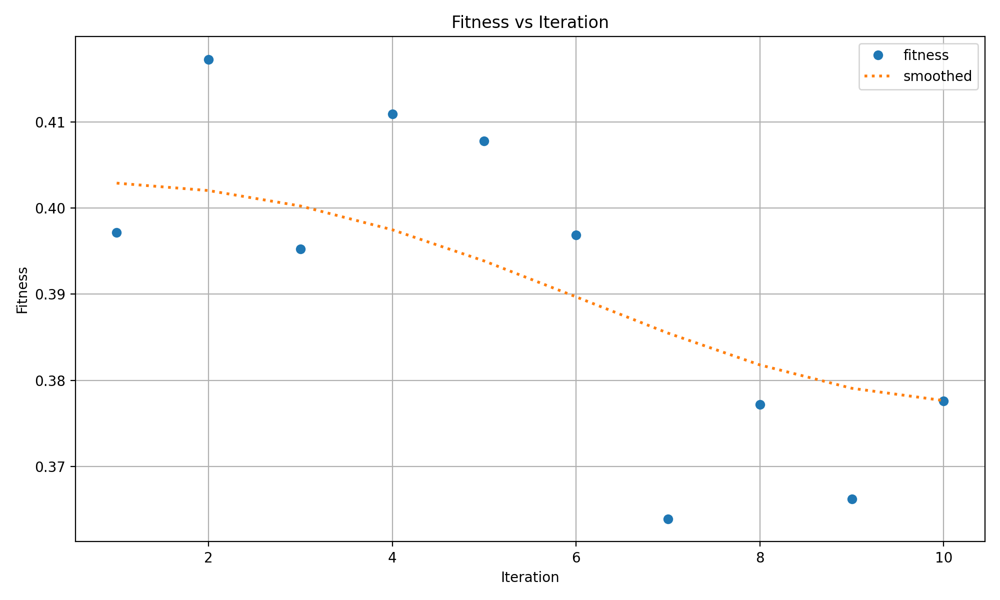

**Figure 3.** Fitness of models undergoing hyperparameter tuning.

In [41]:
# Load images
img1 = Image.open(os.path.join(repo.working_tree_dir, 
                               "runs/detect/tune/tune_fitness.png"))

# Display image
display(img1)

# Add caption
display(Markdown("**Figure 3.** Fitness of models undergoing hyperparameter tuning."))

- Took 47 minutes and 52 seconds

So Hyperparameter Tuning is Expensive! `YOLO's` base genetic algorithm is also inefficient, with no inbuilt early stopping and limited parallelizability. Optimal hyperparameters were identified in the second iteration, suggesting an insufficient search effort for such a large parameter space of 11 parameters. The performance of the best model is evaluated below. 

In [47]:
os.chdir(repo.working_tree_dir + "\Validation")

yolo11bo10 = YOLO(os.path.join(repo.working_tree_dir,"Models/finetune/yolo11besto10.pt")) 
metricsdefault = yolo11bo10.val(data = os.path.join(repo.working_tree_dir,"Data\\Project3---Strawberry-4\\data.yaml"),
                             plots=True)

Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
YOLO11l summary (fused): 190 layers, 25,280,083 parameters, 0 gradients, 86.6 GFLOPs


val: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-4\valid\labels.cache... 14 images, 2 backgrounds, 0 corrupt: 100%|██████████| 14/14 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.31s/it]


                   all         14        113      0.809      0.712      0.733      0.384
Speed: 0.3ms preprocess, 9.7ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs\detect\val3


- This is a different dataset, so metrics are not directly comparable. 
- However, in general P,R,mAP50 and mAP50-95 are all higher. 

At this point, I decided I would try a different approach to tuning by shortening the epochs each model was trained on to 30 and increasing the number of iterations I ran the genetic algorithm to 300. I achieved 274 iterations before I decided to stop prematurely, because at that point tuning had taken some 12 hours and class was about to start. 

In [ ]:
from ultralytics import YOLO
yolo11 = YOLO(os.path.join(repo.working_tree_dir,"Models/pretrain/yolo11l.pt"))
srch_space = {
        "lr0":(1e-5, 1e-1),         # Initial learning rate
        "lrf":(0.01, 1.0),          # Final learning rate factor
        "momentum":(0.6, 0.98),     # Momentum
        "weight_decay":(0.0, 0.001),# Weight decay
        "warmup_epochs":(0.0, 5.0), # Warmup epochs
        "box":(0.02, 0.2),          # Box loss weight
        "cls":(0.2, 4.0),           # Class loss weight
        "hsv_h":(0.0, 0.1),         # Hue augmentation
        "hsv_s":(0.0, 0.1),         # Saturation augmentation (custom)
        "hsv_v":(0.0, 0.1),         # Brightness augmentation (custom)
        "translate":(0.0, 0.9)      # Translation range
    }
model_tune = yolo11.tune(data=os.path.join(repo.working_tree_dir,"Data\\Project3---Strawberry-4\\data.yaml"), 
                            space=srch_space,
                            epochs=30,
                            iterations=300,
                            plots=False,
                            save=False,
                            val=False,
                            batch=32
                            )


In [ ]:
# Train on Best Hyperparameters
os.chdir(repo.working_tree_dir)

from ultralytics import YOLO
v3yolo11 = YOLO(os.path.join(repo.working_tree_dir,"Models/pretrain/yolo11l.pt")) 
v3yolo11.train(data=os.path.join(repo.working_tree_dir,"Data\\Project3---Strawberry-4\\data.yaml"), 
                epochs=100, 
                imgsz=640,
                name="V3bestof274",
                lr0=0.00794,
                lrf=0.01,
                momentum = 0.98,
                weight_decay = 0.00045,
                warmup_epochs = 2.6986,
                optimizer = "AdamW",
                box = 0.2,
                cls = 0.37206,
                hsv_h= 0.01287,
                hsv_s= 0.09813,
                hsv_v= 0.1,
                translate= 0.06559)

New https://pypi.org/project/ultralytics/8.3.114 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
engine\trainer: task=detect, mode=train, model=c:\Users\Public\Documents\Class_Projects\Strobbery\Models/pretrain/yolo11l.pt, data=c:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-4\data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=V3bestof274, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=

train: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-4\train\labels.cache... 147 images, 9 backgrounds, 0 corrupt: 100%|██████████| 147/147 [00:00<?, ?it/s]
val: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-4\valid\labels.cache... 14 images, 2 backgrounds, 0 corrupt: 100%|██████████| 14/14 [00:00<?, ?it/s]


Plotting labels to runs\detect\V3bestof274\labels.jpg... 
optimizer: AdamW(lr=0.00794, momentum=0.98) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.00045), 173 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs\detect\V3bestof274
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      18.6G    0.04807      4.828      1.722         40        640: 100%|██████████| 10/10 [00:02<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.27it/s]

                   all         14        113   0.000956     0.0354     0.0005   0.000236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      18.7G    0.07036      2.363      2.158         40        640: 100%|██████████| 10/10 [00:02<00:00,  4.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.56it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      18.8G    0.06311      1.454      2.103         71        640: 100%|██████████| 10/10 [00:02<00:00,  4.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.55it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      18.9G    0.05962      1.351      2.126         40        640: 100%|██████████| 10/10 [00:02<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.28it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100        19G    0.05404      1.226      1.924         30        640: 100%|██████████| 10/10 [00:02<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 13.36it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      19.1G    0.05892      1.236      2.052         66        640: 100%|██████████| 10/10 [00:02<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.44it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      19.2G    0.05295      1.143      1.851         48        640: 100%|██████████| 10/10 [00:02<00:00,  4.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.29it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      19.2G    0.05158      1.096      1.919         27        640: 100%|██████████| 10/10 [00:02<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.01it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      19.2G    0.05248      1.073       1.91         39        640: 100%|██████████| 10/10 [00:02<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.19it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      19.2G    0.05089      1.046      1.817         57        640: 100%|██████████| 10/10 [00:02<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.08it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      19.2G    0.05172      1.084      1.864         48        640: 100%|██████████| 10/10 [00:02<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.54it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      19.2G    0.05185      1.154      1.922         28        640: 100%|██████████| 10/10 [00:02<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.17it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      19.2G    0.05169      1.094      1.891         52        640: 100%|██████████| 10/10 [00:02<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.15it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      19.3G    0.04779     0.9809      1.794         43        640: 100%|██████████| 10/10 [00:02<00:00,  4.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.60it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      19.3G    0.04673     0.9519      1.747         50        640: 100%|██████████| 10/10 [00:02<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.69it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      19.3G    0.04794     0.9568      1.773         29        640: 100%|██████████| 10/10 [00:02<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.29it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      19.3G    0.04839     0.9461       1.82         38        640: 100%|██████████| 10/10 [00:02<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.45it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      19.3G     0.0479     0.9216      1.792         31        640: 100%|██████████| 10/10 [00:02<00:00,  4.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.13it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      19.3G    0.04662     0.9205      1.738         49        640: 100%|██████████| 10/10 [00:02<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.89it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      19.3G    0.04674     0.9078      1.729         17        640: 100%|██████████| 10/10 [00:02<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.00it/s]

                   all         14        113     0.0339     0.0177      0.019    0.00977



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      19.3G    0.04451     0.8819      1.679         23        640: 100%|██████████| 10/10 [00:02<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.06it/s]

                   all         14        113          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      19.3G    0.04714     0.8878      1.782         19        640: 100%|██████████| 10/10 [00:02<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.49it/s]

                   all         14        113      0.244      0.195      0.114     0.0443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      19.3G    0.04452     0.8478      1.674         52        640: 100%|██████████| 10/10 [00:02<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.40it/s]

                   all         14        113      0.185     0.0619     0.0316     0.0164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      19.3G    0.04512     0.9169      1.752         10        640: 100%|██████████| 10/10 [00:02<00:00,  4.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.02it/s]

                   all         14        113      0.225     0.0619      0.049     0.0234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      19.3G    0.04621     0.8456      1.707         43        640: 100%|██████████| 10/10 [00:02<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.62it/s]

                   all         14        113      0.187      0.142     0.0932     0.0413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      19.3G     0.0472      0.877      1.684         32        640: 100%|██████████| 10/10 [00:02<00:00,  4.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.82it/s]

                   all         14        113      0.499      0.133      0.126     0.0544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      19.3G    0.04499     0.8422      1.672         38        640: 100%|██████████| 10/10 [00:02<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.38it/s]

                   all         14        113      0.396      0.257      0.242      0.109



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      19.4G    0.04261     0.7882      1.616         68        640: 100%|██████████| 10/10 [00:02<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.49it/s]

                   all         14        113      0.194      0.221      0.103     0.0438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      19.4G    0.04431     0.8438      1.689         63        640: 100%|██████████| 10/10 [00:02<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.00it/s]

                   all         14        113      0.245      0.274       0.15     0.0667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      19.4G    0.04173     0.7848       1.59         38        640: 100%|██████████| 10/10 [00:02<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.65it/s]

                   all         14        113      0.425      0.354      0.335      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      19.4G    0.04486      1.225      1.692          7        640: 100%|██████████| 10/10 [00:02<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.77it/s]

                   all         14        113      0.412      0.239      0.241     0.0938



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      19.4G     0.0427     0.8063      1.665         52        640: 100%|██████████| 10/10 [00:02<00:00,  4.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.62it/s]

                   all         14        113      0.332      0.212      0.151     0.0622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      19.4G    0.04543     0.8239      1.704         28        640: 100%|██████████| 10/10 [00:02<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.48it/s]

                   all         14        113      0.271      0.212      0.134     0.0431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      19.4G    0.04706     0.8237      1.707         50        640: 100%|██████████| 10/10 [00:02<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.40it/s]

                   all         14        113      0.427      0.297      0.226      0.082



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      19.4G     0.0425     0.7671      1.617         66        640: 100%|██████████| 10/10 [00:02<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.99it/s]

                   all         14        113      0.434      0.593      0.473      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      19.4G    0.04092     0.7774      1.626         29        640: 100%|██████████| 10/10 [00:02<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.87it/s]

                   all         14        113      0.543      0.478      0.514      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      19.4G    0.04171     0.7583      1.606         29        640: 100%|██████████| 10/10 [00:02<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.25it/s]

                   all         14        113      0.421      0.611      0.515       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      19.4G    0.04393     0.7708      1.637         31        640: 100%|██████████| 10/10 [00:02<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.04it/s]

                   all         14        113      0.557      0.434      0.509      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      19.4G    0.04127     0.7573      1.622         63        640: 100%|██████████| 10/10 [00:02<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.28it/s]

                   all         14        113      0.612      0.504      0.569      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      19.4G    0.04202     0.7466      1.639         37        640: 100%|██████████| 10/10 [00:02<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.09it/s]

                   all         14        113      0.678      0.593      0.622      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      19.4G    0.04152     0.7273      1.612         42        640: 100%|██████████| 10/10 [00:02<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.02it/s]

                   all         14        113      0.659      0.593      0.633      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      19.4G    0.04098     0.7273      1.596         28        640: 100%|██████████| 10/10 [00:02<00:00,  4.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.83it/s]

                   all         14        113      0.578      0.566      0.595      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      19.4G    0.04164     0.7262      1.615         49        640: 100%|██████████| 10/10 [00:02<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.36it/s]

                   all         14        113      0.593       0.58      0.606      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      19.4G    0.04045     0.7186      1.543         30        640: 100%|██████████| 10/10 [00:02<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.09it/s]

                   all         14        113       0.68      0.531      0.618      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      19.4G    0.04114     0.7216      1.552         33        640: 100%|██████████| 10/10 [00:02<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.05it/s]

                   all         14        113      0.643      0.602      0.627      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      19.4G    0.04123     0.7267      1.614         64        640: 100%|██████████| 10/10 [00:02<00:00,  4.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.99it/s]

                   all         14        113      0.692      0.593      0.652      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      19.4G    0.04145      0.746      1.664         25        640: 100%|██████████| 10/10 [00:02<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.11it/s]

                   all         14        113      0.625      0.619      0.637      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      19.4G    0.03937     0.7188      1.553         23        640: 100%|██████████| 10/10 [00:02<00:00,  4.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.04it/s]

                   all         14        113      0.583      0.558      0.599      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      19.5G    0.04173     0.7542      1.632         83        640: 100%|██████████| 10/10 [00:02<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.50it/s]

                   all         14        113      0.648      0.504      0.586      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      19.5G    0.04206     0.7347      1.636         49        640: 100%|██████████| 10/10 [00:02<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.58it/s]

                   all         14        113      0.646      0.628      0.649      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      19.5G    0.04206     0.7114      1.565         69        640: 100%|██████████| 10/10 [00:02<00:00,  4.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.63it/s]

                   all         14        113      0.607      0.611      0.636      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      19.5G    0.04245     0.7196      1.563         40        640: 100%|██████████| 10/10 [00:02<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.60it/s]

                   all         14        113      0.629      0.602      0.641      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      19.5G    0.03969     0.7252      1.547         74        640: 100%|██████████| 10/10 [00:02<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.99it/s]

                   all         14        113      0.578      0.668      0.606      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      19.5G    0.04105     0.7205      1.555         55        640: 100%|██████████| 10/10 [00:02<00:00,  4.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.34it/s]

                   all         14        113      0.625      0.673      0.646      0.319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      19.5G    0.04048     0.6973      1.527         65        640: 100%|██████████| 10/10 [00:02<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.32it/s]

                   all         14        113      0.664      0.648      0.651      0.314



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      19.5G     0.0399      0.685      1.569         30        640: 100%|██████████| 10/10 [00:02<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.80it/s]

                   all         14        113      0.692      0.646      0.679       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      19.5G    0.03961     0.6845      1.554         39        640: 100%|██████████| 10/10 [00:02<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.72it/s]

                   all         14        113      0.704      0.646       0.68      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      19.5G    0.04012     0.6718      1.612         27        640: 100%|██████████| 10/10 [00:02<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.40it/s]

                   all         14        113      0.754      0.628      0.684      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      19.5G    0.03942     0.6682      1.502         29        640: 100%|██████████| 10/10 [00:02<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.76it/s]

                   all         14        113      0.731      0.655      0.662      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      19.5G    0.04042     0.6691       1.56         41        640: 100%|██████████| 10/10 [00:02<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.23it/s]

                   all         14        113      0.693      0.655       0.68      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      19.5G    0.04011     0.6592      1.502         50        640: 100%|██████████| 10/10 [00:02<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.65it/s]

                   all         14        113      0.726      0.637      0.675      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      19.5G    0.04023     0.6614      1.509         30        640: 100%|██████████| 10/10 [00:02<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.23it/s]

                   all         14        113      0.759       0.54      0.624      0.319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      19.5G    0.03835     0.6644      1.556         25        640: 100%|██████████| 10/10 [00:02<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.27it/s]

                   all         14        113      0.765      0.548      0.632      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      19.5G    0.03809     0.6587      1.511         32        640: 100%|██████████| 10/10 [00:02<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.32it/s]

                   all         14        113        0.7      0.639      0.646      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      19.5G    0.04017     0.6641      1.539         39        640: 100%|██████████| 10/10 [00:02<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.46it/s]

                   all         14        113      0.723      0.645      0.663       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      19.5G    0.03815     0.6533      1.511         40        640: 100%|██████████| 10/10 [00:02<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.31it/s]

                   all         14        113      0.659      0.611      0.638      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      19.5G    0.03802     0.6516      1.521         55        640: 100%|██████████| 10/10 [00:02<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.72it/s]

                   all         14        113       0.62      0.628      0.598      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      19.5G    0.03846     0.6397      1.464         54        640: 100%|██████████| 10/10 [00:02<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.52it/s]

                   all         14        113       0.64      0.611       0.61      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      19.5G    0.03914     0.6502      1.503         70        640: 100%|██████████| 10/10 [00:02<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.31it/s]

                   all         14        113      0.666      0.634      0.635      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      19.5G    0.03816     0.6392      1.503         33        640: 100%|██████████| 10/10 [00:02<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.97it/s]

                   all         14        113      0.671      0.655      0.665      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      19.5G    0.03875      0.635      1.497         49        640: 100%|██████████| 10/10 [00:02<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.73it/s]

                   all         14        113      0.676      0.664      0.674      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      19.5G    0.03969     0.6512      1.586         34        640: 100%|██████████| 10/10 [00:02<00:00,  4.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.84it/s]

                   all         14        113      0.723      0.637      0.648      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      19.5G    0.03863     0.6371      1.516         24        640: 100%|██████████| 10/10 [00:02<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.10it/s]

                   all         14        113      0.689      0.646      0.641      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      19.5G      0.037     0.6247      1.525         22        640: 100%|██████████| 10/10 [00:02<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.11it/s]

                   all         14        113      0.689      0.673      0.664      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      19.5G    0.03698     0.6165       1.47         22        640: 100%|██████████| 10/10 [00:02<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.04it/s]

                   all         14        113      0.673      0.664      0.662      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      19.5G    0.03828     0.6305      1.498         60        640: 100%|██████████| 10/10 [00:02<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.67it/s]

                   all         14        113      0.686       0.69      0.684      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      19.5G    0.03612     0.6081      1.428         49        640: 100%|██████████| 10/10 [00:02<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.20it/s]

                   all         14        113       0.65      0.673      0.684      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      19.5G    0.03537     0.5837      1.446         35        640: 100%|██████████| 10/10 [00:02<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.19it/s]

                   all         14        113      0.727      0.637      0.678      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      19.5G    0.03788     0.6121      1.468         71        640: 100%|██████████| 10/10 [00:02<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.53it/s]

                   all         14        113      0.734      0.637      0.675       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      19.5G    0.03639     0.6234       1.52         43        640: 100%|██████████| 10/10 [00:02<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.99it/s]

                   all         14        113      0.745      0.673       0.68      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      19.5G    0.03423     0.5751      1.431         22        640: 100%|██████████| 10/10 [00:02<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.26it/s]

                   all         14        113      0.771      0.664      0.685      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      19.5G    0.03653     0.5831      1.459         60        640: 100%|██████████| 10/10 [00:02<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.03it/s]

                   all         14        113      0.733      0.628      0.683      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      19.5G    0.03525      0.575      1.394         30        640: 100%|██████████| 10/10 [00:02<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.51it/s]

                   all         14        113      0.692      0.635      0.676      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      19.5G    0.03503     0.5583      1.386         55        640: 100%|██████████| 10/10 [00:02<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.52it/s]

                   all         14        113      0.654      0.673       0.68      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      19.5G    0.03547     0.5953      1.457         31        640: 100%|██████████| 10/10 [00:02<00:00,  4.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.14it/s]

                   all         14        113      0.655      0.673      0.665      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      19.5G     0.0357     0.5942      1.447         62        640: 100%|██████████| 10/10 [00:02<00:00,  4.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.75it/s]

                   all         14        113      0.657      0.644      0.676      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      19.5G    0.03779      0.621      1.508         44        640: 100%|██████████| 10/10 [00:02<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.18it/s]

                   all         14        113      0.706      0.595      0.679      0.339



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      19.5G    0.03518     0.5887      1.452         37        640: 100%|██████████| 10/10 [00:02<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.88it/s]

                   all         14        113      0.698      0.611      0.685      0.356



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      19.5G    0.03536     0.5949      1.418         63        640: 100%|██████████| 10/10 [00:02<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.96it/s]

                   all         14        113      0.722      0.646      0.695      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      19.5G    0.03584     0.6071      1.475         31        640: 100%|██████████| 10/10 [00:02<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.33it/s]

                   all         14        113      0.672      0.688      0.693      0.363


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      19.5G    0.03442     0.6012      1.496         45        640: 100%|██████████| 10/10 [00:02<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.47it/s]

                   all         14        113      0.706      0.681      0.697       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      19.5G    0.03605     0.6097       1.56         53        640: 100%|██████████| 10/10 [00:02<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.47it/s]

                   all         14        113      0.678      0.691      0.706      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      19.5G     0.0342     0.5556      1.417         36        640: 100%|██████████| 10/10 [00:02<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.51it/s]

                   all         14        113      0.702       0.69      0.695      0.352



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      19.5G    0.03434     0.5785       1.56         27        640: 100%|██████████| 10/10 [00:02<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.45it/s]

                   all         14        113      0.713      0.681      0.697      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      19.5G    0.03425      0.565      1.458         45        640: 100%|██████████| 10/10 [00:02<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.61it/s]

                   all         14        113       0.76       0.69      0.704      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      19.5G    0.03426     0.5762      1.502         19        640: 100%|██████████| 10/10 [00:02<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.51it/s]

                   all         14        113      0.762      0.678      0.714      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      19.5G    0.03327     0.5506      1.466         35        640: 100%|██████████| 10/10 [00:02<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.27it/s]

                   all         14        113      0.755      0.681      0.714      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      19.5G    0.03415     0.5732      1.521         49        640: 100%|██████████| 10/10 [00:02<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.02it/s]

                   all         14        113      0.766      0.665      0.719       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      19.5G    0.03241      0.539      1.427         25        640: 100%|██████████| 10/10 [00:02<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.42it/s]

                   all         14        113      0.781      0.663      0.714      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      19.5G     0.0334     0.5522      1.427         39        640: 100%|██████████| 10/10 [00:02<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.70it/s]

                   all         14        113      0.783      0.671      0.713      0.365



100 epochs completed in 0.094 hours.
Optimizer stripped from runs\detect\V3bestof274\weights\last.pt, 51.2MB
Optimizer stripped from runs\detect\V3bestof274\weights\best.pt, 51.2MB

Validating runs\detect\V3bestof274\weights\best.pt...
Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
YOLO11l summary (fused): 190 layers, 25,280,083 parameters, 0 gradients, 86.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.40it/s]


                   all         14        113      0.745      0.672      0.714      0.372
Speed: 0.1ms preprocess, 3.8ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs\detect\V3bestof274


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000021C0ECDB790>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0480

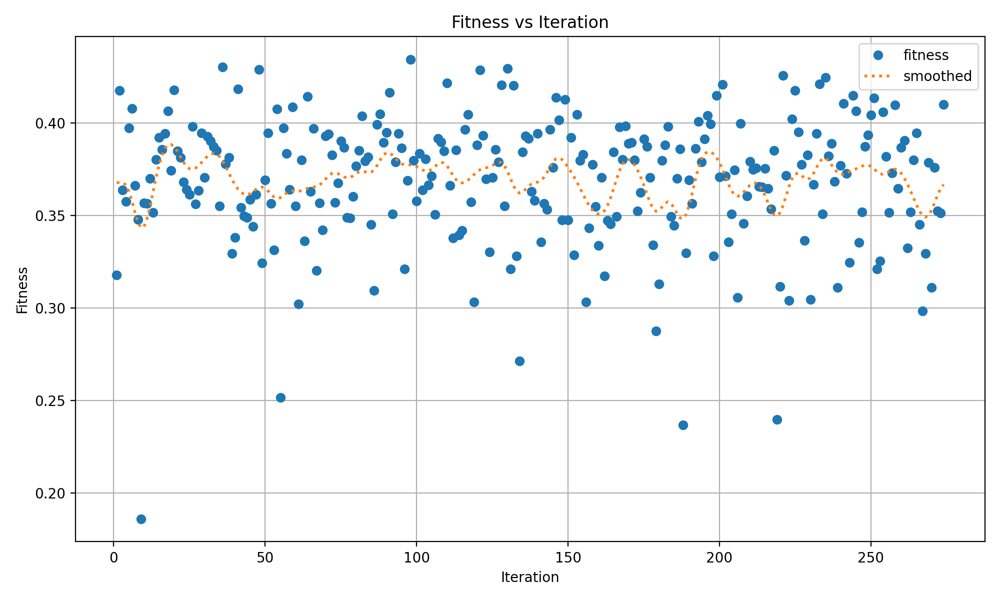

**Figure 4.** Fitness of models undergoing hyperparameter tuning.

In [46]:
# Load images
img1 = Image.open(os.path.join(repo.working_tree_dir, 
                               "runs/detect/tune3/tune_fitness.png"))

# Display image
display(img1)

# Add caption
display(Markdown("**Figure 4.** Fitness of models undergoing hyperparameter tuning."))

In [48]:
os.chdir(repo.working_tree_dir + "\Validation")

yolo11bo274 = YOLO(os.path.join(repo.working_tree_dir,"Models/finetune/yolo11besto274.pt")) 
metricsdefault = yolo11bo274.val(data = os.path.join(repo.working_tree_dir,"Data\\Project3---Strawberry-4\\data.yaml"),
                             plots=True)

Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
YOLO11l summary (fused): 190 layers, 25,280,083 parameters, 0 gradients, 86.6 GFLOPs


val: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Project3---Strawberry-4\valid\labels.cache... 14 images, 2 backgrounds, 0 corrupt: 100%|██████████| 14/14 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.36s/it]


                   all         14        113      0.755      0.681      0.717      0.367
Speed: 0.1ms preprocess, 7.3ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs\detect\val3


- Once again hyperparameter tuning seems random. 
- However, surprisingly the best of 10 model beat the best of 274 model. 
    - Whie this could be random, it also suggests that optimal hyperparameters from tuning a model with fewer epochs does not generalize well to a model trained with more epochs.
- The best iteration was reached at iteration 98. 
- I can only conclude that 
    1) Our search space was too high-dimensional (too many parameters) which made optimization difficult, especially given the time constraints.
    2) The inherent ambiguity in our labels, combined with the sparsity of our data, significantly hindered our ability to identify substantially improved fitness from superior hyperparameter configurations.
- Both reasons are well supported in this project. 

Now let's take a closer look at validation for the best of 10 model (first tuning run result). 

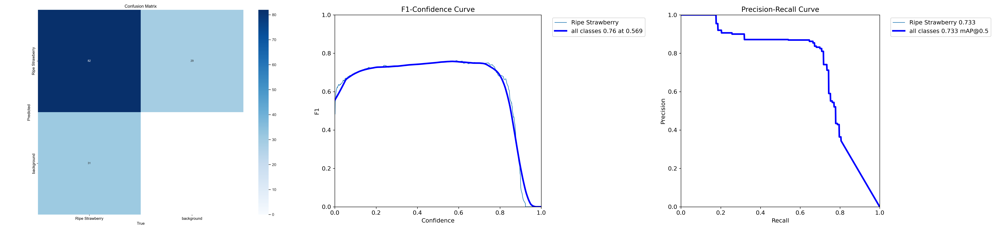

**Figure 5.** The confusion matrix, F1 curve, and PR of the best `YOLO11` model with optimized hyperparameters.

In [50]:
# Load images
img1 = Image.open(os.path.join(repo.working_tree_dir, 
                               "Validation/runs/detect/y11v10s4/confusion_matrix.png"))
img2 = Image.open(os.path.join(repo.working_tree_dir, 
                               "Validation/runs/detect/y11v10s4/F1_curve.png")
)
img3 = Image.open(os.path.join(repo.working_tree_dir, 
                               "Validation/runs/detect/y11v10s4/PR_curve.png")
)
# # Resize (optional)
img1 = img1.resize((2000,1500))
# img2 = img2.resize((300, 300))

# Combine side by side
combined = Image.new("RGB", (img1.width + img2.width + img3.width, max(img1.height, img2.height)))
combined.paste(img1, (0, 0))
combined.paste(img2, (img1.width, 0))
combined.paste(img3, (img1.width + img2.width, 0))

# Display image
display(combined)

# Add caption
display(Markdown("**Figure 5.** The confusion matrix, F1 curve, and PR of the best `YOLO11` model with optimized hyperparameters."))

- In general, this model seems better at maintaining a higher precision as recall increases to around 0.75. This is borne out in the precision not dropping suddenly until around 0.75 recall. 
    - So it seems like adding more null images and tuning hyperparameters was somewhat successful, decreasing the FPs in the confusion matrix by around 10 images while only increasing FNs by 5. 

# Zero Shot YOLOe

- Now we load and test the `YOLOe` model. More information can be found [here](https://docs.ultralytics.com/models/yoloe/#architecture-overview). 

In [124]:
# Load Pretrained YOLO11e
from ultralytics import YOLOE
yolo11edemo1 = YOLOE(os.path.join(repo.working_tree_dir,"Models/pretrain/yoloe-11l-seg.pt")).cuda()
yolo11edemo2 = YOLOE(os.path.join(repo.working_tree_dir,"Models/pretrain/yoloe-11l-seg.pt")).cuda()
yolo11edemo3 = YOLOE(os.path.join(repo.working_tree_dir,"Models/pretrain/yoloe-11l-seg.pt")).cuda()

In [125]:
# Load Custom Labels
os.chdir(repo.working_tree_dir + "\\Models\\pretrain")
cnames1 = ["hat","cat eye","mangosteen"]
cnames2 = ["straw hat","black fruit mangosteen","brown cat eye"]
cnames3 = ["black fruit hat","black fruit","green cat eye"]
# Set custom labels
yolo11edemo1.set_classes(cnames1,yolo11edemo1.get_text_pe(cnames1))
yolo11edemo2.set_classes(cnames2,yolo11edemo2.get_text_pe(cnames2))
yolo11edemo3.set_classes(cnames3,yolo11edemo3.get_text_pe(cnames3))

In [126]:
# Load the Demo Image
pic = Image.open(os.path.join(repo.working_tree_dir,"Data\\mangosteencat.jpeg"))
demo1 = yolo11edemo1.predict(pic,conf=0.1)[0]
demo1 = sv.Detections.from_ultralytics(demo1)

demo2 = yolo11edemo2.predict(pic,conf=0.1)[0]
demo2 = sv.Detections.from_ultralytics(demo2)

demo3 = yolo11edemo3.predict(pic,conf=0.1)[0]
demo3 = sv.Detections.from_ultralytics(demo3)

Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
YOLOe-11l-seg summary (fused): 227 layers, 35,117,862 parameters, 2,254,374 gradients, 144.1 GFLOPs

0: 640x640 2 hats, 15.3ms
Speed: 3.7ms preprocess, 15.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
YOLOe-11l-seg summary (fused): 227 layers, 35,117,862 parameters, 2,254,374 gradients, 144.1 GFLOPs

0: 640x640 1 straw hat, 1 black fruit mangosteen, 2 brown cat eyes, 13.9ms
Speed: 2.2ms preprocess, 13.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
YOLOe-11l-seg summary (fused): 227 layers, 35,117,862 parameters, 2,254,374 gradients, 144.1 GFLOPs

0: 640x640 1 black fruit hat, 3 black fruits, 1 green cat eye, 14.4ms
Speed

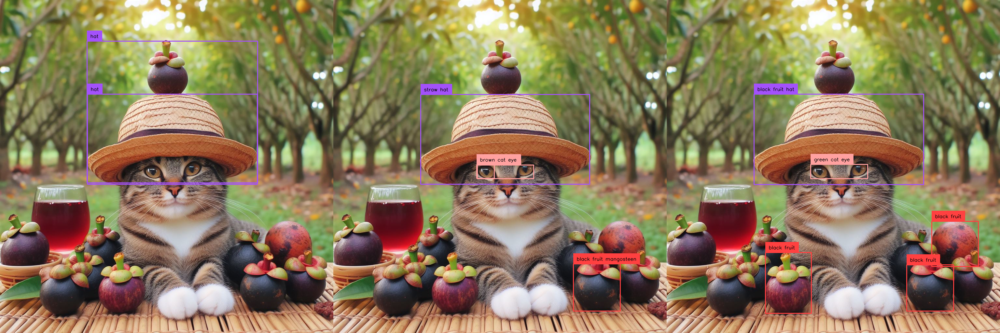

In [75]:
box_annotator = sv.BoxAnnotator()
label_annotator = sv.LabelAnnotator(text_color=sv.Color.BLACK)

# P1
annotated_image = pic.copy()
annotated_image = box_annotator.annotate(annotated_image, detections=demo1)
annotated_image = label_annotator.annotate(annotated_image, detections=demo1)

# P2
annotated_image2 = pic.copy()
annotated_image2 = box_annotator.annotate(annotated_image2, detections=demo2)
annotated_image2 = label_annotator.annotate(annotated_image2, detections=demo2)

# P3
annotated_image3 = pic.copy()
annotated_image3 = box_annotator.annotate(annotated_image3, detections=demo3)
annotated_image3 = label_annotator.annotate(annotated_image3, detections=demo3)

# Combine side by side
combined = Image.new("RGB", (annotated_image.width + annotated_image2.width + annotated_image3.width, annotated_image.height))
combined.paste(annotated_image, (0, 0))
combined.paste(annotated_image2, (annotated_image.width, 0))
combined.paste(annotated_image3, (annotated_image.width + annotated_image2.width, 0))

# Display image
display(combined)

# sv.plot_image(annotated_image, size=(10, 10))

- This demo displays some tests I did of the zero-shot ability of `YOLO11e`. 
- The approach demonstrates the importance of understanding the vocabulary of the `RepRTA` module. 
    - Concepts (like mangosteen) may be completely absent from the vocabulary and hinder identification
    - Other concepts (like cat's eye) may require more descriptive information, though that is not always even correct (for example, adding a description of "green" to cat's eye in the third image results in the cat's eyes being IDed, though the cat's eyes are brown)

Now let's try with strawberries!

In [127]:
# Load Custom Labels
from ultralytics import YOLOE
os.chdir(repo.working_tree_dir + "\\Models\\pretrain")
cnames1 = ["ripe strawberry"]
cnames2 = ["red ripe strawberry"]
# Set custom labels
yolo11edemo1.set_classes(cnames1,yolo11edemo1.get_text_pe(cnames1))
yolo11edemo2.set_classes(cnames2,yolo11edemo2.get_text_pe(cnames2))

In [115]:
# Load the Demo Image
demo1 = yolo11edemo1.predict(pic,conf=0.1)[0]
demo1 = sv.Detections.from_ultralytics(demo1)

demo2 = yolo11edemo2.predict(pic,conf=0.1)[0]
demo2 = sv.Detections.from_ultralytics(demo2)

Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)

0: 640x640 5 ripe strawberrys, 13.6ms
Speed: 1.9ms preprocess, 13.6ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)
Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)

0: 640x640 8 red ripe strawberrys, 14.0ms
Speed: 1.5ms preprocess, 14.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


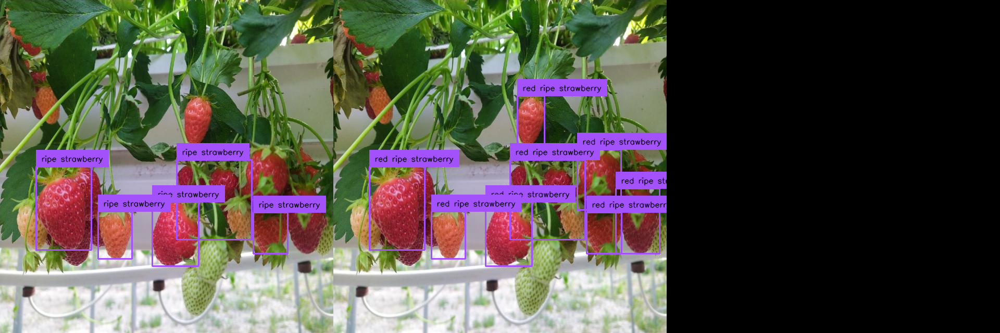

In [116]:
box_annotator = sv.BoxAnnotator()
label_annotator = sv.LabelAnnotator(text_color=sv.Color.BLACK)

# P1
annotated_image = pic.copy()
annotated_image = box_annotator.annotate(annotated_image, detections=demo1)
annotated_image = label_annotator.annotate(annotated_image, detections=demo1)

# P2
annotated_image2 = pic.copy()
annotated_image2 = box_annotator.annotate(annotated_image2, detections=demo2)
annotated_image2 = label_annotator.annotate(annotated_image2, detections=demo2)

# Combine side by side
combined = Image.new("RGB", (annotated_image.width + annotated_image2.width + annotated_image3.width, annotated_image.height))
combined.paste(annotated_image, (0, 0))
combined.paste(annotated_image2, (annotated_image.width, 0))

# Display image
display(combined)

# sv.plot_image(annotated_image, size=(10, 10))

- As you can see, it seems like adding the descriptor "red" increases recall significantly. 

Now let's validate!

In [ ]:
# Load Pretrained YOLO11
yolo11e = YOLOE(os.path.join(repo.working_tree_dir,"Models/pretrain/yoloe-11l-seg.pt")).cuda()

In [144]:
os.chdir(repo.working_tree_dir + "\\Models\\pretrain")
yolo11edet = YOLOE("yoloe-11l.yaml")
state = torch.load(os.path.join(repo.working_tree_dir,"Models/pretrain/yoloe-11l-seg.pt"))
yolo11edet.load(state["model"])

Transferred 1108/1108 items from pretrained weights


YOLOE(
  (model): YOLOEModel(
    (model): Sequential(
      (0): Conv(
        (conv): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(64, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (1): Conv(
        (conv): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(128, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (2): C3k2(
        (cv1): Conv(
          (conv): Conv2d(128, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(128, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
          (act): SiLU(inplace=True)
        )
        (cv2): Conv(
          (conv): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(256, eps=0.001, momentum=0.03, affine=True, track_run

In [146]:
os.chdir(repo.working_tree_dir + "\Validation")
metrics3 = yolo11edet.val(data = os.path.join(repo.working_tree_dir,"Data\\Strawberrybasevalnored\\data.yaml"),
                       load_vp=True,
                       conf =0.5,
                       plots=True)

Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
Validate using the visual prompt.


val: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Strawberrybasevalnored\valid\labels.cache... 14 images, 2 backgrounds, 0 corrupt: 100%|██████████| 14/14 [00:00<?, ?it/s]
Get visual prompt embeddings from samples: 100%|██████████| 1/1 [00:00<00:00,  6.06it/s]


Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
YOLOe-11l summary (fused): 215 layers, 32,812,582 parameters, 2,492,550 gradients, 88.8 GFLOPs


val: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Strawberrybasevalnored\valid\labels.cache... 14 images, 2 backgrounds, 0 corrupt: 100%|██████████| 14/14 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.17s/it]


                   all         14        113      0.635      0.699      0.691       0.45
Speed: 0.7ms preprocess, 8.9ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs\detect\val4


In [176]:
metrics3 = yolo11edet.val(data = os.path.join(repo.working_tree_dir,"Data\\Strawberrybaseval\\data.yaml"),
                       load_vp=True,
                       conf =0.5,
                       plots=True)

Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
Validate using the visual prompt.


val: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Strawberrybaseval\valid\labels.cache... 14 images, 2 backgrounds, 0 corrupt: 100%|██████████| 14/14 [00:00<?, ?it/s]
Get visual prompt embeddings from samples: 100%|██████████| 1/1 [00:00<00:00,  7.59it/s]


Ultralytics 8.3.105  Python-3.11.11 torch-2.8.0.dev20250407+cu128 CUDA:0 (NVIDIA GeForce RTX 3090, 24576MiB)
YOLOe-11l summary (fused): 215 layers, 32,812,582 parameters, 2,492,550 gradients, 88.8 GFLOPs


val: Scanning C:\Users\Public\Documents\Class_Projects\Strobbery\Data\Strawberrybaseval\valid\labels.cache... 14 images, 2 backgrounds, 0 corrupt: 100%|██████████| 14/14 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.16s/it]


                   all         14        113      0.635      0.699      0.691       0.45
Speed: 0.1ms preprocess, 6.6ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to runs\detect\val4


- Surprisingly, it turns out the metrics for "ripe strawberry" and "red ripe strawberry" are the exact same!
- Otherwise, metrics across the board are lower than those of the fine-tuned model, but the mAP50-95 is highest out of all models significantly. 
    - This indicates that while the model is less able to detect strawberries accurately at the 50 level, the boxes it detects fit close to the ground truth, resulting in higher scores at higher thresholds.  

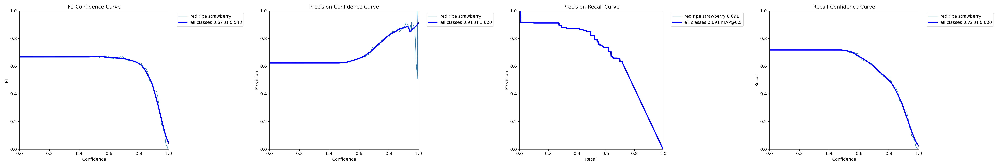

**Figure 5.** The F1 curve, P,R and PR curves of the YOLOE Model.

In [ ]:
# Load images
img1 = Image.open(os.path.join(repo.working_tree_dir, 
                               "Validation/runs/detect/valredstraw/F1_curve.png"))
img2 = Image.open(os.path.join(repo.working_tree_dir, 
                               "Validation/runs/detect/valredstraw/P_curve.png")
)
img3 = Image.open(os.path.join(repo.working_tree_dir, 
                               "Validation/runs/detect/valredstraw/PR_curve.png")
)
img4 = Image.open(os.path.join(repo.working_tree_dir, 
                               "Validation/runs/detect/valredstraw/R_curve.png")

)

# Combine side by side
combined = Image.new("RGB", (img1.width + img2.width + img3.width + img4.width, max(img1.height, img2.height)))
combined.paste(img1, (0, 0))
combined.paste(img2, (img1.width, 0))
combined.paste(img3, (img1.width + img2.width, 0))
combined.paste(img4, (img1.width + img2.width + img3.width, 0))

# Display image
display(combined)

# Add caption
display(Markdown("**Figure 6.** The F1 curve, P,R and PR curves of the YOLOE Model."))

- An interesting difference between the curves of this model and the others is the general consistency of the P,R, and PR curves. 
- There is a lot less stair stepping. perhaps indicating a worse fit than with fine-tuned models. 
- Recall is significantly worse than precision it seems for this model. 

# Zero Shot With QWEN2.5 VL 3b

Now I wanted to try VLM, specifically `QWEN2.5 VL`. My GPU could only fit the 3B parameter version but that is overkill for bounding boxes. 

In [ ]:
# Run with Maestro
os.chdir(repo.working_tree_dir)
from maestro.trainer.models.qwen_2_5_vl.checkpoints import load_model, OptimizationStrategy

MODEL_ID_OR_PATH = "Qwen/Qwen2.5-VL-3B-Instruct"
MIN_PIXELS = 512 * 28 * 28
MAX_PIXELS = 2048 * 28 * 28

processor, model = load_model(
    model_id_or_path=MODEL_ID_OR_PATH,
    optimization_strategy=OptimizationStrategy,
    min_pixels=MIN_PIXELS,
    max_pixels=MAX_PIXELS
)

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

In [ ]:
# Create the Base Function for Running Inference
from typing import Optional, Tuple, Union

from maestro.trainer.models.qwen_2_5_vl.inference import predict_with_inputs
from maestro.trainer.models.qwen_2_5_vl.loaders import format_conversation
from maestro.trainer.common.utils.device import parse_device_spec
from qwen_vl_utils import process_vision_info

def run_qwen_2_5_vl_inference(
    model,
    processor,
    image: Image.Image,
    prompt: str,
    system_message: Optional[str] = None,
    device: str = "auto",
    max_new_tokens: int = 1024,
) -> Tuple[str, Tuple[int, int]]:
    
    device = parse_device_spec(device)
    conversation = format_conversation(image=image, prefix=prompt, system_message=system_message)
    text = processor.apply_chat_template(conversation, tokenize=False, add_generation_prompt=True)
    image_inputs, _ = process_vision_info(conversation)

    inputs = processor(
        text=text,
        images=image_inputs,
        return_tensors="pt",
    )

    input_h = inputs['image_grid_thw'][0][1] * 14
    input_w = inputs['image_grid_thw'][0][2] * 14

    response = predict_with_inputs(
        **inputs,
        model=model,
        processor=processor,
        device=device,
        max_new_tokens=max_new_tokens
    )[0]

    return response, (input_w, input_h)

In [ ]:
# Run Example
IMAGE_PATH = os.path.join(repo.working_tree_dir,"Data\\mangosteencat.jpeg")
SYSTEM_MESSAGE = None
PROMPT = "Describe the image in detail. Include the number of objects, " \
"their colors, and any other relevant information. Do this in English and then in Chinese."

image = Image.open(IMAGE_PATH)
resolution_wh = image.size
response, input_wh = run_qwen_2_5_vl_inference(
    model=model,
    processor=processor,
    image=image,
    prompt=PROMPT,
    system_message=SYSTEM_MESSAGE
)

print(response)

The image features a cat wearing a straw hat adorned with a mangosteen fruit on top. The cat is sitting on a woven mat surrounded by various mangosteens arranged in a circular pattern. In the background, there is a glass of red liquid, likely mangosteen juice, placed on a woven basket. The setting appears to be an orchard with trees in the distance, bathed in sunlight filtering through the leaves.

### English Description:
- **Cat**: Wearing a straw hat with a mangosteen fruit on top.
- **Mangosteens**: Arranged in a circular pattern around the cat.
- **Glass of Red Liquid**: Positioned on a woven basket.
- **Background**: An orchard with trees, sunlight filtering through the leaves.

### Chinese Description:
- **猫（cat）**: 戴着一顶草帽，草帽上有一个木瓜。
- **木瓜（mangosteen）**: 周围摆放成一个圆形图案。
- **玻璃杯中的红色液体（glass of red liquid）**: 放在编织篮子里。
- **背景**：一个果园，树木在远处，阳光透过树叶洒下。


- As expected of a language model, it is a lot more versatile than the CNN based models, able to generate text. 
- It's vocabulary is also better than `YOLOE's` in English? Calls a mangosteen a papaya. 

In [7]:
IMAGE_PATH = os.path.join(repo.working_tree_dir,"Data\\mangosteencat.jpeg")
SYSTEM_MESSAGE = None
PROMPT = "Outline the position of each of the cat's eyes, its hat, and all individual mangosteens and output all the coordinates in JSON format. "

image = Image.open(IMAGE_PATH)
resolution_wh = image.size
response, input_wh = run_qwen_2_5_vl_inference(
    model=model,
    processor=processor,
    image=image,
    prompt=PROMPT,
    system_message=SYSTEM_MESSAGE
)

print(response)

```json
[
	{"bbox_2d": [450, 518, 503, 556], "label": "cat's eyes"},
	{"bbox_2d": [570, 509, 622, 550], "label": "cat's eyes"},
	{"bbox_2d": [267, 291, 802, 578], "label": "hat"},
	{"bbox_2d": [0, 665, 1016, 997], "label": "mangosteens"}
]
```


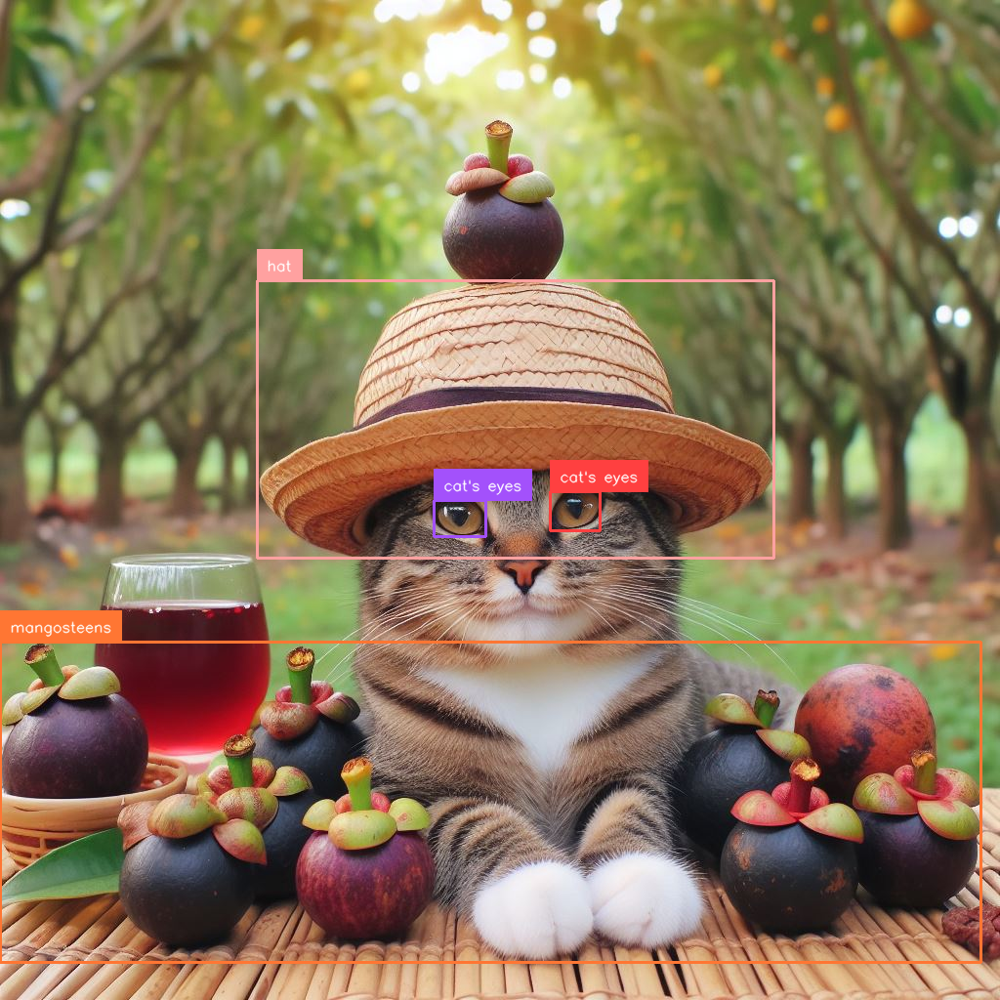

In [9]:
import supervision as sv
detections = sv.Detections.from_vlm(
    vlm=sv.VLM.QWEN_2_5_VL,
    result=response,
    input_wh=input_wh,
    resolution_wh=resolution_wh
)

box_annotator = sv.BoxAnnotator(color_lookup=sv.ColorLookup.INDEX)
label_annotator = sv.LabelAnnotator(color_lookup=sv.ColorLookup.INDEX)

annotated_image = image.copy()
annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)
annotated_image = label_annotator.annotate(scene=annotated_image, detections=detections)
annotated_image

- Took 5 seconds.
- `QWEN2.5 VL` is also fine-tuned on bounding box generation, so it outputs bounding boxes easily. 
- Just from a visual inspection, precision seems great! 
- All models seem to miss the mangosteen on top of the cat's head, though this model noticed it in the text description. 
- Try with Strawberries!

In [115]:
IMAGE_PATH = os.path.join(repo.working_tree_dir,"Data\\Strawberrybaseval\\valid\images\\6_crop1_png.rf.9c9cee8dd7e22d359733f58642df7bf2.jpg")
SYSTEM_MESSAGE = "You are an expert strawberry picker. Every day you walk in fields of strawberries brushing past the leaves to pick them as they are just ripe and deep red. You are paid 10,000 dollars for every ripe strawberry you pick at perfect ripeness. You love finding hidden red strawberries among green leaves"

PROMPT = "Outline the position of each red ripe strawberry and output all the coordinates in JSON format. " \
"Include blurry red strawberries in the background or partially covered by leaves but not half ripe berries that are still partially green. DETECT ALL RED STRAWBERRY AREAS."

image = Image.open(IMAGE_PATH)
resolution_wh = image.size
response, input_wh = run_qwen_2_5_vl_inference(
    model=model,
    processor=processor,
    image=image,
    prompt=PROMPT,
    system_message=SYSTEM_MESSAGE
)

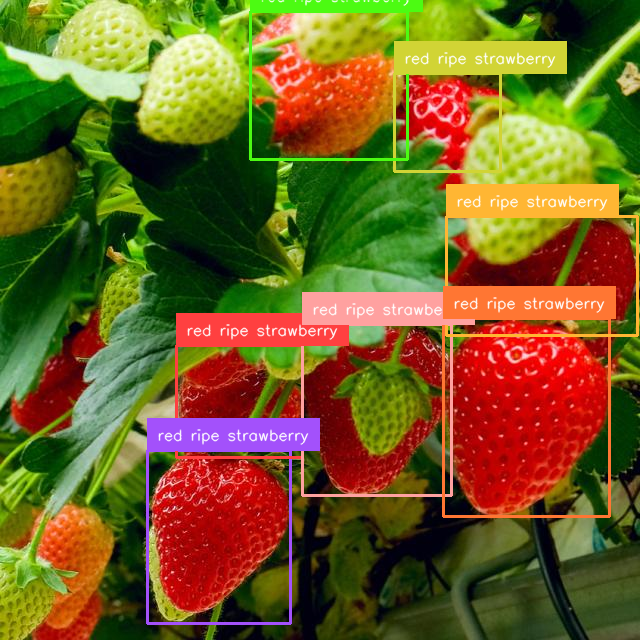

In [116]:
import supervision as sv
detections = sv.Detections.from_vlm(
    vlm=sv.VLM.QWEN_2_5_VL,
    result=response,
    input_wh=input_wh,
    resolution_wh=resolution_wh
)

box_annotator = sv.BoxAnnotator(color_lookup=sv.ColorLookup.INDEX)
label_annotator = sv.LabelAnnotator(color_lookup=sv.ColorLookup.INDEX)

annotated_image = image.copy()
annotated_image = box_annotator.annotate(scene=annotated_image, detections=detections)
annotated_image = label_annotator.annotate(scene=annotated_image, detections=detections)
annotated_image

Now let's Validate!

In [153]:
# Read YOLO Validation Dataset into Supervision Form
ground_truth_det = sv.DetectionDataset.from_yolo(
     images_directory_path=f"{repo.working_tree_dir}/Data/Strawberrybaseval/valid/images",
     annotations_directory_path=f"{repo.working_tree_dir}/Data/Strawberrybaseval/valid/labels",
     data_yaml_path=f"{repo.working_tree_dir}/Data/Strawberrybaseval/data.yaml"
)

In [ ]:
# Wrapper Functions to Enable Image Validation
# Convert Image to PIL Image
def convertimage(image)->Image.Image:
    """
    Convert a PIL image to a format suitable for the model.
    """
    if isinstance(image, np.ndarray):
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        return Image.fromarray(image)
    else:
        return image

In [ ]:
# Wrapper Functions to Enable Image Validation
def strawberry_detect(image):
    image = convertimage(image)
    # Resize image
    resolution_wh = image.size
    # Run VLLM
    response, input_wh = run_qwen_2_5_vl_inference(
    model=model,
    processor=processor,
    image=image,
    prompt=PROMPT,
    system_message=SYSTEM_MESSAGE
    )
    # Create Detrections object
    detections = sv.Detections.from_vlm(
        vlm=sv.VLM.QWEN_2_5_VL,
        result=response,
        input_wh=input_wh,
        resolution_wh=resolution_wh
    )
    detections.class_id = np.array([0]*len(detections.xyxy))
    detections.confidence = np.array([1]*len(detections.xyxy))
    return detections

In [148]:
# Set Prompts
IMAGE_PATH = os.path.join(repo.working_tree_dir,"Data\\Strawberrybaseval\\valid\images\\28_crop1_png.rf.f56aea5e8772091fab239515e0b1f808.jpg")
SYSTEM_MESSAGE = "You are an expert strawberry picker. Every day you walk in fields of strawberries brushing past the leaves to pick them as they are just ripe and deep red. You are paid 10,000 dollars for every ripe strawberry you pick at perfect ripeness. You love finding hidden red strawberries among green leaves"

PROMPT = "Outline the position of each red ripe strawberry and output all the coordinates in JSON format. " \
"Include blurry red strawberries in the background or partially covered by leaves but not half ripe berries that are still partially green. DETECT ALL RED STRAWBERRY AREAS."

In [154]:
# Get Confusion Matrix
cm = sv.ConfusionMatrix.benchmark(ground_truth_det,
                                  strawberry_detect,
                                  iou_threshold=0.5,
                                  conf_threshold=0.5)

**Figure 6.** Confusion Matrix of QWen 2.5 VL Model

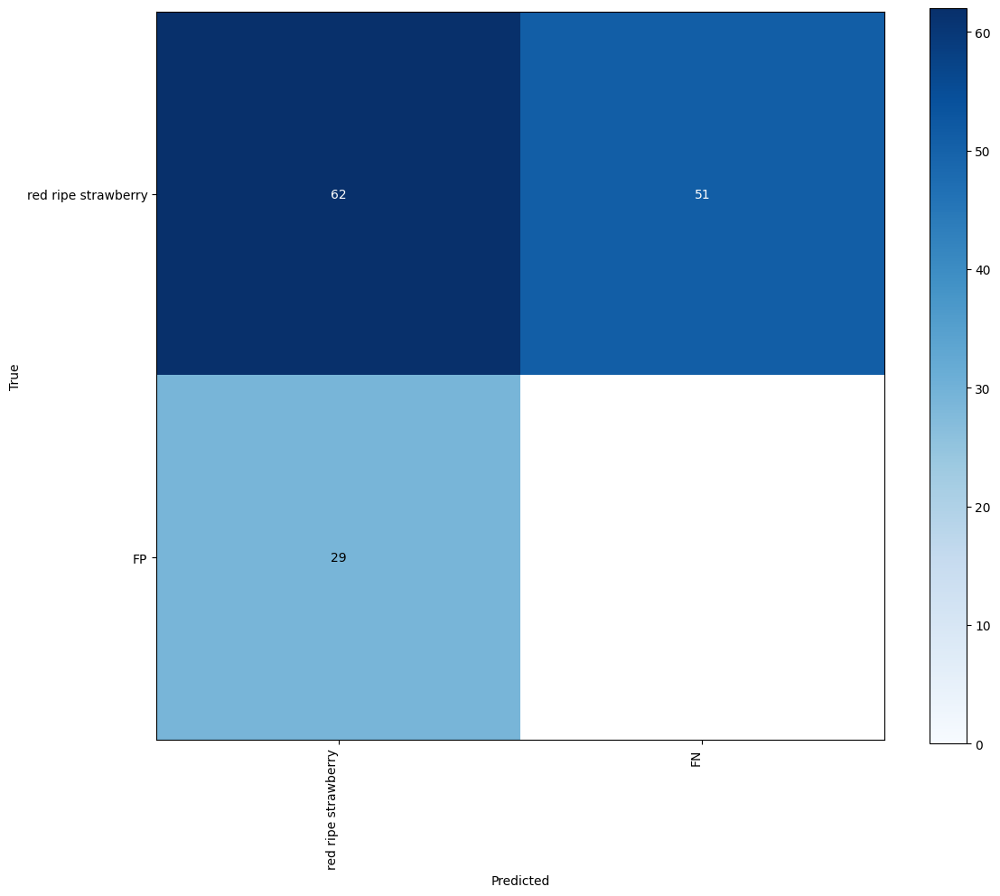

In [ ]:
plot = cm.plot()
# Add caption
display(Markdown("**Figure 7.** Confusion Matrix of QWen 2.5 VL Model"))

In [156]:
map = sv.MeanAveragePrecision.benchmark(
    dataset = ground_truth_det,
    callback = strawberry_detect
)

In [157]:
print(map.map50)
print(map.map50_95)

0.5419218199474471
0.3038236218116333


- Contrary to the demonstration appearances, the Image Detection Ability of `QWen 2.5-VL` is quite bad. 
- Out of all the models the worst mAP50 and mAP50_95 results and it's not even close. 
- The model's recall is better than its precision for sure. 
    - However, this is largely prompt dependent as well. 

# Discussion

## Preprocessing

A fundamental limit of this exploration was the lack and inconsistency of labeled data. As demonstrated multiple times, the number of training examples scales directly with model performance $^{16,17}$. Thus the performance of our fine-tuned models was inferior to results reported on similar studies’ models trained on larger datasets $^{5,6}$.

![**Figure 8:** An example of an edge positive (A) or blurry background ripe strawberry and an edge negative (B) or an almost ripe strawberry](edge%20cases.png)

**Figure 8:** An example of an edge positive (A) or blurry background ripe strawberry and an edge negative (B) or an almost ripe strawberry

An additional impediment to model performance was due to inconsistencies in data labeling, especially the lack of a unified policy among labelers for edge cases. Specifically, there was inconsistency in classifying partially obscured or almost ripe strawberries as either ripe or not. This inconsistency disproportionately affected recall performance, likely due to the higher prevalence of covered or background strawberries in the validation dataset compared to nearly ripe strawberries. To address this in future work, establishing and enforcing rigorous labeling protocols with clear guidelines for handling edge cases will be paramount, though not sufficient, if training data size remains small. 

While utilizing zero shot learning with open vocabulary was evaluated, such approaches were not panaceas in this experiment. While some models like `YOLOE` displayed impressive abilities out of the box comparable to fine-tuned models, their precision and accuracy did not exceed the performance of fine-tuned models. Zero shot modeled had similar issues when classifying edge cases, which suggests misclassification error in such cases is caused by the inherent difficulty of classification than by confusing labeled data. 

Beyond improved coordination, strategies to expand the labeled dataset efficiently could be explored. Semi-supervised learning techniques using current models or models trained on more consistently labeled data as teachers, could work. Furthermore, synthetic data generation may be explored using image generation models like GAN or diffusion.

## Model Choice

| Model             | Precision | Recall | mAP50 | mAP50-95 |
|-------------------|-----------|--------|-------|----------|
| Yolo11 Default    | 0.715     | **0.735**  | 0.718 | 0.335    |
| Yolo11 More Epochs | 0.754     | 0.673  | 0.705 | 0.345    |
| Yolo11 Best of 10 | **0.809**     | 0.712  | **0.733** | 0.384    |
| Yolo11 Best of 274| 0.755     | 0.681  | 0.717 | 0.367    |
| YoloE             | 0.635     | 0.699  | 0.691 | **0.45**     |
| Qwen 2.5 VL       | 0.663     | 0.54   | 0.452 | 0.284    |

**Table 2:** Overall Metric comparisons for the six models produced. Bolded represent the best metric in each category. note that the first two YOLO11 models were trained on a slightly different dataset than the other 4. 

Our results strongly support the conclusion that fine tuned modeled outperformed zero-shot models in most cases. While zero-shot performance with `YOLOE` achieved decent results, particularly with mAP at the 50-95 threshold, it consistently fell below even models fined-tuned with default parameters. With small model architectures like `YOLO` the cost of fine tuning is also small, with the most significant bottleneck being labeling and not compute. 

Our results suggest that object detection is likely not the optimal use case for Vision Language Models (VLMs) such as `Qwen 2.5 VL`. While demonstrating a relatively high level of contextual understanding when asked to provide textual descriptions of images, `Qwen` exhibited significantly lower  object detection performance compared to Convolutional Neural Network (CNN)-based models like `YOLO`, even zero-shot models such as `YOLOe`. Furthermore, `Qwen` proved reluctant to generate bounding boxes, and those it did create were often inaccurate. `Qwen` would likely perform better in conversational contexts with more continuous human feedback, where greater flexibility is desired than in simple object detection.

Hyperparameter tuning, utilizing the standard `YOLO` tuning function and a genetic algorithm, yielded mixed results. While tuned hyperparameters generally led to improved performance, the highest recall was observed in the default model. Moreover, fitness remained essentially flat across both rounds of hyperparameter tuning, suggesting the algorithm was unable to orient itself within the search space to identify superior models. Notably, tuning with fewer epochs did not prove beneficial, as the model trained on hyperparameters found from a search of 10 iterations of 100 epochs outperformed the model trained on hyperparameters from a search of 274 iterations of 30 epochs. Reducing the number of augmentations appeared to improve model performance, though that might lead to overfitting.

An analogy can be drawn between hyperparameter optimization in fine-tuning and prompt selection in zero-shot analysis. Both `YOLOe` and `Qwen` require a specific prompt to guide their operation, and observing bounding boxes from different prompts demonstrated prompt variations can influence model outcomes. While this did not appear to significantly affect `YOLOE` when it was evaluated, it demonstrably impacted `Qwen`. Therefore, even though not technically a hyperparameter, prompt engineering would be a crucial component of any deployment workflow for zero-shot models.

Of all potential architectural or model improvements, `YOLOE` demonstrates the most promise for further study. Given its relatively small size, fine-tuning would be computationally feasible, and potential studies could compare model performance after tuning the entire model versus tuning only the SAVPE or RepRTA submodules. Indeed, the `YOLO` documentation specifically mentions tuning only these modules as a strategy for overcoming limited labeled training data.

## Domain Adaptation

Validating the `YOLO` models on the dataset they were not trained on demonstrates the value of including more null images. As seen in tables 3 and 4, YOLO models trained on the original dataset performed worse when evaluated on the dataset with null images than vice versa. This indicates that incorporating a small amount of null images improves model generalizability.


| Model            | Precision | Recall | mAP50 | mAP50-95 |
|-------------------|-----------|--------|-------|----------|
| Yolo11 Default   | 0.709    | 0.735  | 0.714 | 0.333   |
| Yolo11 More Epochs | 0.747    | 0.673  | 0.696 | 0.338   |

**Table 3:** Metrics for models trained on Version 1 of the Training Dataset (Without Null Images) on Version 4 of the Training Dataset

| Model            | Precision | Recall | mAP50 | mAP50-95 |
|-------------------|-----------|--------|-------|----------|
| Yolo11 Best of 10 | 0.809    | 0.712  | 0.734 | 0.385   |
| Yolo11 Best of 274| 0.762    | 0.681  | 0.719 | 0.368   |

**Table 4:** Metrics for models trained on Version 4 of the Training Dataset (Without Null Images) on Version 1 of the Training Dataset. 

| Model        | Precision | Recall | mAP50 | mAP50-95 |
|--------------|-----------|--------|-------|---------|
| YOLOe        | 0.651     | 0.699  | 0.695 | 0.453   |
| Qwen 2.5 VL | 0.71      | 0.5    | 0.565 | 0.327   |

**Table 5:** Metrics for zero-shot models trained on Version 1 of the Training Dataset. 

Furthermore, it is clear that Version 1 of the dataset represented an easier task, as evidenced by the improved performance of the zero-shot models on Dataset 1 compared to their results on Dataset 4. Still, this suggests that training on harder, more varied datasets generally improves performance on easier datasets, a finding well-supported in the existing literature.

In conclusion, this research reinforces the value of traditional supervised learning with high-quality, representative data. While advancements in zero-shot learning are promising, in this experiment they fell short of the performance achievable through fine-tuning SOTA object detection models like `YOLO11`. Future work could explore fine tuning `YOLOE`, semi-supervised learning, and synthetic data to unlock further increase accuracy in deep learning for automated strawberry phenotyping.

# Citations

1.	Computer Vision and Machine Learning in Agriculture. (Springer Singapore, Singapore, 2021). doi:10.1007/978-981-33-6424-0.
2.	What is Computer Vision? | IBM. https://www.ibm.com/think/topics/computer-vision.
3.	Phenomics: How Next-Generation Phenotyping Is Revolutionizing Plant Breeding. (Springer International Publishing, Cham, 2015). doi:10.1007/978-3-319-13677-6.
4.	Wang, X. Phenomics for Strawberry Breeding. (2025).
5.	Wang, Y. et al. DSE-YOLO: Detail semantics enhancement YOLO for multi-stage strawberry detection. Computers and Electronics in Agriculture 198, 107057 (2022).
6.	Wang, C. et al. Strawberry Detection and Ripeness Classification Using YOLOv8+ Model and Image Processing Method. Agriculture 14, 751 (2024).
7.	onnx/models. Open Neural Network Exchange (2025).
8.	Ultralytics. Home. https://docs.ultralytics.com/.
9.	Bai, J. et al. Qwen-VL: A Versatile Vision-Language Model for Understanding, Localization, Text Reading, and Beyond. Preprint at https://doi.org/10.48550/arXiv.2308.12966 (2023).
10.	Ultralytics. YOLOE (Real-Time Seeing Anything). https://docs.ultralytics.com/models/yoloe.
11.	Ultralytics. YOLO11 🚀 NEW. https://docs.ultralytics.com/models/yolo11.
12.	Ultralytics. Train. https://docs.ultralytics.com/modes/train.
13.	Khanam, R. & Hussain, M. YOLOv11: An Overview of the Key Architectural Enhancements. Preprint at https://doi.org/10.48550/arXiv.2410.17725 (2024).
14.	Wang, A. et al. YOLOE: Real-Time Seeing Anything. Preprint at https://doi.org/10.48550/arXiv.2503.07465 (2025).
15.	Qwen/Qwen-VL · Hugging Face. https://huggingface.co/Qwen/Qwen-VL.
16.	Alabdulmohsin, I. & Neyshabur, B. Revisiting Neural Scaling Laws in Language and Vision.
17.	Prato, G., Guiroy, S., Caballero, E., Rish, I. & Chandar, S. Scaling Laws for the Few-Shot Adaptation of Pre-trained Image Classifiers. Preprint